In [1]:
#%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import os
import glob
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from torch.autograd import Variable

import torchvision

#from torch.utils.tensorboard import SummaryWriter

import sklearn
import functools
import operator

import sys

sys.path.insert(1,"/home/sbulusu/qcd_ml/neural_networks/libs/")

import dataset_class_gsimage
#import gan_torch_net_class

import d_gan_torch_net_class
import g_gan_torch_net_class
import utils

from tqdm.notebook import tqdm

In [2]:
if torch.cuda.is_available():
    device = torch.device("cuda:0")
    print("Utilizing CUDA")
else:
    device = torch.device("cpu")
    print("Utilizing CPU")
    
cpu_device =  torch.device("cpu")

Utilizing CUDA


In [3]:
"""we will be using our custom dataset and functions!"""

#mnist_image_folder = "../data/mnist/"
#folder of the dataset
mnist_image_folder = "/media/data/sbulusu/datasets/mnist/mnist_images/"
mnist_image_names = os.listdir(mnist_image_folder)
#relative paths of all images to mnist_image_folder
mnist_image_paths = glob.glob("mnist/*")
image_size = [1,28,28]
#label_path_csv = "../data/mnist_labels.csv"
label_path_csv = "/media/data/sbulusu/datasets/mnist/mnist_labels.csv"
dataset = dataset_class_gsimage.image_dataset(mnist_image_folder, mnist_image_paths, image_size, label_path_csv, transform="default", device=device)
#dataset = dataset_class_gsimage.image_dataset(mnist_image_folder, mnist_image_paths, image_size, label_path_csv, transform=None, device=device)
#name of the attribute in the csv file
target_attributes = ["number"]
dataset.set_label_names(target_attributes)

['number']

In [4]:

dataset.transform = torchvision.transforms.Compose([
                dataset_class_gsimage.send_to_device(target_device=cpu_device),
                #dataset_class_gsimage.numpy(typ=np.uint8),
                dataset_class_gsimage.torch_tensor(typ=torch.uint8),
                #dataset_class_gsimage.roll_channel_axis(old_pos=0, new_pos=-1, device=torch.device("cpu")),
                torchvision.transforms.ToPILImage(mode=None),
                torchvision.transforms.RandomResizedCrop(size=(28,28),scale=(0.8, 1.0), ratio=(0.75, 1.33333), interpolation=2),
                torchvision.transforms.RandomRotation((-30,+30), resample=False, expand=False, center=None),
                torchvision.transforms.ToTensor(),
                dataset_class_gsimage.send_to_device(target_device=device),
                dataset_class_gsimage.min_max_scaler(device=device),
                torchvision.transforms.Normalize(mean=[0.5], std=[0.5]),
                torchvision.transforms.RandomApply([dataset_class_gsimage.add_normal_noise(0.,0.1,device=device)], p=0.5),
                torchvision.transforms.RandomErasing(p=0.5, scale=(0.01, 0.05), ratio=(0.3, 3.3), value=0, inplace=False)
            ])
"""
dataset.transform = torchvision.transforms.Compose([
                dataset_class_gsimage.min_max_scaler(device=device),
                torchvision.transforms.Normalize(mean=[0.0], std=[1.0]),
                #torchvision.transforms.RandomApply([dataset_class_gsimage.add_normal_noise(0.,0.1,device=device)], p=0.5),
                #torchvision.transforms.RandomErasing(p=0.5, scale=(0.01, 0.05), ratio=(0.3, 3.3), value=0, inplace=False)
            ])
"""

'\ndataset.transform = torchvision.transforms.Compose([\n                dataset_class_gsimage.min_max_scaler(device=device),\n                torchvision.transforms.Normalize(mean=[0.0], std=[1.0]),\n                #torchvision.transforms.RandomApply([dataset_class_gsimage.add_normal_noise(0.,0.1,device=device)], p=0.5),\n                #torchvision.transforms.RandomErasing(p=0.5, scale=(0.01, 0.05), ratio=(0.3, 3.3), value=0, inplace=False)\n            ])\n'

/home/sbulusu/qcd_ml/neural_networks/libs/dataset_class_gsimage.py:221: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(tensor.clone(), dtype=self.typ)


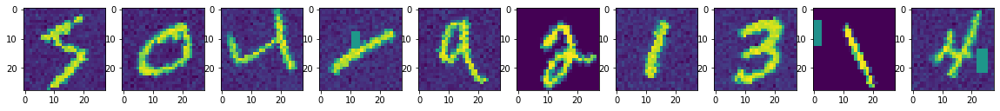

In [5]:
plt.rcParams['figure.figsize'] = [20, 5]
n_load = 10
i = 0


fig, ax = plt.subplots(1,n_load)
for i in range(n_load):
    ax[i].imshow(dataset.get_image(i)[0].detach().cpu().numpy().reshape([28,28]))
#plt.show()
#print(dataset.get_image(i)[1])

In [6]:
dataset.transform = torchvision.transforms.Compose([
                dataset_class_gsimage.min_max_scaler(device=device),
                torchvision.transforms.Normalize(mean=[0.0], std=[1.0]),
                #torchvision.transforms.RandomApply([dataset_class_gsimage.add_normal_noise(0.,0.1,device=device)], p=0.5),
                #torchvision.transforms.RandomErasing(p=0.5, scale=(0.01, 0.05), ratio=(0.3, 3.3), value=0, inplace=False)
            ])

In [7]:
"""Manually set network structure"""

input_size = dataset.get_input_size()
target_size = len(target_attributes)
output_size = target_size
#output_size = 1
fc_input_size = np.product(input_size)


latent_size = 128
#latent_size = [16, 4, 4]

In [8]:
discriminator_struct = []

"""
#self created discriminator model
disc_act_func = torch.relu

discriminator_struct.append( {"type": nn.Flatten, "layer_pars": {"start_dim": 1}} )
discriminator_struct.append( {"type": nn.Dropout, "layer_pars": {"p": 0.2 }} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": fc_input_size, "out_features": latent_size*8}, "bias": True, "act_func": disc_act_func} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size*8, "out_features": latent_size*4}, "bias": True, "act_func": disc_act_func} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size*4, "out_features": latent_size*2}, "bias": True, "act_func": disc_act_func} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size*2, "out_features": output_size}, "bias": True, "act_func": torch.sigmoid} )
"""

#discriminator model from downloaded gan

discriminator_struct.append( {"type": nn.Flatten, "layer_pars": {"start_dim": 1}} )
#discriminator_struct.append( {"type": nn.Dropout, "layer_pars": {"p": 0.3 }} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": fc_input_size, "out_features": 1024}, "bias": True} )
discriminator_struct.append( {"type": nn.LeakyReLU, "layer_pars": {"negative_slope": 0.1}} )
discriminator_struct.append( {"type": nn.Dropout, "layer_pars": {"p": 0.1 }} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": 1024, "out_features": 512}, "bias": True} )
discriminator_struct.append( {"type": nn.LeakyReLU, "layer_pars": {"negative_slope": 0.1}} )
discriminator_struct.append( {"type": nn.Dropout, "layer_pars": {"p": 0.1 }} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": 512, "out_features": 256}, "bias": True} )
discriminator_struct.append( {"type": nn.LeakyReLU, "layer_pars": {"negative_slope": 0.1}} )
discriminator_struct.append( {"type": nn.Dropout, "layer_pars": {"p": 0.1 }} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": 256, "out_features": output_size}, "bias": True, "act_func": torch.sigmoid} )


"""
#raw materials for a convolutional discriminator

kernel_pars = [ [[1,32],[3,3],1,0], [[32,32],[2,2],2,0], [[32,64],[4,4],1,0], [[64,64],[2,2],2,0] ]
act_func = torch.relu

for i, kernel_par in enumerate(kernel_pars):
    if i%2 == 0:
        layer_type = nn.Conv2d
        discriminator_struct.append( {"type": layer_type, "layer_pars": {"in_channels": kernel_par[0][0], "out_channels": kernel_par[0][1], "kernel_size": kernel_par[1], "stride": kernel_par[2], "padding": kernel_par[3], "bias": True}, "act_func": act_func} )
    else:
        layer_type = nn.MaxPool2d
        discriminator_struct.append( {"type": layer_type, "layer_pars": {"kernel_size": kernel_par[1], "stride": kernel_par[2], "padding": kernel_par[3]}} )

conv_sizes = utils.calc_layer_sizes([1,28,28], discriminator_struct)
fc_input_size = np.product(conv_sizes[-1])

discriminator_struct.append( {"type": nn.Flatten, "layer_pars": {"start_dim": 1}} )    
#discriminator_struct.append( {"type": utils.Reshape, "layer_pars": {"new_shape": [-1,fc_input_size]}} )    
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": fc_input_size, "out_features": fc_input_size}, "bias": True, "act_func": act_func} )
#discriminator_struct.append( {"type": nn.BatchNorm1d, "layer_pars": {"num_features": fc_input_size}} )
#discriminator_struct.append( {"type": nn.Dropout, "layer_pars": {"p": 0.25 }} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": fc_input_size, "out_features": fc_input_size}, "bias": True, "act_func": act_func} )
discriminator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": fc_input_size, "out_features": output_size}, "bias": True, "act_func": act_func} )
#discriminator_struct.append( {"type": nn.Softmax, "layer_pars": {"dim": 1}} )
"""

layer_sizes = utils.calc_layer_sizes(input_size, discriminator_struct)
print(layer_sizes)
        

0
<class 'torch.nn.modules.flatten.Flatten'>
1
<class 'torch.nn.modules.linear.Linear'>
2
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
3
<class 'torch.nn.modules.dropout.Dropout'>
4
<class 'torch.nn.modules.linear.Linear'>
5
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
6
<class 'torch.nn.modules.dropout.Dropout'>
7
<class 'torch.nn.modules.linear.Linear'>
8
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
9
<class 'torch.nn.modules.dropout.Dropout'>
10
<class 'torch.nn.modules.linear.Linear'>
[[1, 28, 28], 784, 1024, 1024, 1024, 512, 512, 512, 256, 256, 256, 1]


In [9]:
generator_struct = []

"""
#self created generator model
gen_act_func = torch.relu
generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size, "out_features": latent_size*2}, "bias": True, "act_func": gen_act_func} )
generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size*2, "out_features": latent_size*4}, "bias": True, "act_func": gen_act_func} )
generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size*4, "out_features": latent_size*8}, "bias": True, "act_func": gen_act_func} )
#generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size*8, "out_features": fc_input_size}, "bias": True, "gen_act_func": gen_act_func} )
generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size*8, "out_features": fc_input_size}, "bias": True, "act_func": torch.tanh} )
generator_struct.append( {"type": utils.Reshape, "layer_pars": {"new_shape": input_size}} )
#generator_struct.append( {"type": utils.MinMax, "layer_pars": {}} )
"""


#generator model from downloaded gan

generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": latent_size, "out_features": 256}, "bias": True} )
generator_struct.append( {"type": nn.LeakyReLU, "layer_pars": {"negative_slope": 0.1}} )
generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": 256, "out_features": 512}, "bias": True} )
generator_struct.append( {"type": nn.LeakyReLU, "layer_pars": {"negative_slope": 0.1}} )
generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": 512, "out_features": 1024}, "bias": True} )
generator_struct.append( {"type": nn.LeakyReLU, "layer_pars": {"negative_slope": 0.1}} )
generator_struct.append( {"type": nn.Linear, "layer_pars": {"in_features": 1024, "out_features": fc_input_size}, "bias": True, "act_func": torch.tanh} )
generator_struct.append( {"type": utils.Reshape, "layer_pars": {"new_shape": input_size}} )


"""
#raw materials for a convolutional generator

generator_struct.append( {"type": nn.ConvTranspose2d, "layer_pars": {"in_channels": latent_size[0], "out_channels": latent_size[0], "kernel_size": [3,3], "stride": 2, "padding": 0, "bias": True}, "act_func": gen_act_func} )
generator_struct.append( {"type": nn.ConvTranspose2d, "layer_pars": {"in_channels": latent_size[0], "out_channels": 2*latent_size[0], "kernel_size": [3,3], "stride": 2, "padding": 1, "bias": True}, "act_func": gen_act_func} )
generator_struct.append( {"type": nn.ConvTranspose2d, "layer_pars": {"in_channels": 2*latent_size[0], "out_channels": 2*latent_size[0], "kernel_size": [3,3], "stride": 2, "padding": 1, "bias": True}, "act_func": gen_act_func} )
generator_struct.append( {"type": nn.ConvTranspose2d, "layer_pars": {"in_channels": 2*latent_size[0], "out_channels": 2*latent_size[0], "kernel_size": [3,3], "stride": 1, "padding": 2, "bias": True}, "act_func": gen_act_func} )
generator_struct.append( {"type": nn.ConvTranspose2d, "layer_pars": {"in_channels": 2*latent_size[0], "out_channels": 1, "kernel_size": [2,2], "stride": 1, "padding": 2, "bias": True}, "gen_act_func": act_func} )
"""

layer_sizes = utils.calc_layer_sizes(latent_size, generator_struct)
print(layer_sizes)

0
<class 'torch.nn.modules.linear.Linear'>
1
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
2
<class 'torch.nn.modules.linear.Linear'>
3
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
4
<class 'torch.nn.modules.linear.Linear'>
5
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
6
<class 'torch.nn.modules.linear.Linear'>
7
<class 'utils.Reshape'>
[128, 256, 256, 512, 512, 1024, 1024, 784, [1, 28, 28]]


In [10]:
"""
HYPERPARAMETERS
"""

random_seed = 42
np.random.seed(random_seed)
torch.manual_seed(random_seed)

#val_epochs = [10,20,30,40,50,60,70]
#val_epochs = list(range(0,50))
val_epochs = list(range(0,200))
#val_epochs = [10,15,20,25,30,35,40,45]
#val_epochs = [0,1,2,3,4,5,6,7,8,9,10,15,20]
#val_epochs = [0,1]

#save states of the network for particular epochs, sate can be reloaded afterwards!
save_state_epochs = [10000]

"""create list of parameters manually"""

hyper_parameters = {}
loss_func_kwargs = {"reduction": "sum"}
#hyper_parameters["loss_func"] = nn.CrossEntropyLoss
hyper_parameters["loss_func"] = nn.BCELoss
#hyper_parameters["loss_func"] = nn.MSELoss
hyper_parameters["optimizer"] = optim.Adam
hyper_parameters["batch_size"] = 100
hyper_parameters["lr"] = 0.0001



In [11]:
epochs = max(val_epochs)+1

lr=hyper_parameters["lr"]
batch_size = hyper_parameters["batch_size"]
loss_func = hyper_parameters["loss_func"](**loss_func_kwargs)
#loss_func = hyper_parameters["loss_func"]()
optimizer_type = hyper_parameters["optimizer"]

val_pred_paths = []
val_label_paths = []

train_loss = np.zeros(epochs)
train_loss = []
val_loss = np.zeros(len(val_epochs))

net_state_paths = []

#create training log
log_file_name = "log.txt"
log_file = open(log_file_name, "w")

In [12]:
"""Generate network class instance"""
"""
net = gan_torch_net_class.GAN(generator_struct=generator_struct, discriminator_struct=discriminator_struct, data_size=input_size, latent_size=latent_size, device=device)
net.set_batch_size(batch_size)
net.to(device)

generator_optimizer = optimizer_type(net.generator.parameters(), lr=lr)
discriminator_optimizer = optimizer_type(net.discriminator.parameters(), lr=lr)
"""
discriminator = d_gan_torch_net_class.Discriminator("Discriminator", discriminator_struct, input_size, output_size, device)
generator = g_gan_torch_net_class.Generator("Generator", generator_struct, latent_size, input_size, device)
discriminator.to(device)
generator.to(device)

"""Noise for generator input"""
std_no_kwargs = {"loc" : 0.0, "scale" : 1.0}
generator.set_latent_dist(torch.distributions.normal.Normal, std_no_kwargs)

"""Set the optimizer for both"""
generator_optimizer = optimizer_type(generator.parameters(), lr=lr)
discriminator_optimizer = optimizer_type(discriminator.parameters(), lr=lr)

0
<class 'torch.nn.modules.flatten.Flatten'>
1
<class 'torch.nn.modules.linear.Linear'>
2
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
3
<class 'torch.nn.modules.dropout.Dropout'>
4
<class 'torch.nn.modules.linear.Linear'>
5
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
6
<class 'torch.nn.modules.dropout.Dropout'>
7
<class 'torch.nn.modules.linear.Linear'>
8
<class 'torch.nn.modules.activation.LeakyReLU'>
custom layer operation not defined, assuming previous layer_size
9
<class 'torch.nn.modules.dropout.Dropout'>
10
<class 'torch.nn.modules.linear.Linear'>
Initializing Discriminator:

Adding {'type': <class 'torch.nn.modules.flatten.Flatten'>, 'layer_pars': {'start_dim': 1}}

Adding {'type': <class 'torch.nn.modules.linear.Linear'>, 'layer_pars': {'in_features': 784, 'out_features': 1024}, 'bias': True}

Adding {'type': <class 'torch.nn.modules.activati

In [13]:
generator

Generator(
  (layers): ModuleList(
    (0): Linear(in_features=128, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.1)
    (2): Linear(in_features=256, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.1)
    (4): Linear(in_features=512, out_features=1024, bias=True)
    (5): LeakyReLU(negative_slope=0.1)
    (6): Linear(in_features=1024, out_features=784, bias=True)
    (7): Reshape()
  )
)

In [14]:
discriminator

Discriminator(
  (layers): ModuleList(
    (0): Flatten()
    (1): Linear(in_features=784, out_features=1024, bias=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Dropout(p=0.1, inplace=False)
    (4): Linear(in_features=1024, out_features=512, bias=True)
    (5): LeakyReLU(negative_slope=0.1)
    (6): Dropout(p=0.1, inplace=False)
    (7): Linear(in_features=512, out_features=256, bias=True)
    (8): LeakyReLU(negative_slope=0.1)
    (9): Dropout(p=0.1, inplace=False)
    (10): Linear(in_features=256, out_features=1, bias=True)
  )
)

In [15]:
"""Load data"""
all_indices = range(0,len(dataset))

train_sampler = torch.utils.data.sampler.SubsetRandomSampler(all_indices)

train_loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, sampler=train_sampler)

In [16]:
latent_mini_batch_shape = np.concatenate(([batch_size], [latent_size]))
def d_train(discriminator, generator, loss_func, discriminator_optimizer, data, device):
    """Train discriminator"""
    discriminator.zero_grad()

    # train discriminator on real
    data_real = data
    data_real = Variable(data_real.to(device))
    
    discriminator_output = discriminator(data_real)
    
    label_real = torch.ones(discriminator_output.size())
    label_real = Variable( label_real.to(device) )
    
    discriminator_real_loss = loss_func(discriminator_output, label_real)
    #discriminator_real_score = discriminator_output

    # train discriminator on fake
    latent_z = Variable( generator.latent_dist.sample(tuple(latent_mini_batch_shape)).to(device) )
    data_fake =  generator(latent_z)
    label_fake = Variable( torch.zeros(batch_size, 1).to(device) )
    
    discriminator_output =  discriminator(data_fake)
    discriminator_fake_loss = loss_func(discriminator_output, label_fake)
    discriminator_fake_score = discriminator_output

    #backpropagation and optimization of discriminator
    discriminator_loss = discriminator_real_loss + discriminator_fake_loss
    discriminator_loss.backward()
    discriminator_optimizer.step()
        
    return  discriminator_loss.data.item()

def g_train(discriminator, generator, loss_func, generator_optimizer, device):
    """Train generator"""
    generator.zero_grad()

    latent_z = Variable( generator.latent_dist.sample(tuple(latent_mini_batch_shape)).to(device) )
    label_real = Variable( torch.ones(batch_size, 1).to(device) )

    generator_output = generator(latent_z)
    discriminator_output = discriminator(generator_output)
    generator_loss = loss_func(discriminator_output, label_real)

    #backpropagation and optimization of generator
    generator_loss.backward()
    generator_optimizer.step()
    
    return generator_loss.data.item(), generator_output

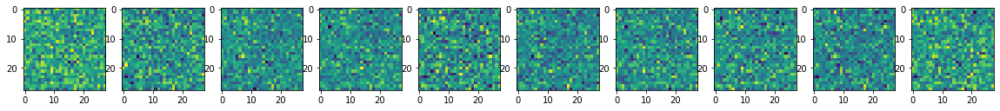

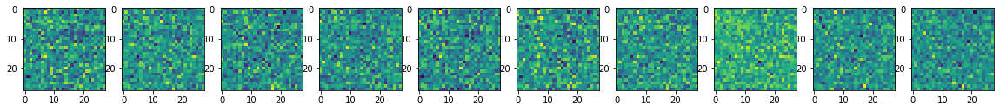

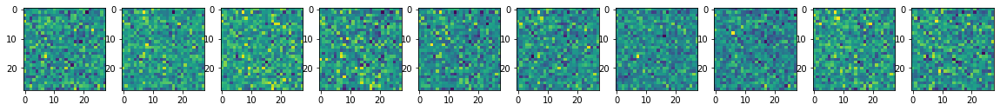


mean epoch 0 generator/discriminator loss: [ 98.48915535 112.89803741]



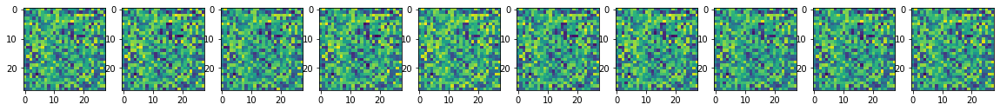

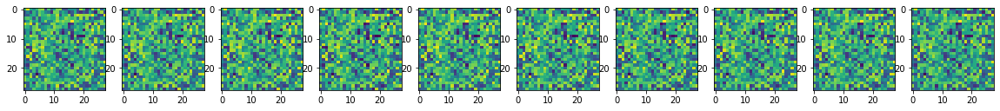

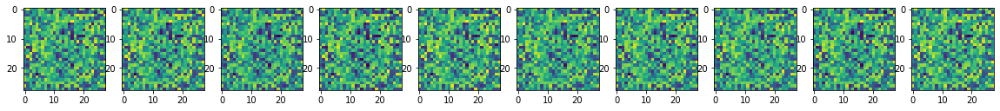


mean epoch 1 generator/discriminator loss: [138.73591031 103.24152536]



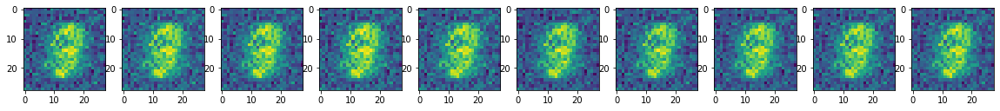

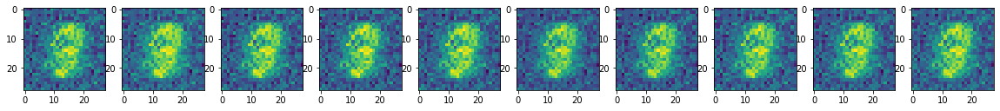

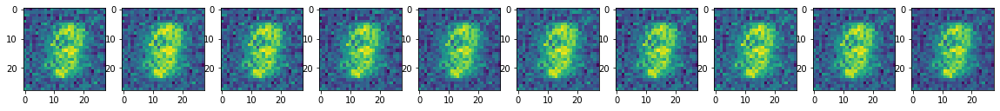


mean epoch 2 generator/discriminator loss: [114.96118034 132.56760742]



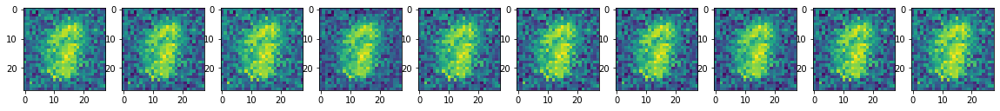

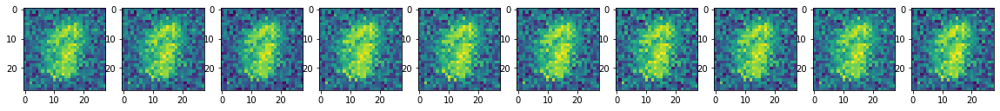

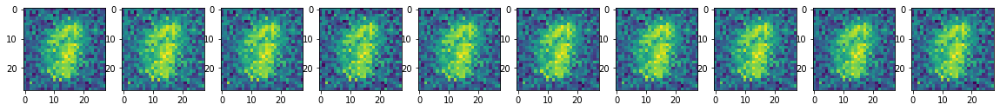


mean epoch 3 generator/discriminator loss: [117.56448338 123.98257191]



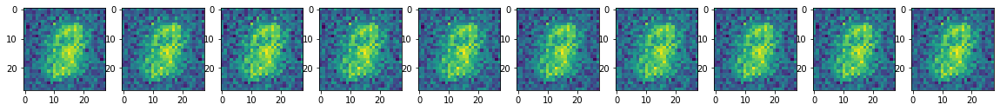

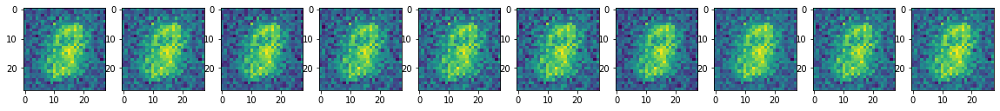

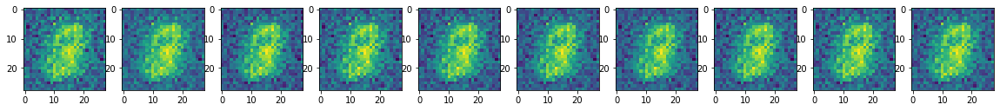


mean epoch 4 generator/discriminator loss: [171.4578434   96.35601557]



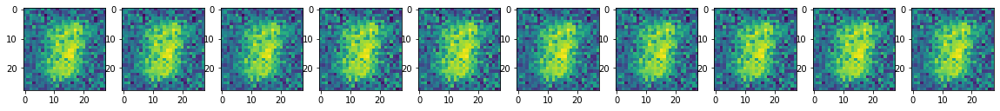

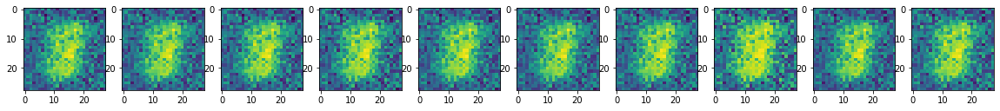

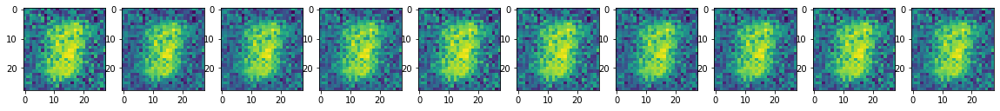


mean epoch 5 generator/discriminator loss: [172.72495598  87.32076881]



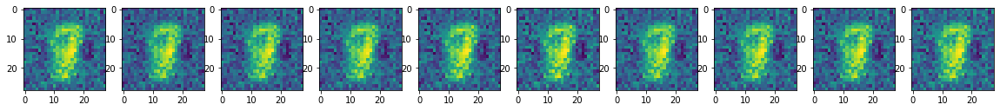

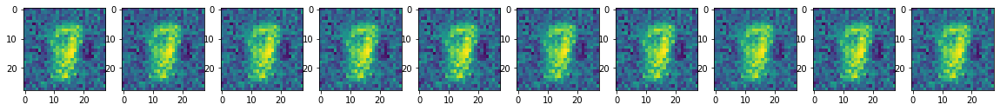

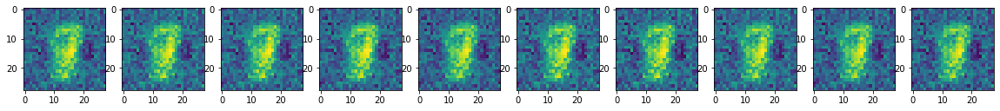


mean epoch 6 generator/discriminator loss: [281.79530212 107.48641035]



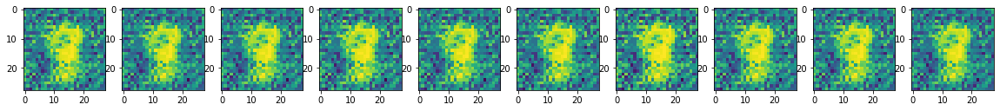

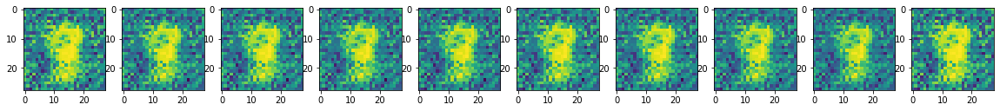

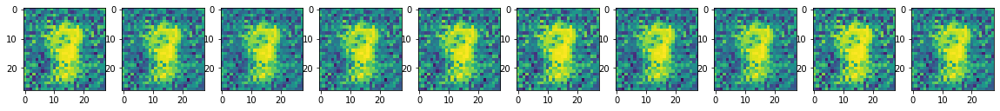


mean epoch 7 generator/discriminator loss: [189.46528732  70.5702858 ]



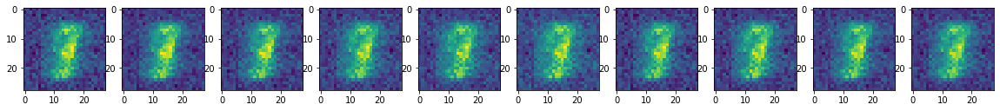

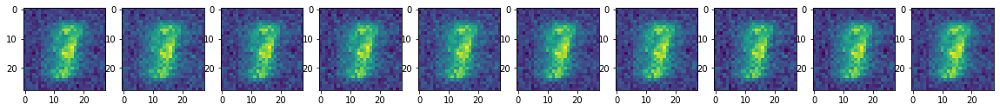

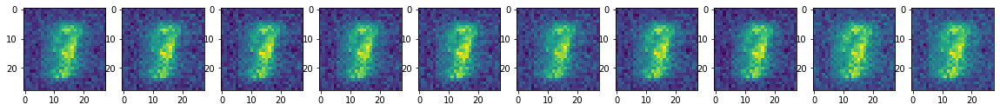


mean epoch 8 generator/discriminator loss: [194.61807144  27.58929192]



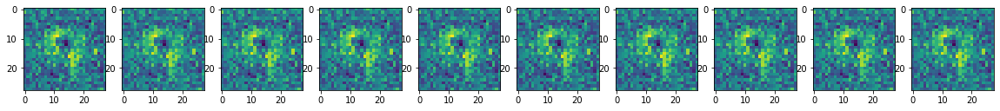

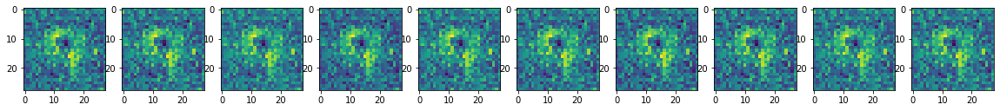

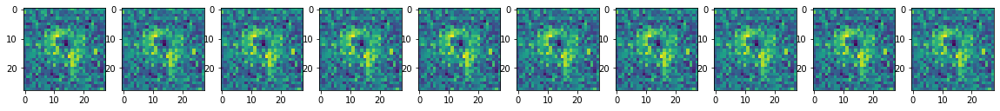


mean epoch 9 generator/discriminator loss: [447.53656036 168.59729214]



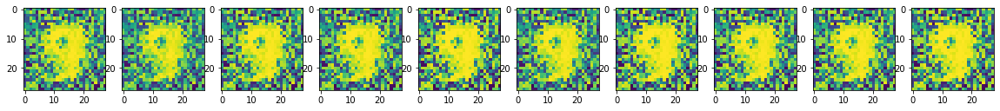

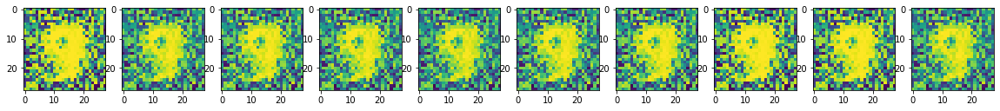

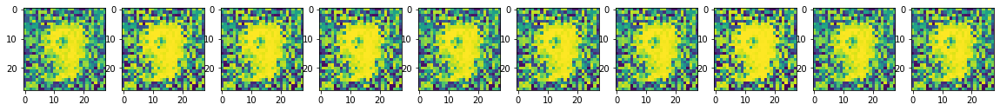


mean epoch 10 generator/discriminator loss: [261.76691528  58.72765167]



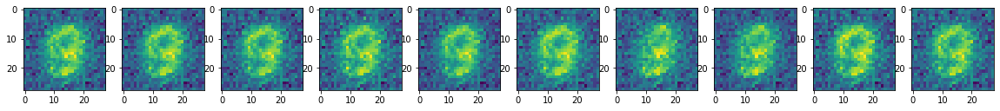

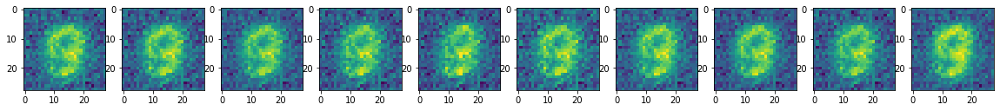

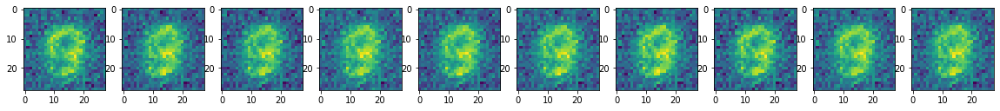


mean epoch 11 generator/discriminator loss: [246.86753098  34.48513295]



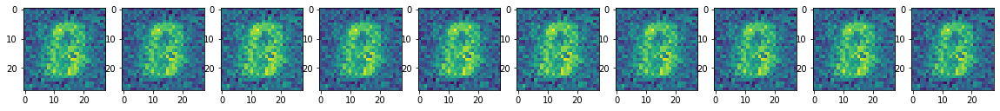

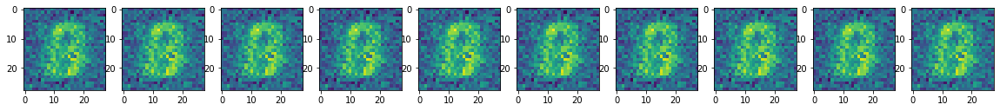

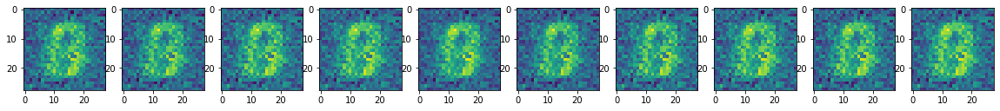


mean epoch 12 generator/discriminator loss: [282.89326111  32.53037011]



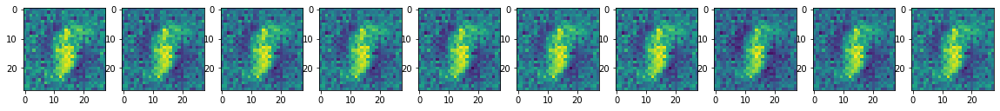

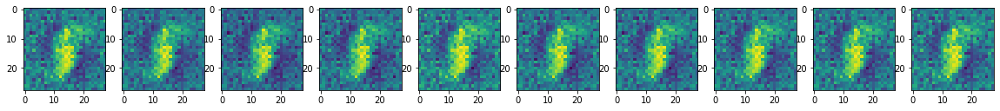

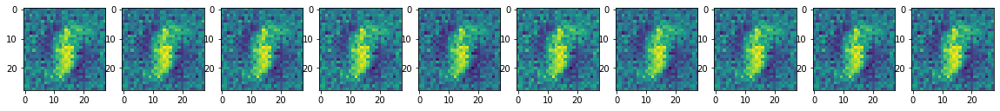


mean epoch 13 generator/discriminator loss: [429.35417267  61.09827683]



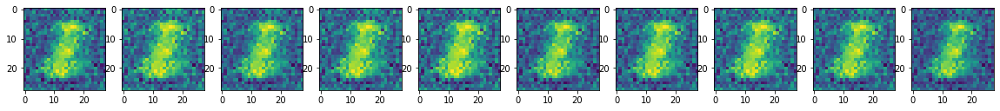

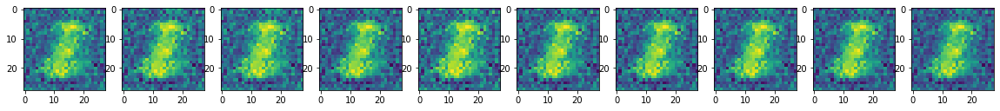

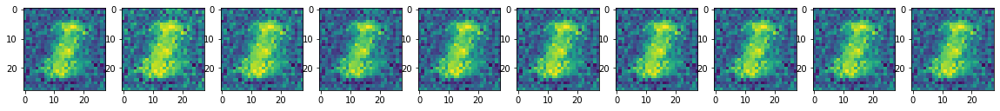


mean epoch 14 generator/discriminator loss: [235.01148392  21.41335346]



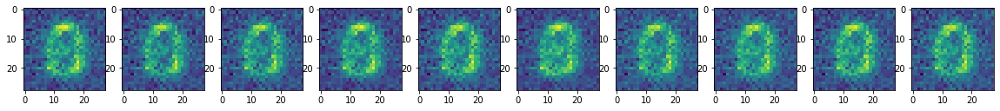

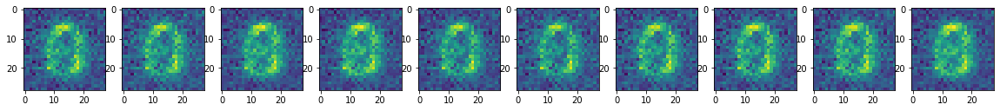

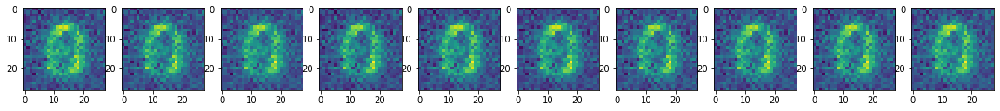


mean epoch 15 generator/discriminator loss: [409.87463943 101.75565329]



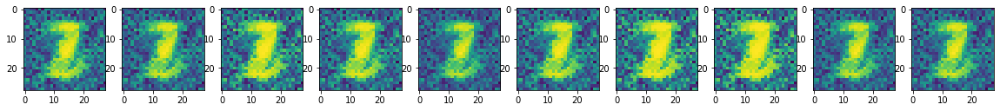

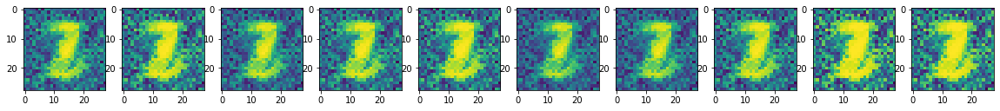

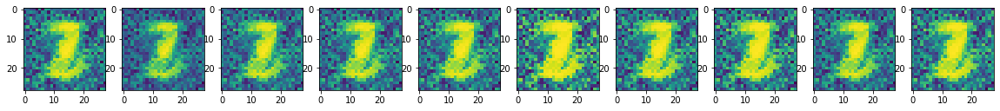


mean epoch 16 generator/discriminator loss: [250.75562912  46.79484138]



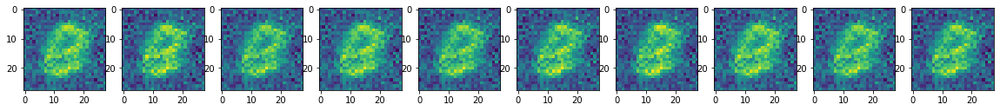

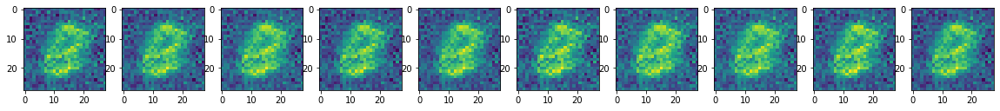

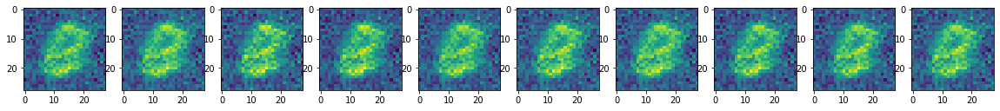


mean epoch 17 generator/discriminator loss: [226.32240005  31.46242217]



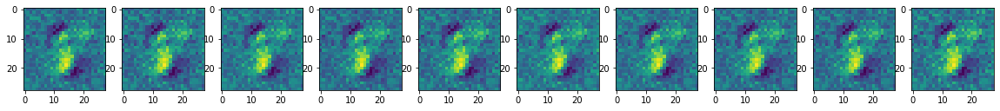

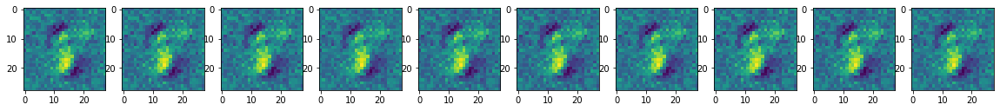

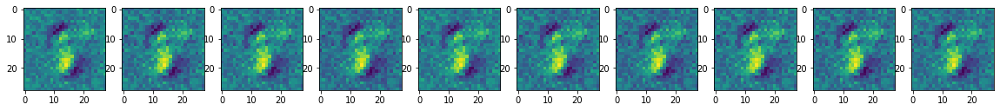


mean epoch 18 generator/discriminator loss: [280.07725906  34.95367379]



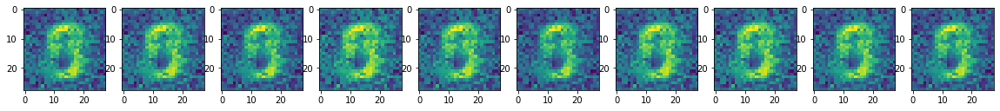

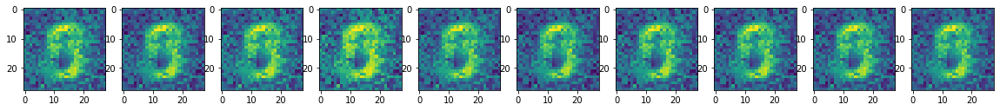

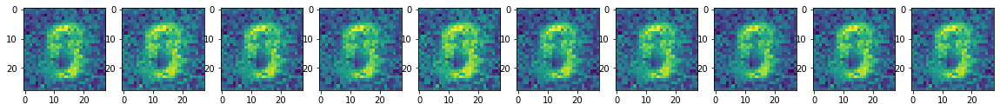


mean epoch 19 generator/discriminator loss: [379.28750519  17.40404054]



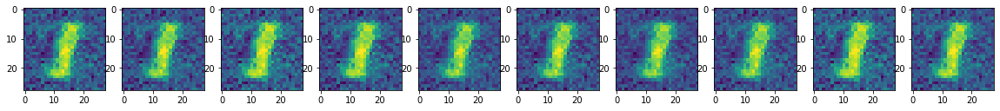

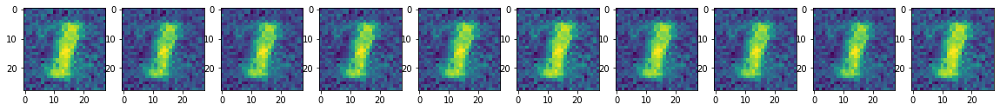

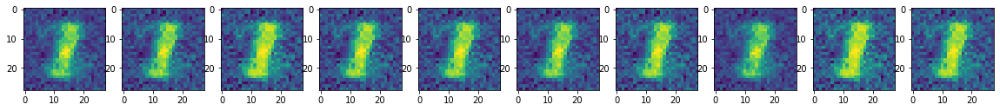


mean epoch 20 generator/discriminator loss: [432.38740891  39.94290246]



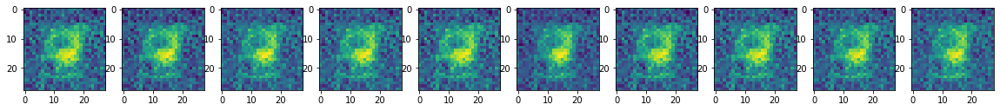

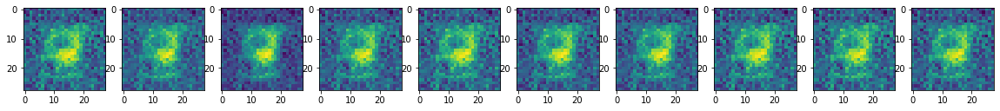

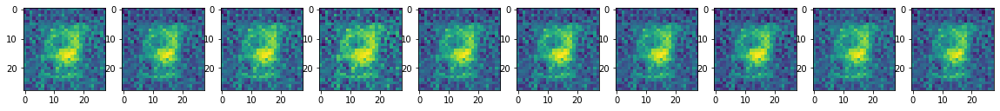


mean epoch 21 generator/discriminator loss: [304.93720566  30.29207896]



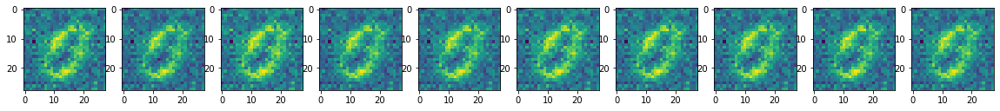

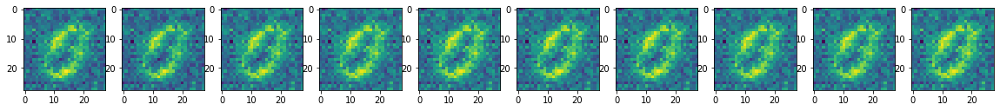

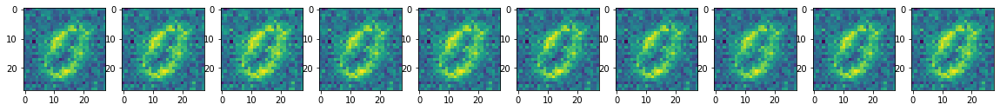


mean epoch 22 generator/discriminator loss: [396.78317047  39.3563831 ]



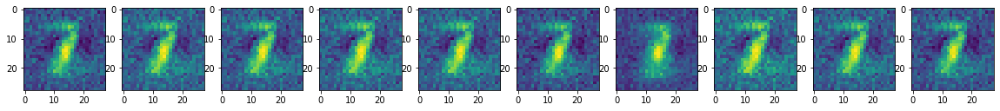

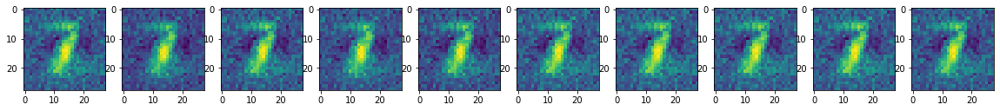

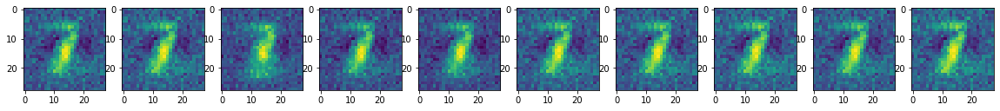


mean epoch 23 generator/discriminator loss: [357.84381561  32.2604196 ]



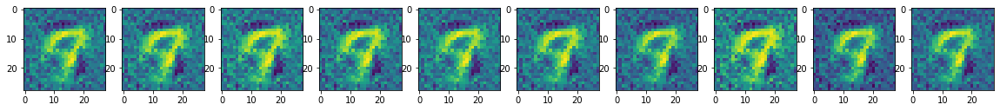

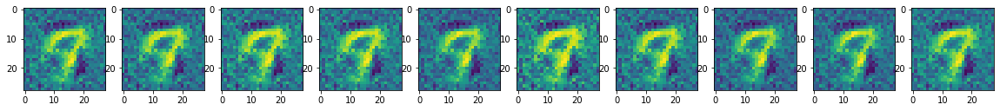

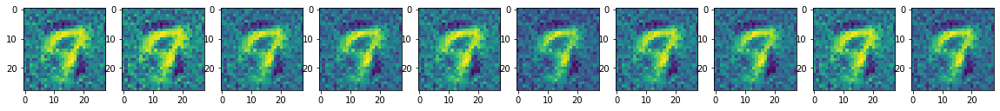


mean epoch 24 generator/discriminator loss: [351.08676956  36.70153153]



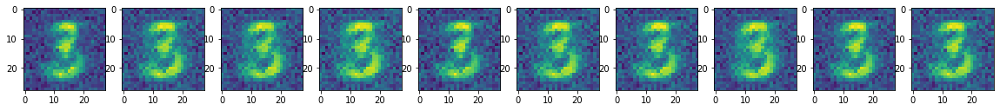

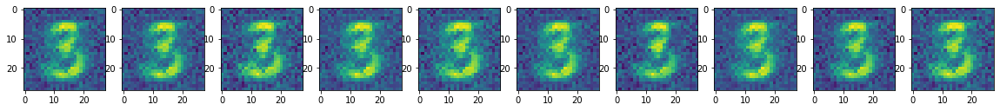

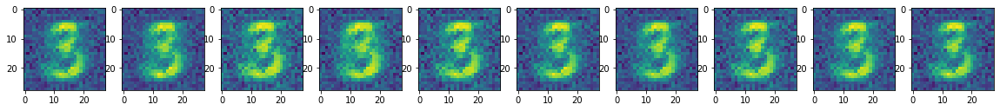


mean epoch 25 generator/discriminator loss: [263.71301224  23.23929387]



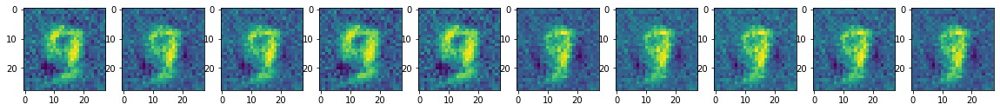

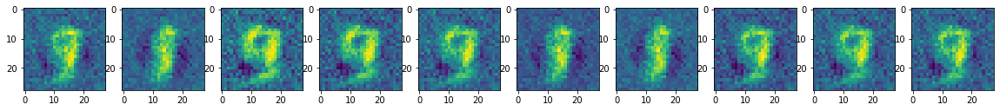

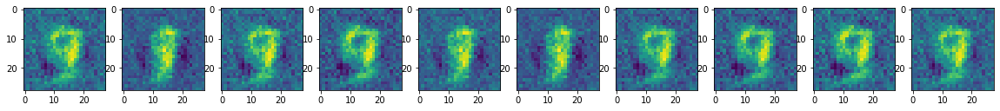


mean epoch 26 generator/discriminator loss: [420.49023224  33.75786121]



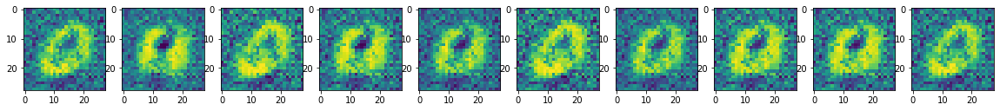

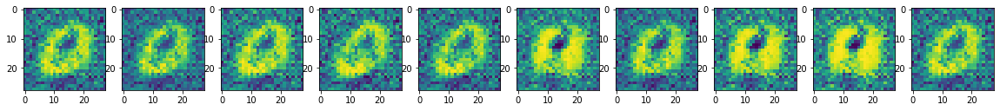

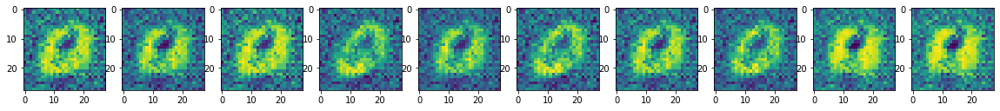


mean epoch 27 generator/discriminator loss: [454.82116577  20.21274725]



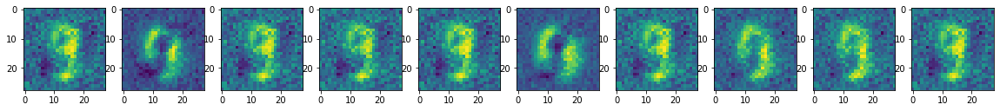

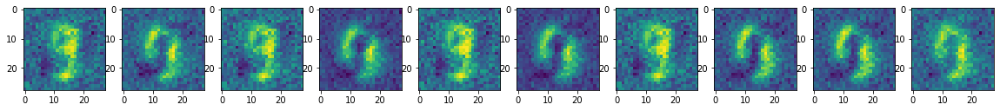

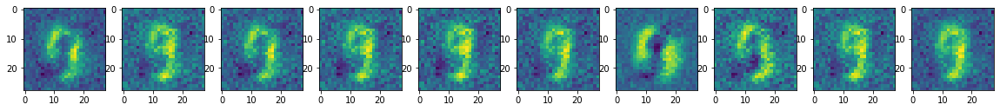


mean epoch 28 generator/discriminator loss: [370.39438141  32.10171356]



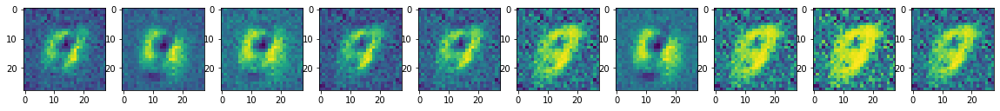

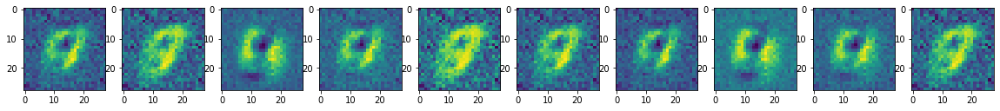

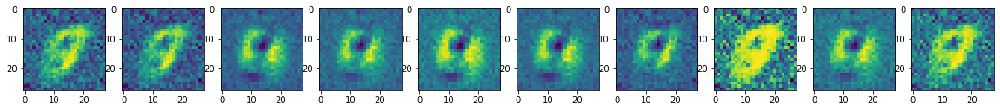


mean epoch 29 generator/discriminator loss: [407.91052246  16.41478827]



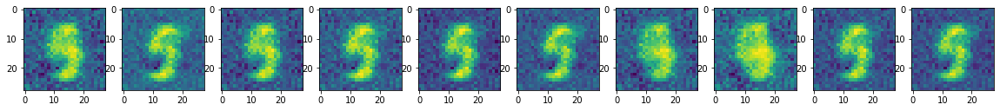

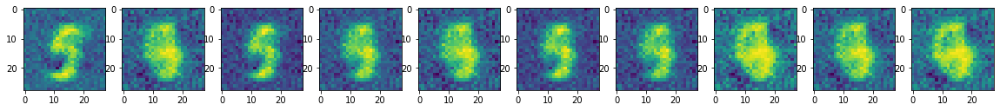

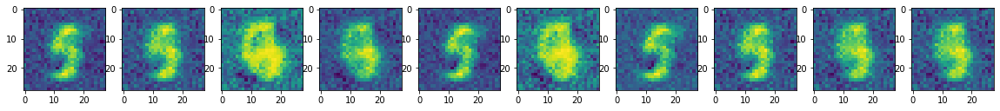


mean epoch 30 generator/discriminator loss: [460.8208197  19.6195761]



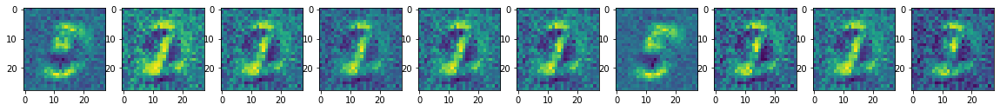

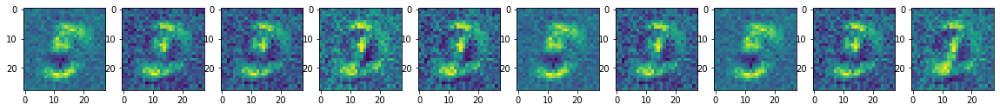

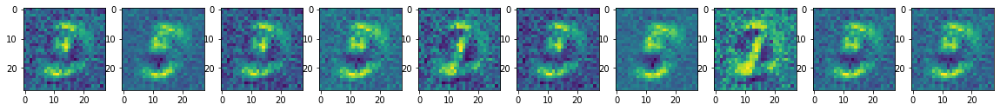


mean epoch 31 generator/discriminator loss: [384.54101501  28.04241637]



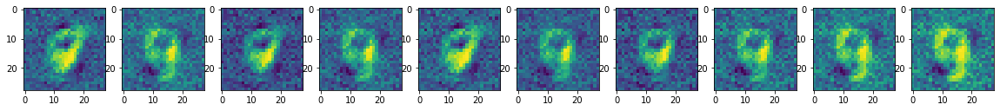

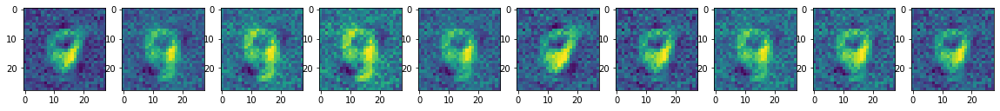

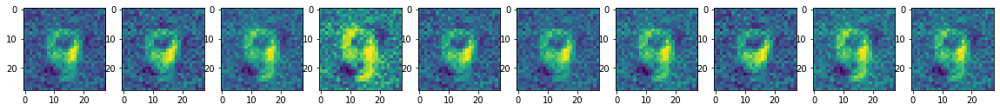


mean epoch 32 generator/discriminator loss: [528.48597992  29.42459433]



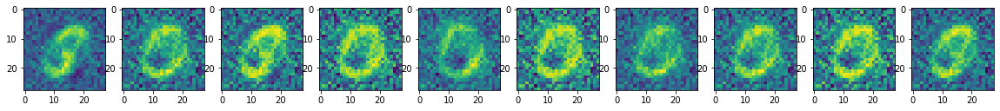

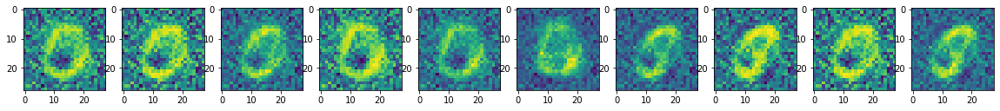

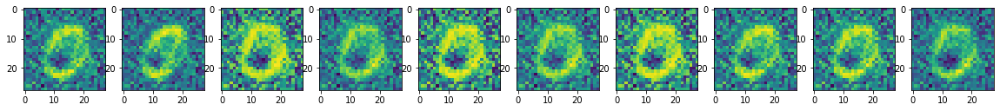


mean epoch 33 generator/discriminator loss: [380.47891174  17.79379856]



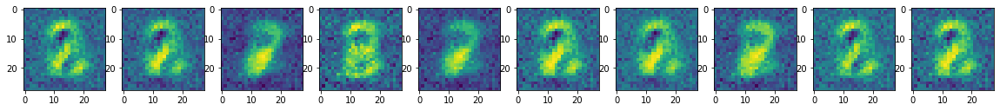

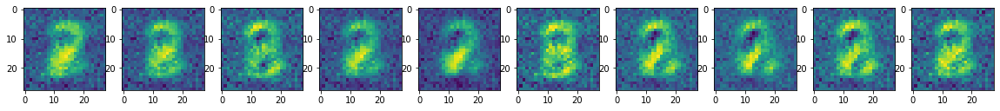

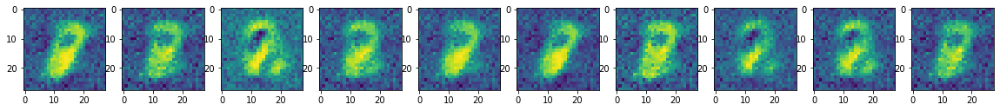


mean epoch 34 generator/discriminator loss: [469.97336487  16.94627009]



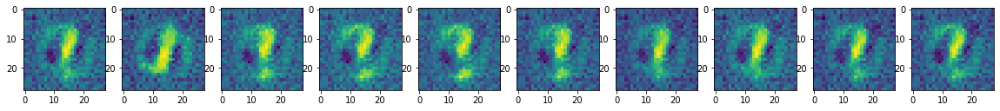

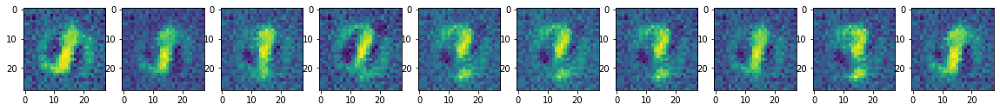

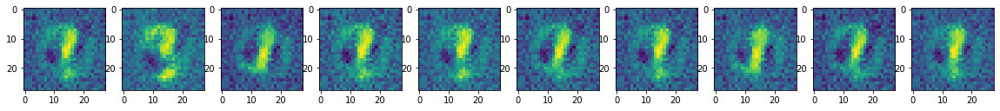


mean epoch 35 generator/discriminator loss: [440.14541473  23.62024622]



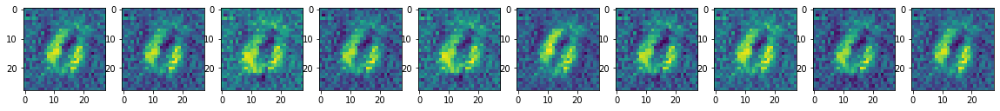

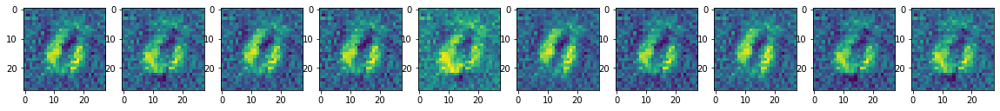

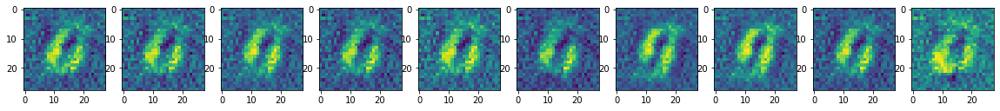


mean epoch 36 generator/discriminator loss: [458.66924713  24.62088828]



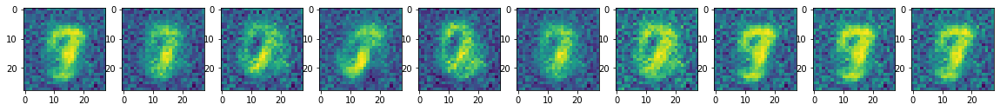

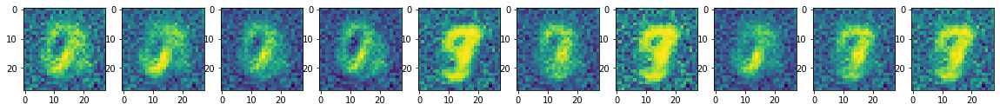

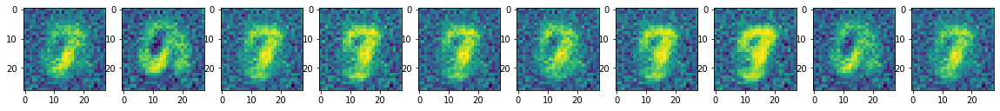


mean epoch 37 generator/discriminator loss: [414.53043579  17.3746994 ]



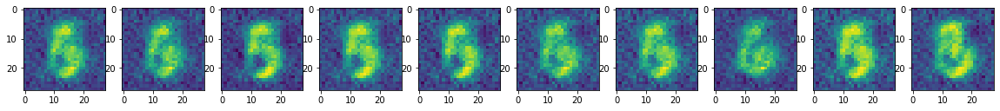

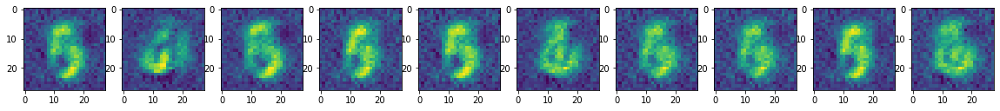

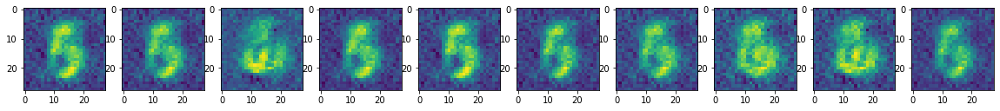


mean epoch 38 generator/discriminator loss: [437.15853455  18.98500172]



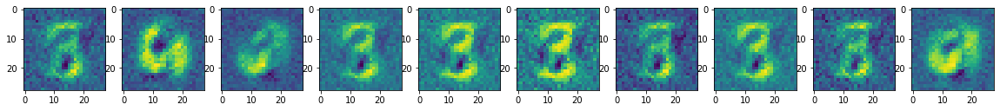

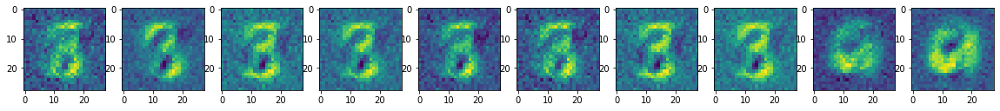

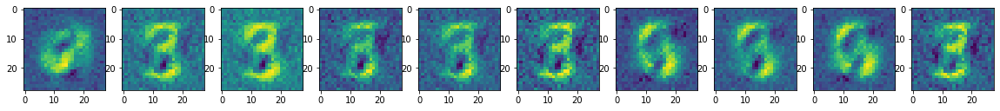


mean epoch 39 generator/discriminator loss: [399.32557281  24.01487017]



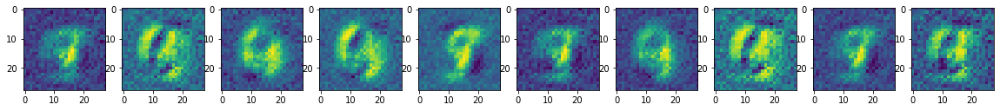

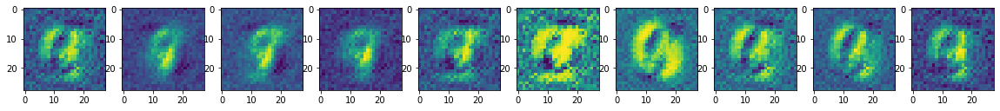

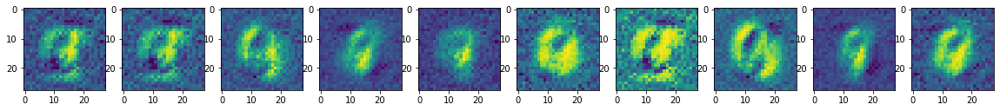


mean epoch 40 generator/discriminator loss: [445.57514587  23.94531012]



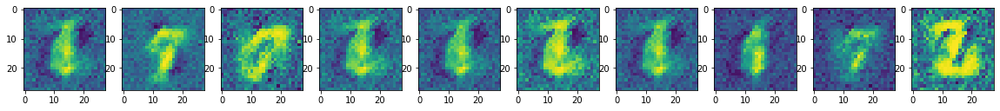

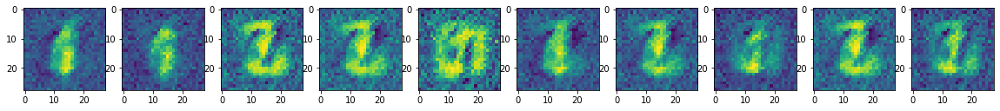

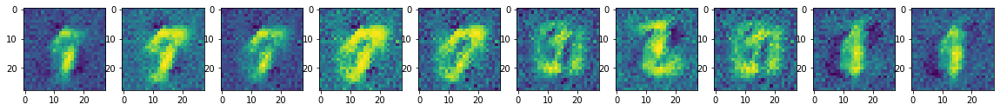


mean epoch 41 generator/discriminator loss: [392.05547913  26.07528779]



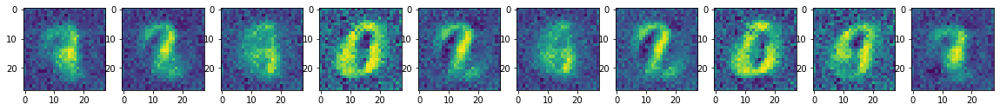

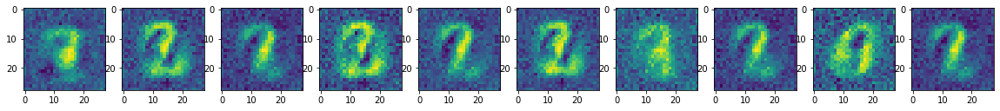

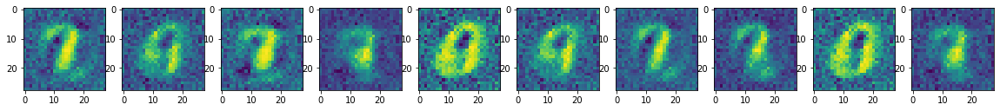


mean epoch 42 generator/discriminator loss: [489.96549835  17.08079906]



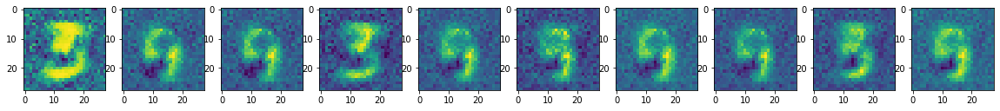

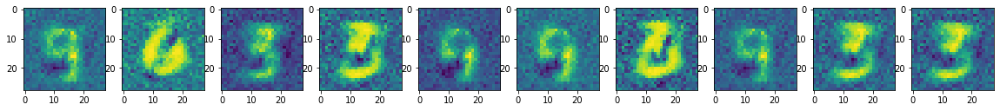

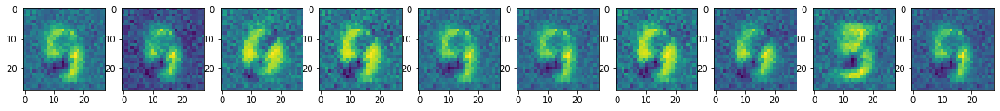


mean epoch 43 generator/discriminator loss: [489.38085846  15.37251828]



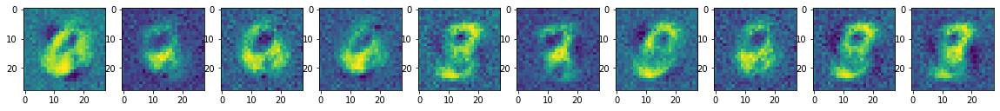

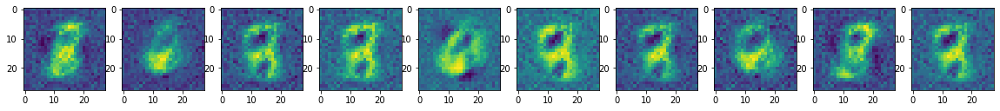

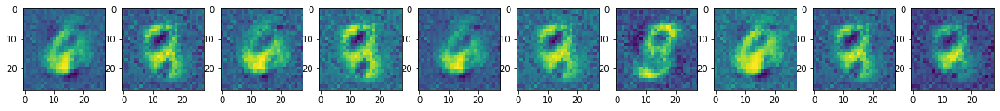


mean epoch 44 generator/discriminator loss: [460.70442963  17.5353161 ]



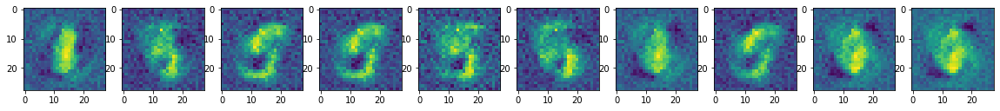

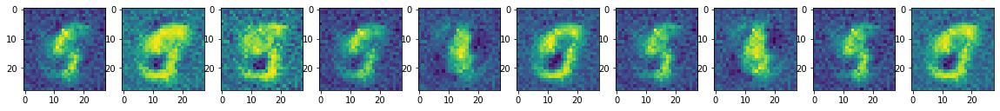

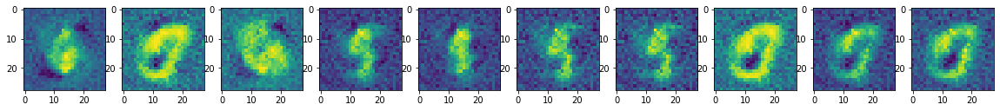


mean epoch 45 generator/discriminator loss: [525.3902243   19.32177855]



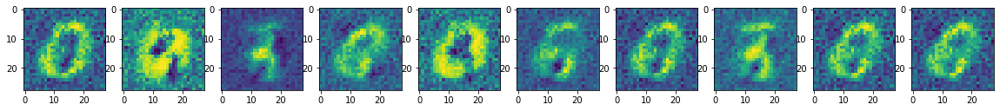

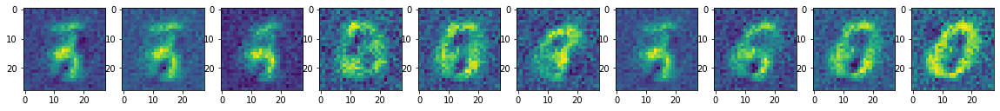

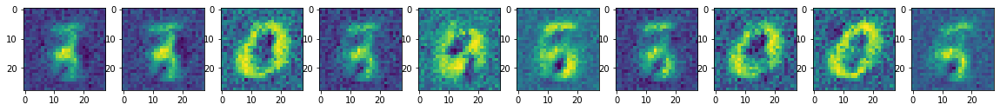


mean epoch 46 generator/discriminator loss: [492.20858429  19.01975484]



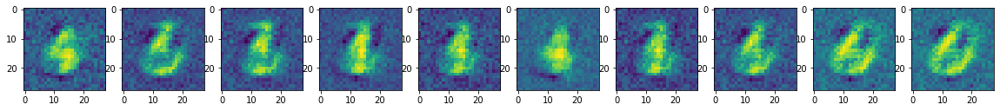

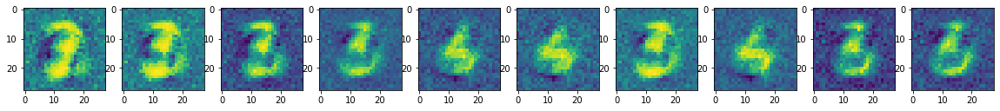

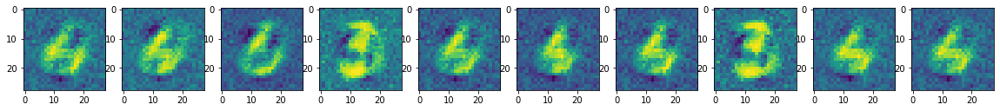


mean epoch 47 generator/discriminator loss: [516.67324707  14.63244074]



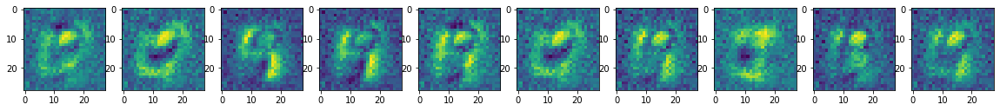

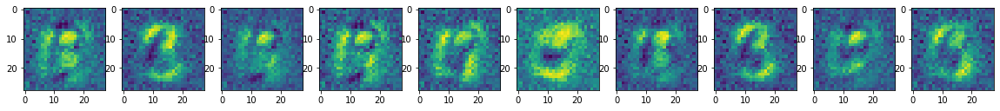

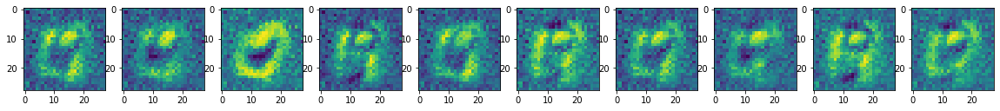


mean epoch 48 generator/discriminator loss: [482.53011322  19.84012995]



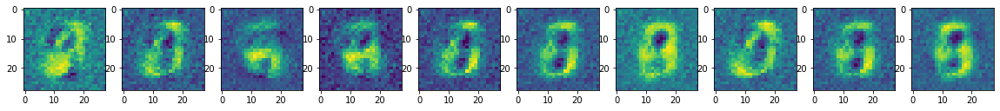

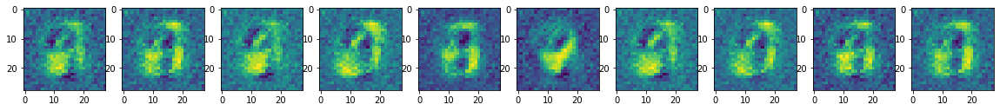

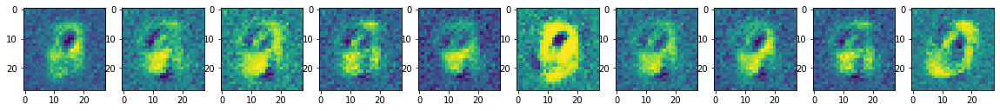


mean epoch 49 generator/discriminator loss: [458.01005219  14.52390042]



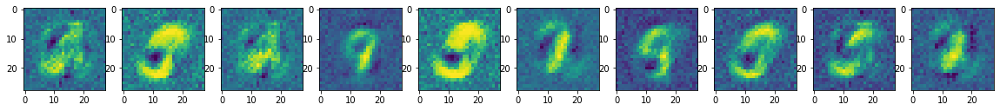

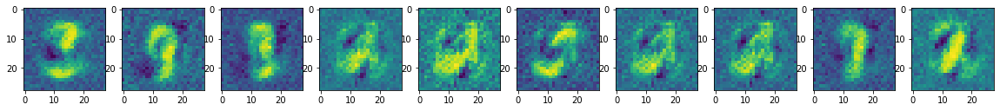

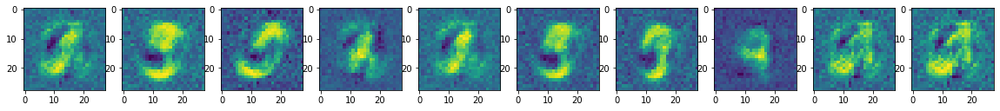


mean epoch 50 generator/discriminator loss: [523.15365784  11.22372116]



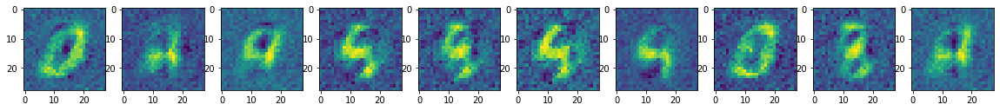

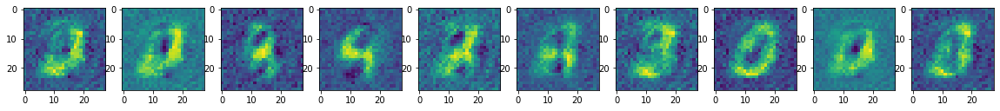

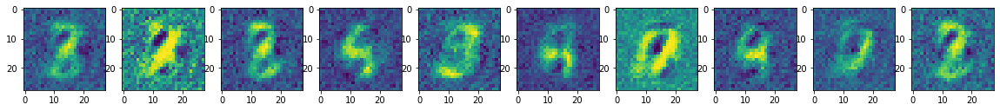


mean epoch 51 generator/discriminator loss: [541.8462796   17.17830173]



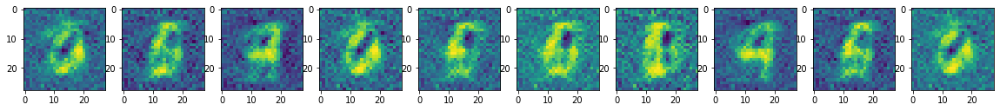

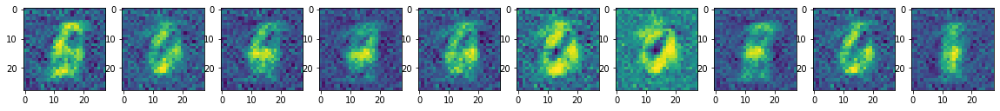

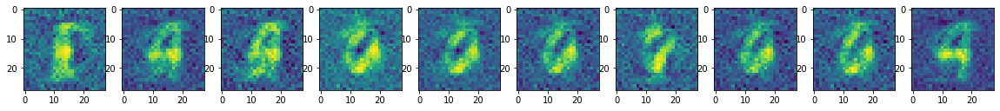


mean epoch 52 generator/discriminator loss: [569.63623413  13.9725944 ]



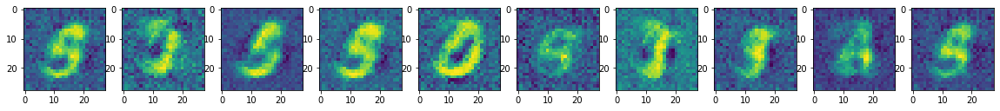

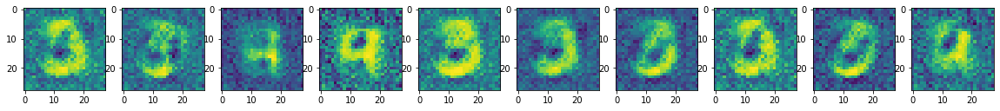

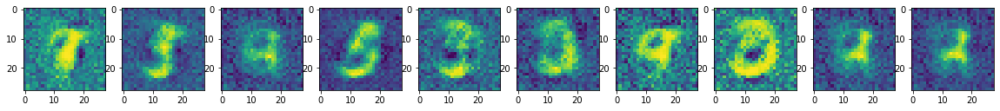


mean epoch 53 generator/discriminator loss: [563.78437408  11.64380739]



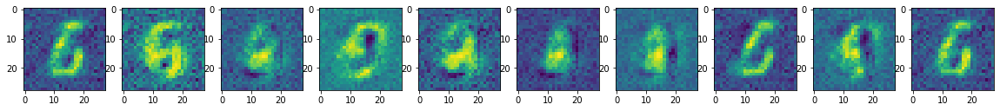

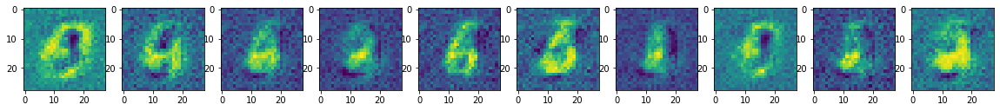

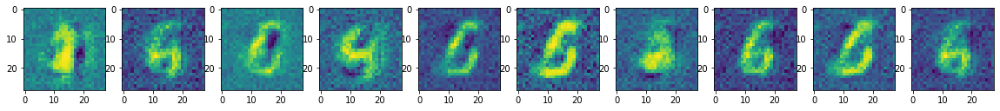


mean epoch 54 generator/discriminator loss: [576.62537903  12.5379099 ]



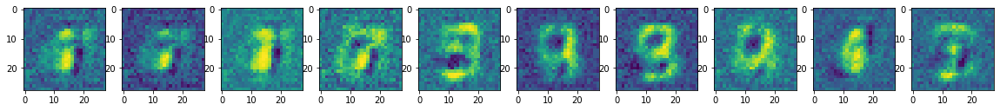

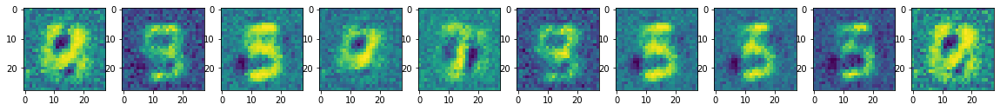

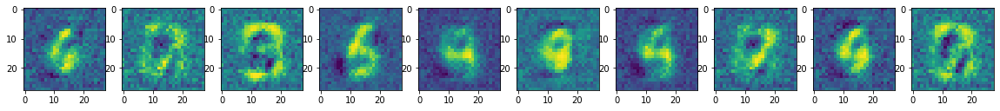


mean epoch 55 generator/discriminator loss: [535.56318512  12.67596798]



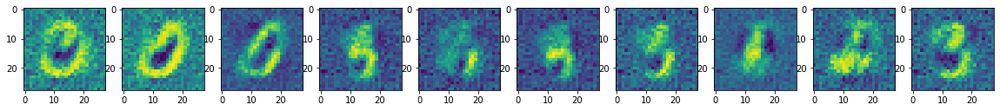

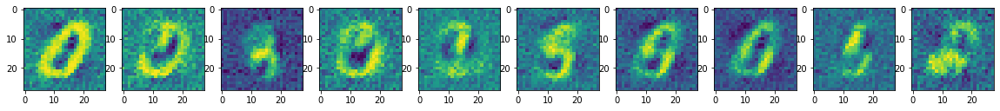

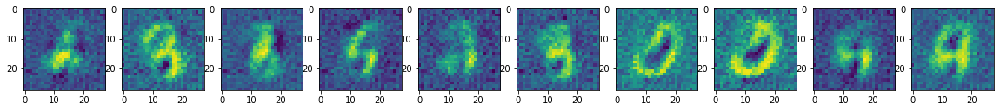


mean epoch 56 generator/discriminator loss: [559.27912842  15.19322241]



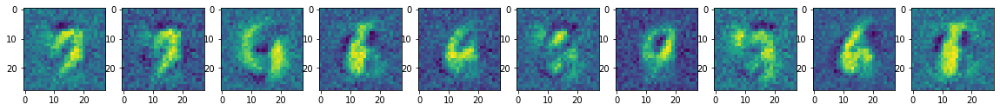

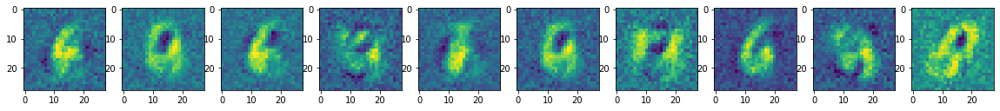

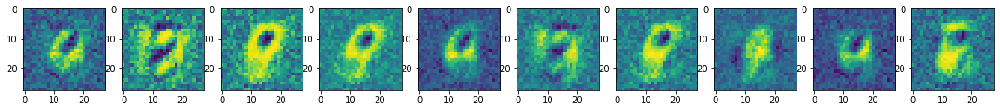


mean epoch 57 generator/discriminator loss: [550.02736664  10.77902496]



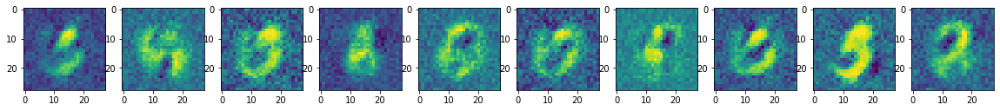

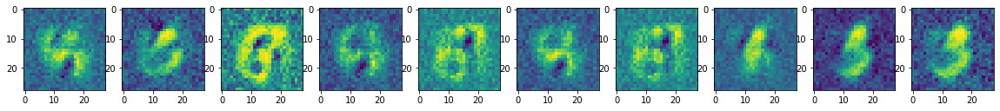

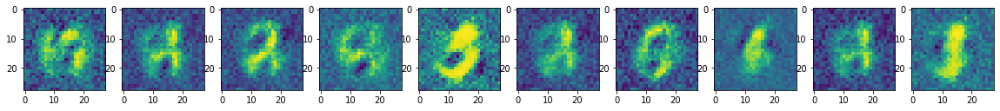


mean epoch 58 generator/discriminator loss: [594.66404022  11.09086328]



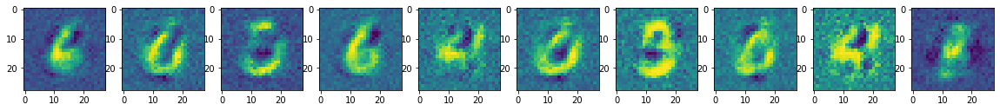

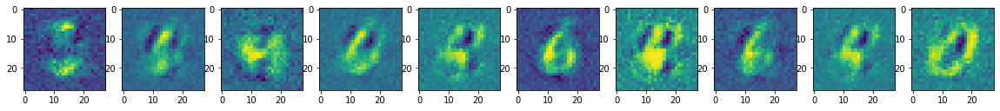

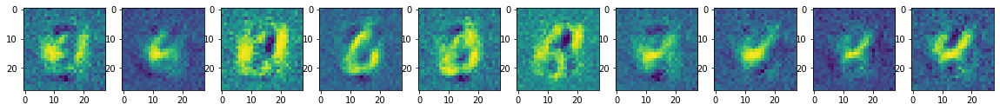


mean epoch 59 generator/discriminator loss: [594.1880072   11.66647247]



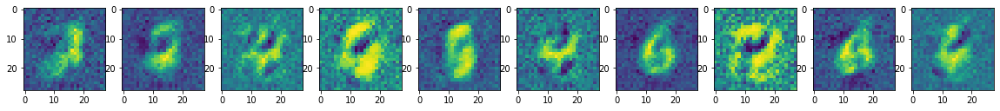

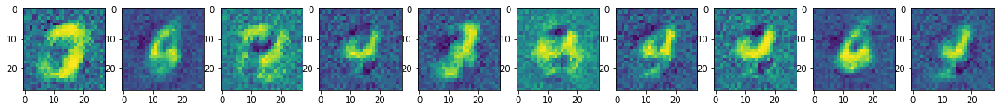

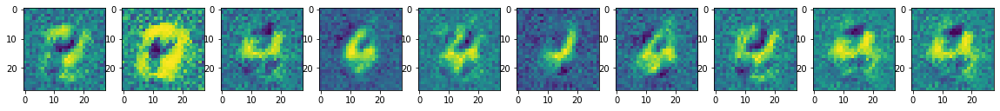


mean epoch 60 generator/discriminator loss: [592.91323914  12.83883318]



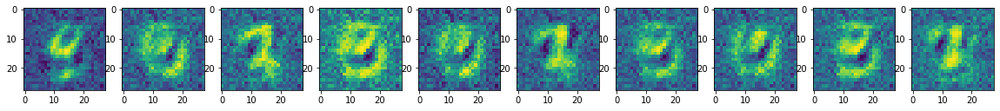

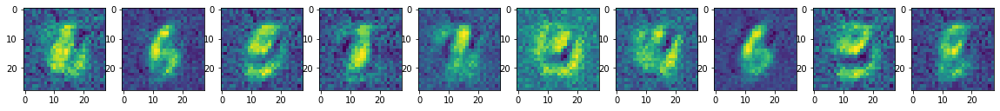

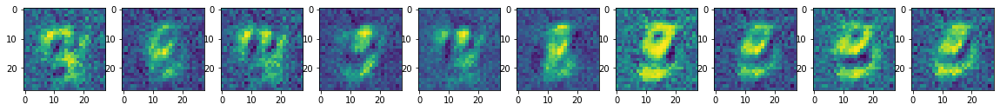


mean epoch 61 generator/discriminator loss: [606.20165985  10.55527044]



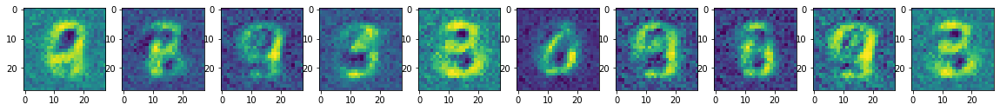

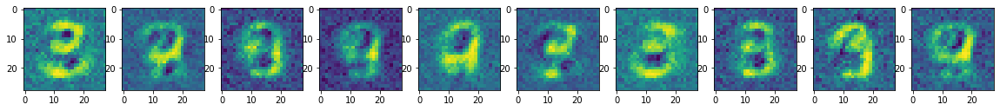

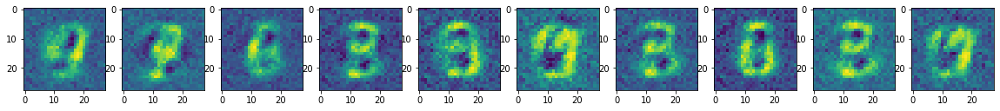


mean epoch 62 generator/discriminator loss: [574.98246429  11.51524078]



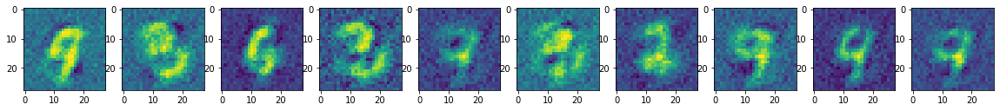

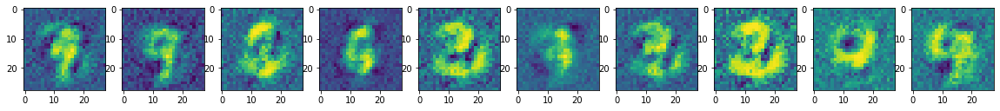

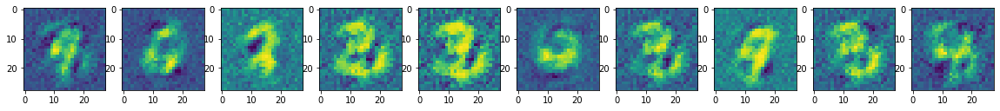


mean epoch 63 generator/discriminator loss: [583.31306091  10.79574365]



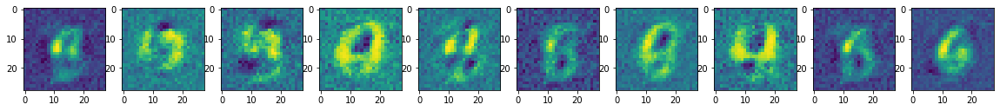

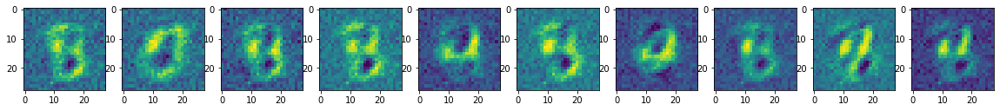

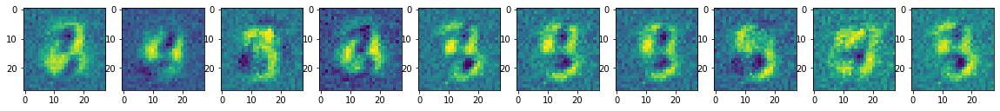


mean epoch 64 generator/discriminator loss: [551.5853183   11.26300302]



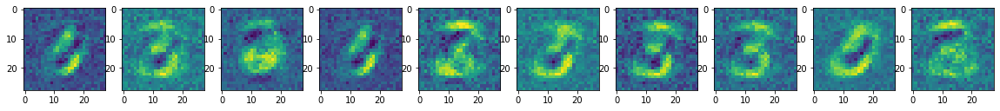

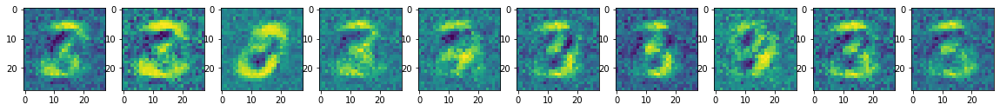

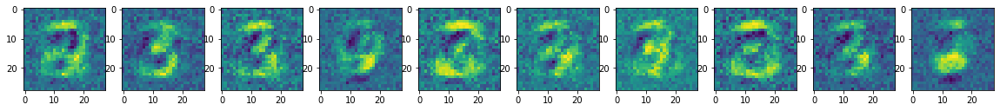


mean epoch 65 generator/discriminator loss: [691.92350281  10.84347095]



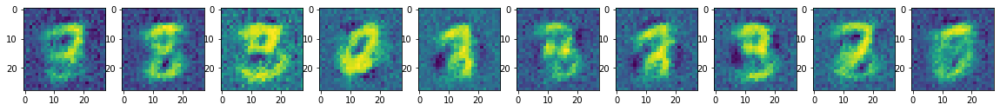

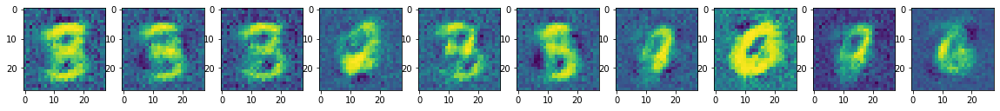

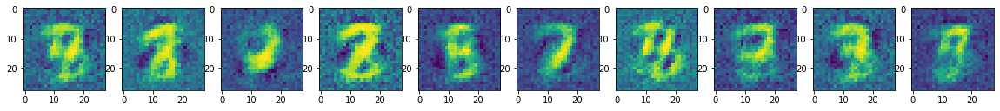


mean epoch 66 generator/discriminator loss: [582.44811493  10.21508455]



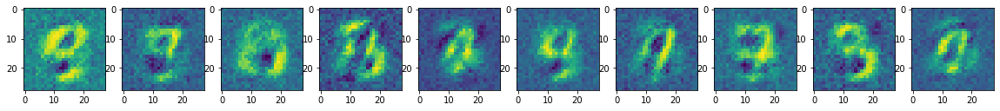

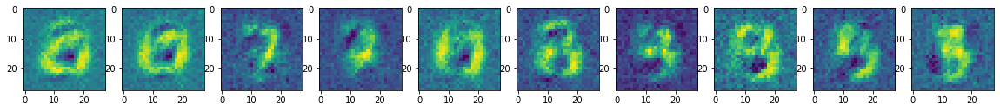

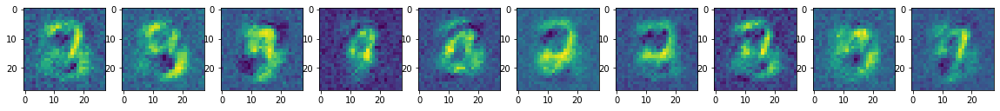


mean epoch 67 generator/discriminator loss: [529.35874207  10.54010275]



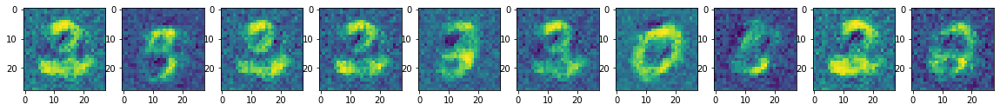

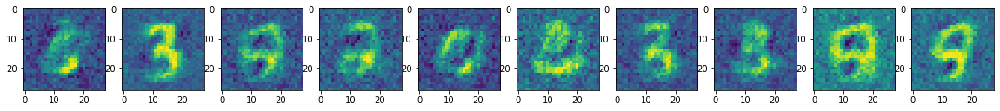

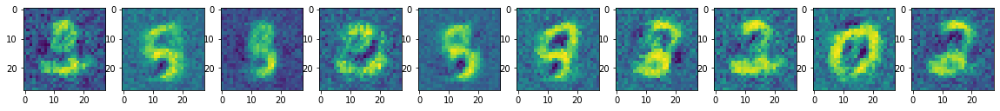


mean epoch 68 generator/discriminator loss: [636.9710675    9.75652689]



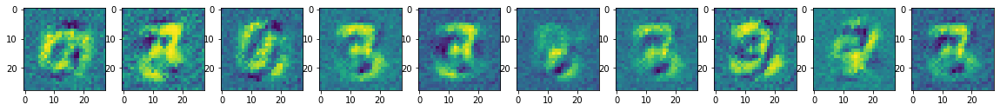

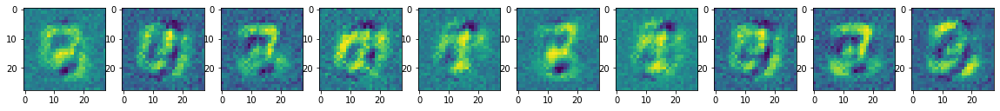

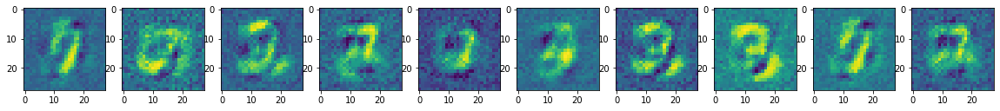


mean epoch 69 generator/discriminator loss: [620.82266724  10.46223804]



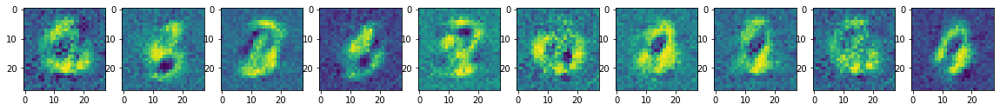

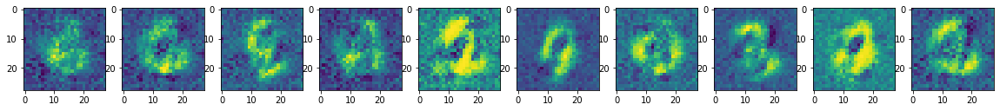

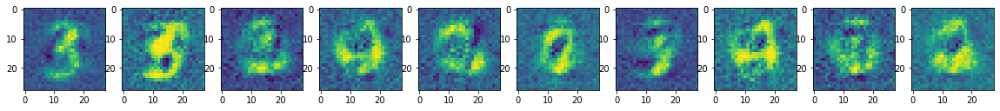


mean epoch 70 generator/discriminator loss: [626.25764954   9.12999193]



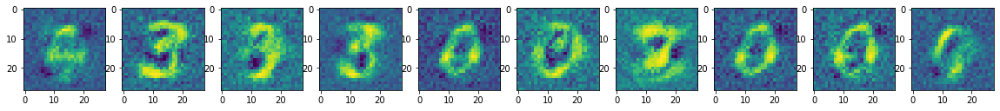

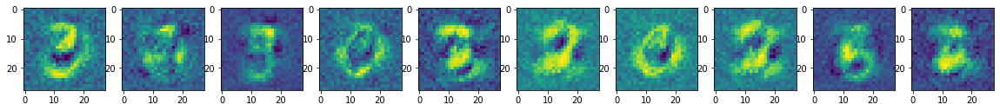

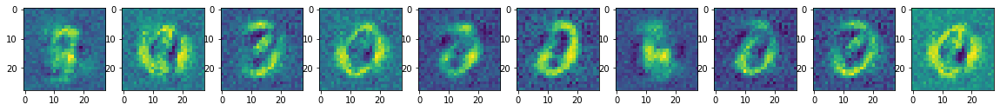


mean epoch 71 generator/discriminator loss: [640.2077652    9.15369935]



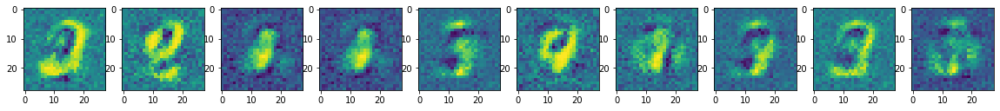

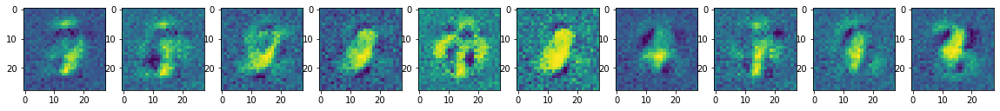

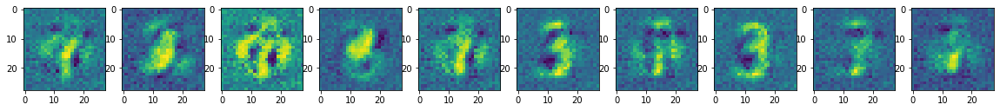


mean epoch 72 generator/discriminator loss: [675.52384216  12.5988768 ]



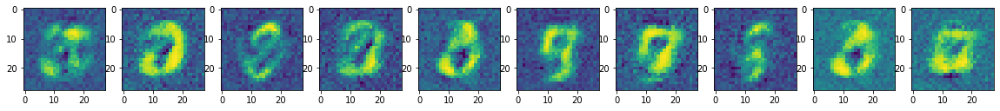

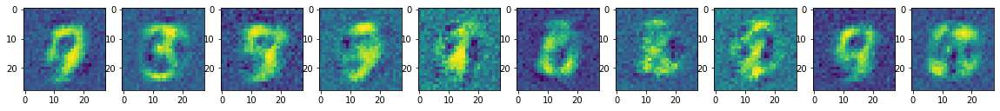

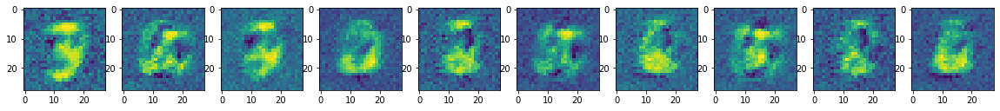


mean epoch 73 generator/discriminator loss: [650.73343811   9.29108372]



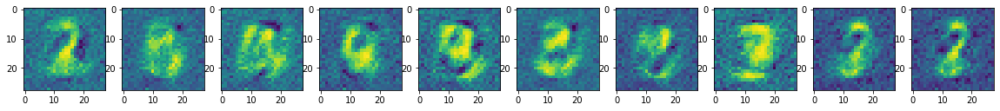

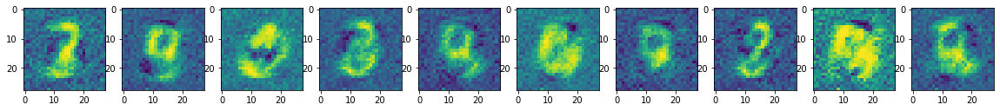

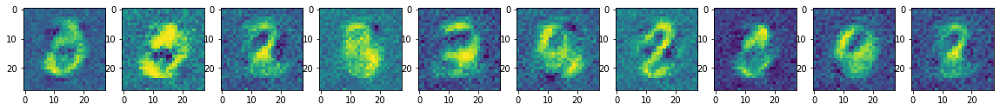


mean epoch 74 generator/discriminator loss: [602.47173645   8.73649153]



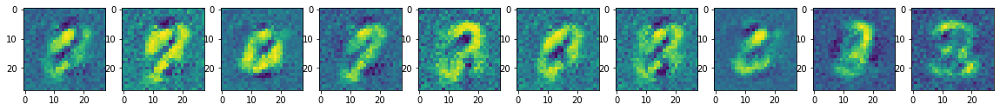

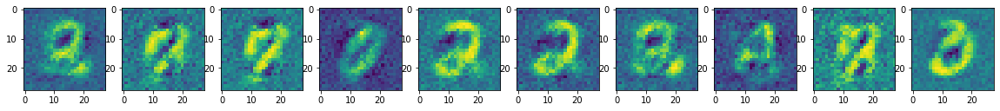

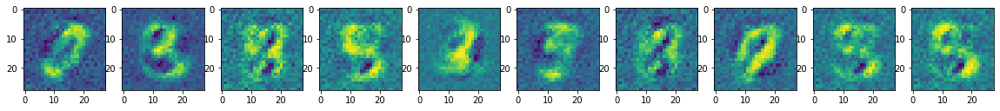


mean epoch 75 generator/discriminator loss: [642.02545044   9.61638947]



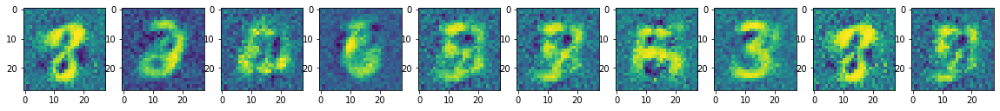

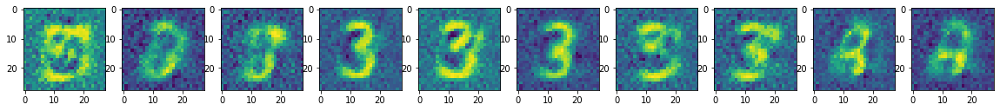

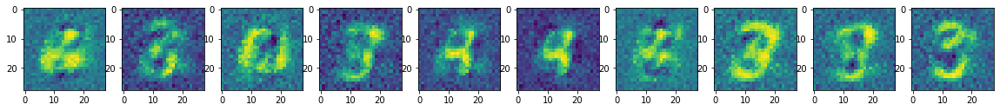


mean epoch 76 generator/discriminator loss: [670.79592102   9.64961687]



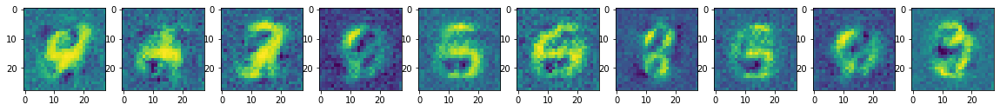

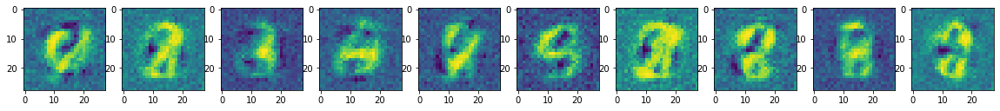

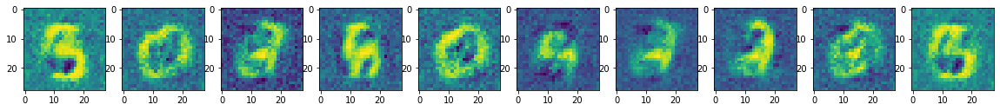


mean epoch 77 generator/discriminator loss: [615.59455261  11.30127543]



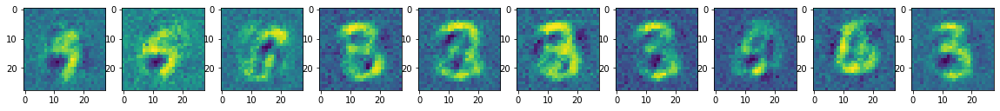

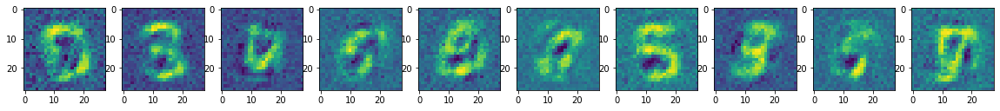

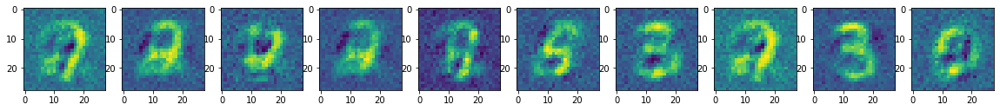


mean epoch 78 generator/discriminator loss: [656.62129761  10.70888721]



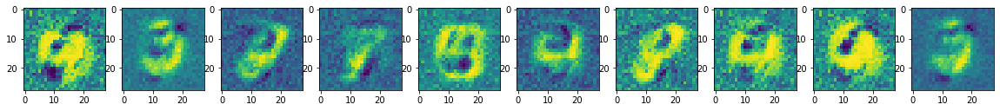

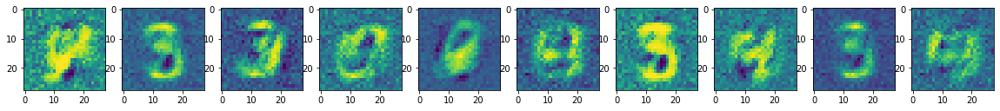

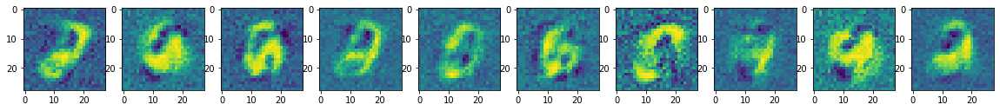


mean epoch 79 generator/discriminator loss: [646.76983734   9.29723809]



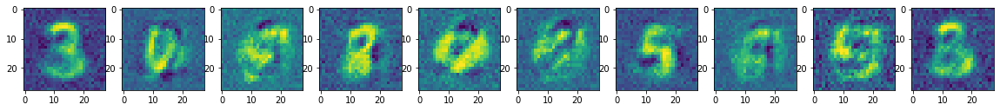

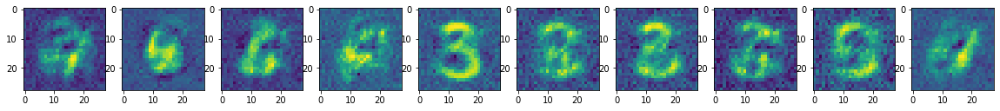

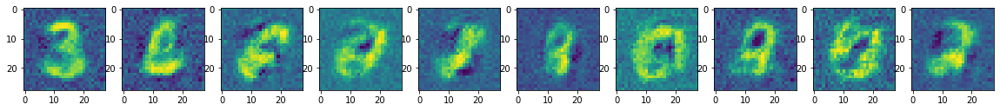


mean epoch 80 generator/discriminator loss: [616.741716     8.08246826]



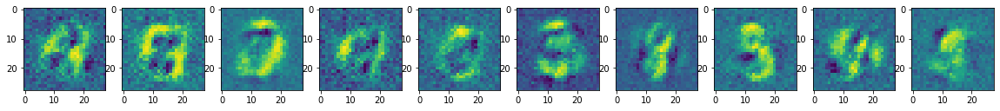

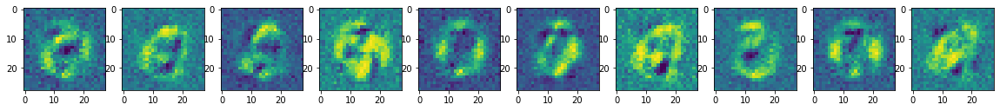

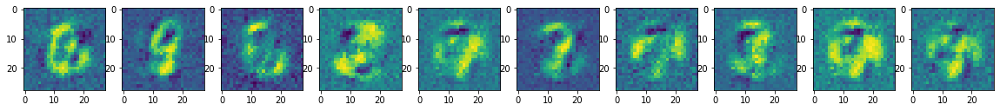


mean epoch 81 generator/discriminator loss: [619.98666077   9.64633311]



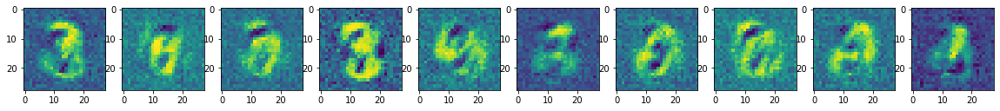

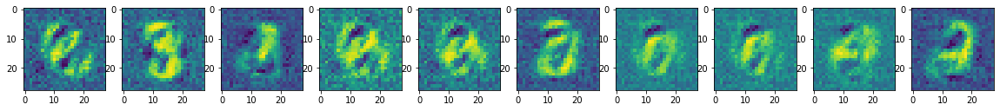

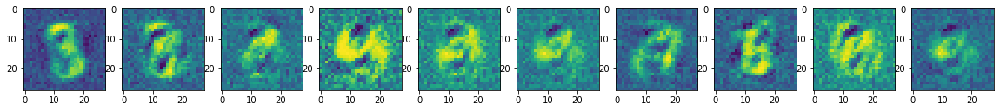


mean epoch 82 generator/discriminator loss: [725.35252808  10.2949927 ]



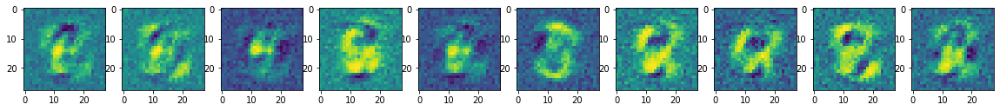

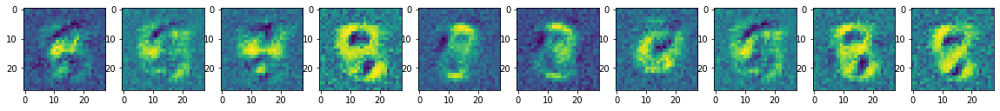

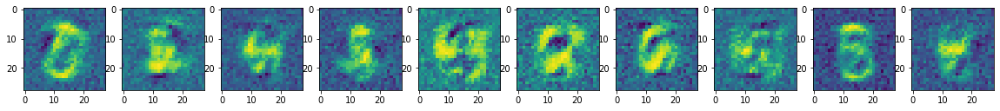


mean epoch 83 generator/discriminator loss: [672.39265808   9.64920327]



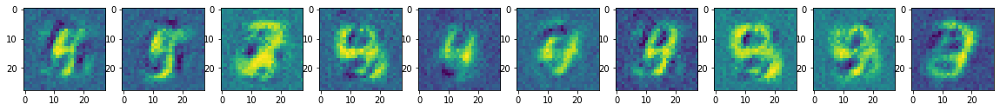

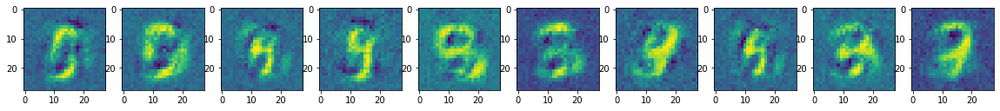

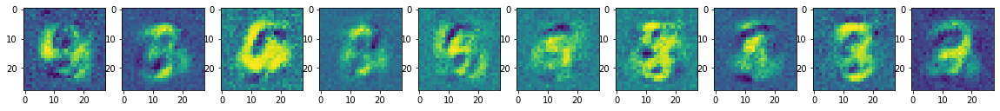


mean epoch 84 generator/discriminator loss: [617.01814636   9.04778805]



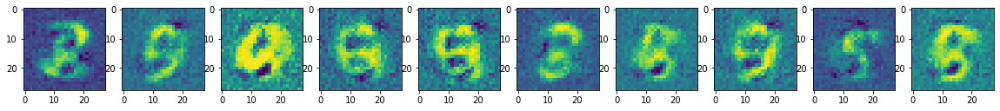

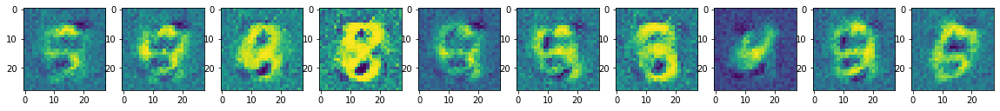

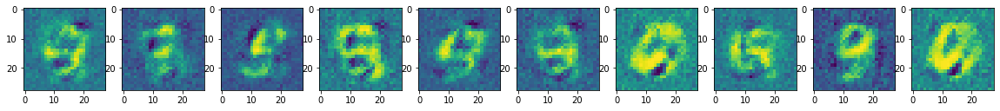


mean epoch 85 generator/discriminator loss: [633.19725067   8.77061993]



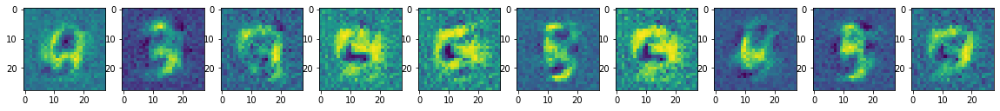

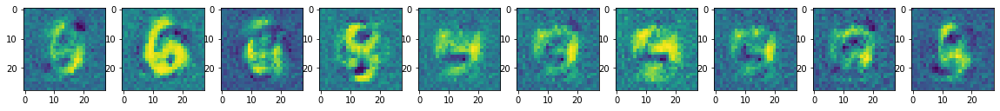

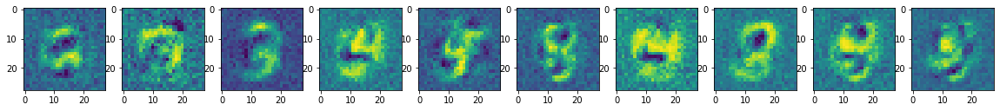


mean epoch 86 generator/discriminator loss: [670.50787964  12.87429762]



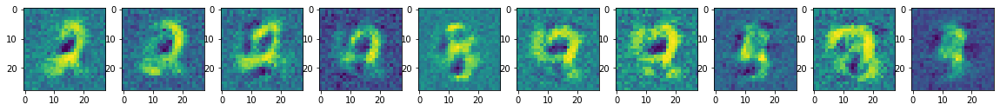

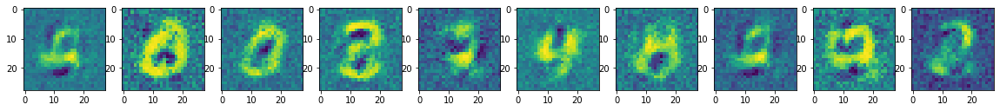

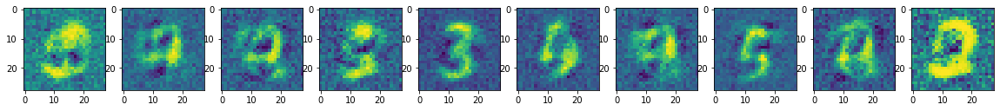


mean epoch 87 generator/discriminator loss: [651.08033752  11.25978443]



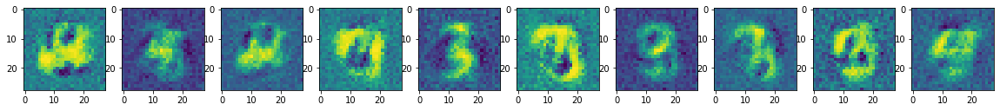

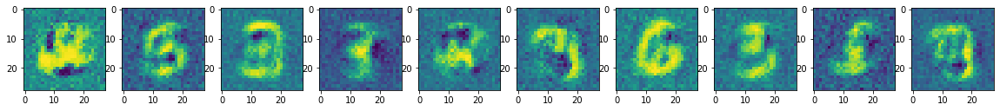

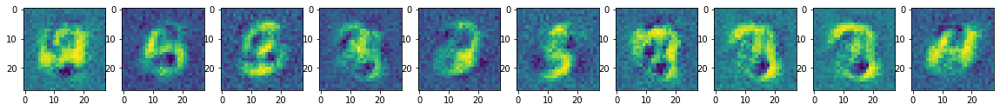


mean epoch 88 generator/discriminator loss: [576.76605835  10.42141293]



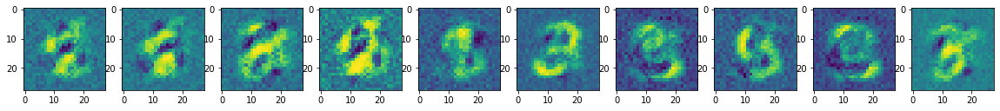

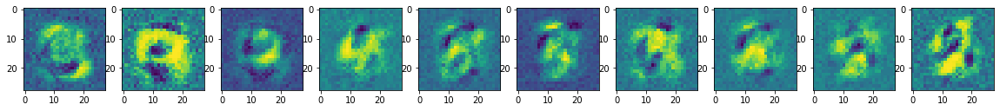

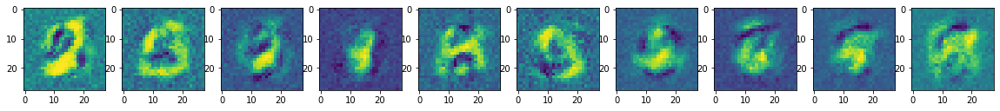


mean epoch 89 generator/discriminator loss: [623.66811584   9.36143037]



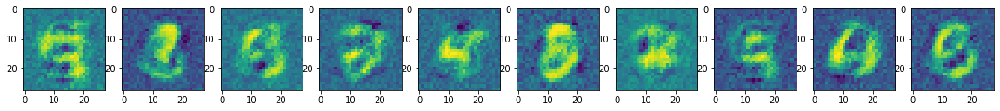

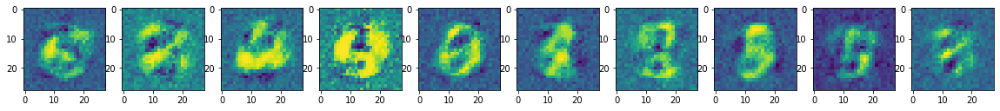

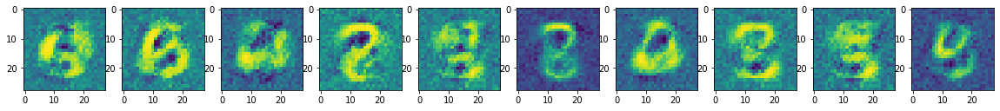


mean epoch 90 generator/discriminator loss: [642.44878418  11.59687866]



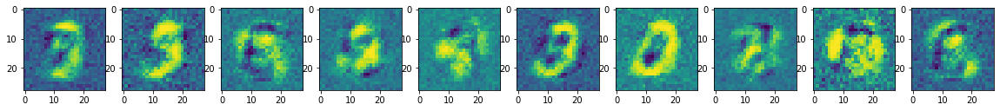

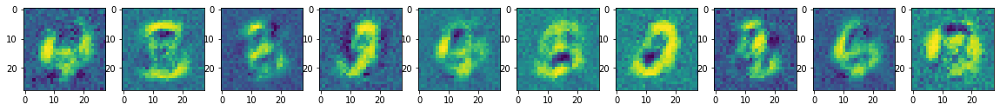

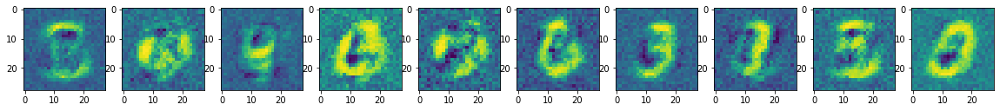


mean epoch 91 generator/discriminator loss: [613.15221222  12.76325145]



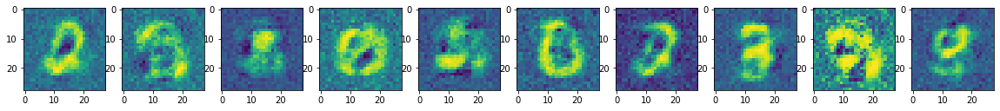

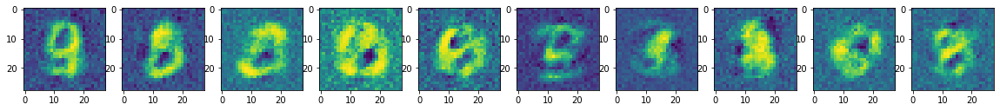

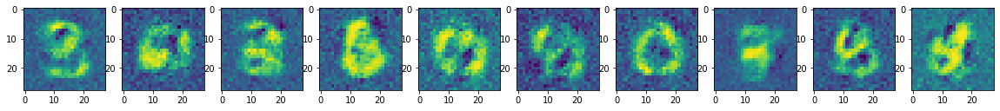


mean epoch 92 generator/discriminator loss: [595.06747894   9.58555674]



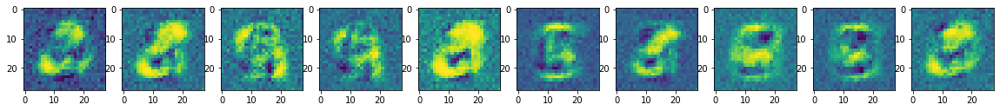

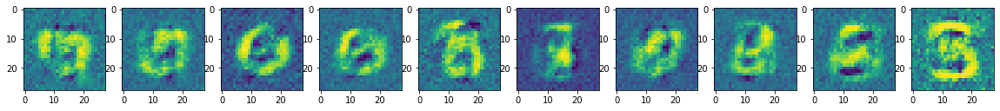

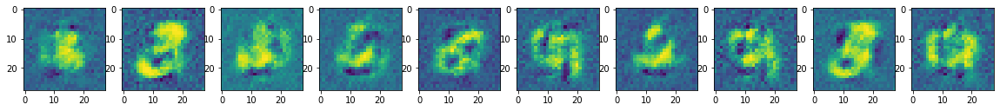


mean epoch 93 generator/discriminator loss: [609.2412793    9.41744504]



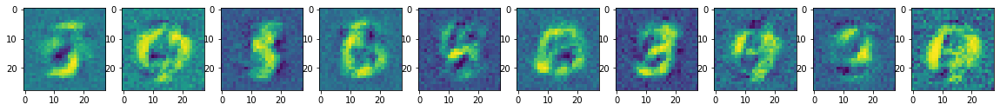

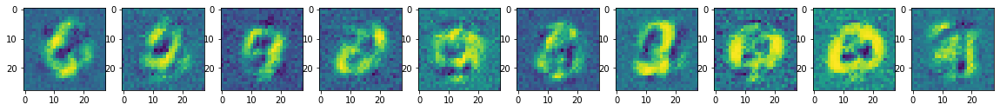

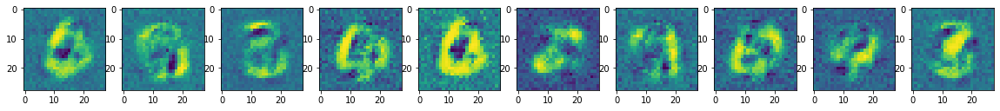


mean epoch 94 generator/discriminator loss: [646.21068604  10.06213291]



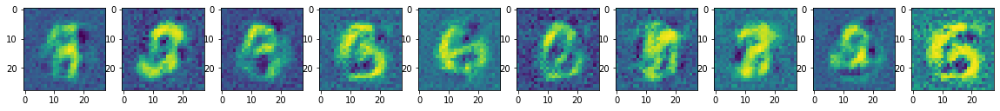

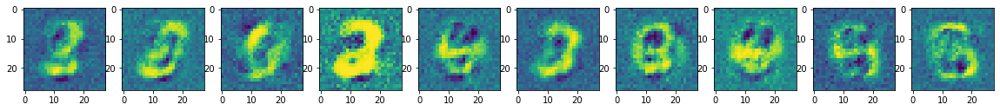

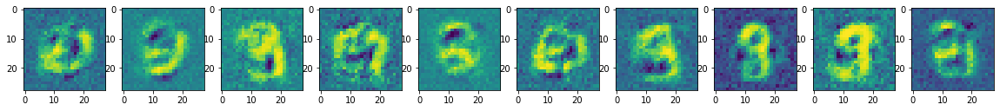


mean epoch 95 generator/discriminator loss: [672.18916626  10.59248587]



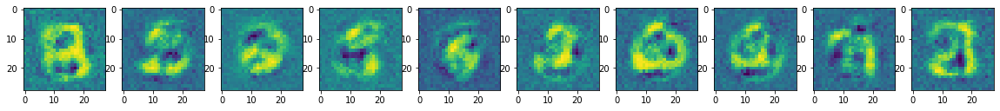

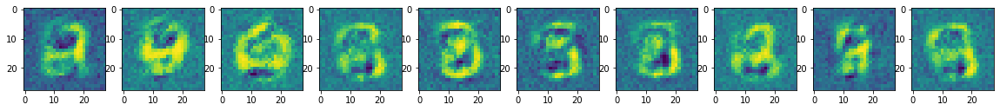

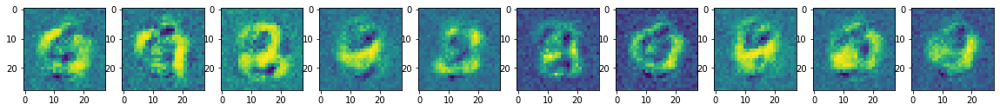


mean epoch 96 generator/discriminator loss: [635.99903137   8.4141986 ]



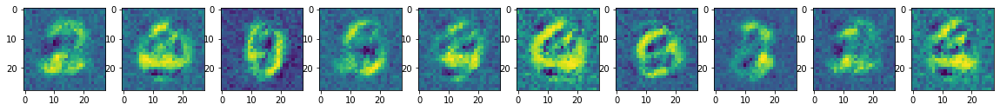

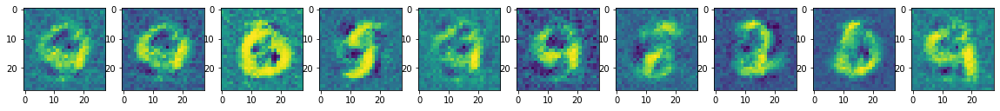

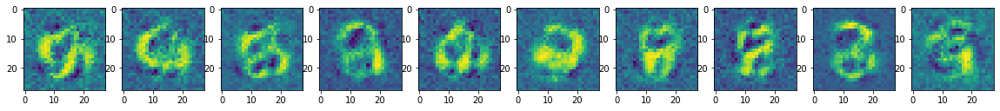


mean epoch 97 generator/discriminator loss: [659.55099915   9.1821159 ]



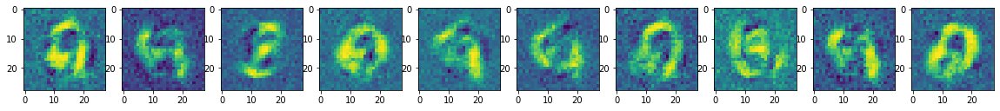

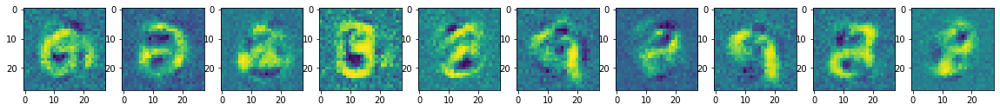

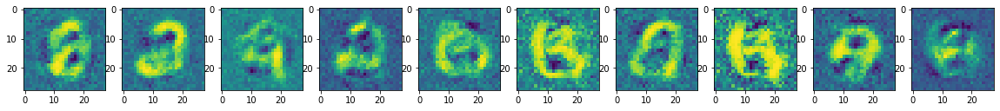


mean epoch 98 generator/discriminator loss: [671.60748474  10.27954049]



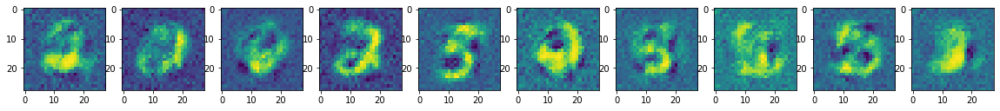

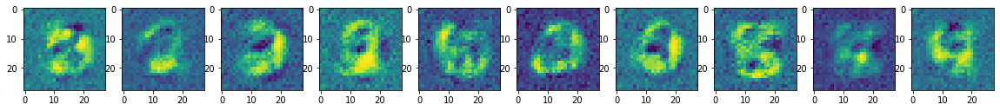

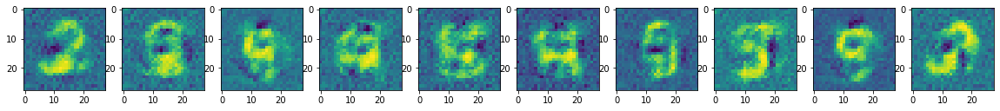


mean epoch 99 generator/discriminator loss: [656.33977661   9.52502825]



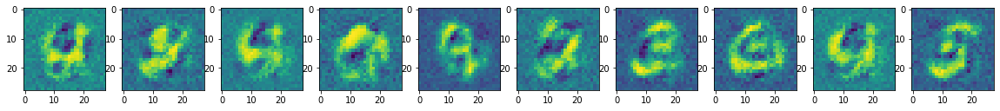

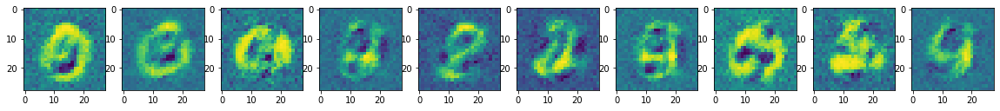

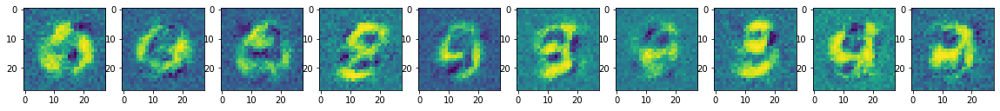


mean epoch 100 generator/discriminator loss: [628.57239685  10.30581882]



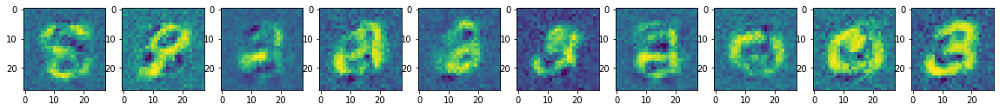

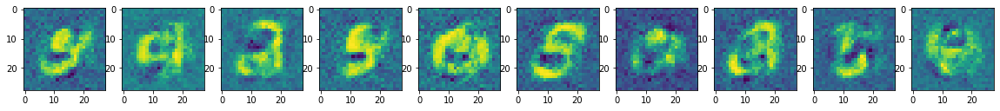

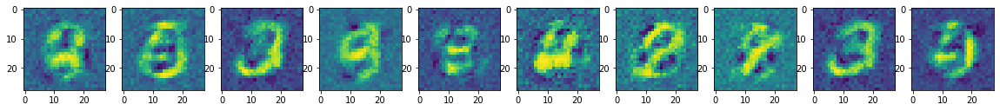


mean epoch 101 generator/discriminator loss: [652.18709717   9.81304335]



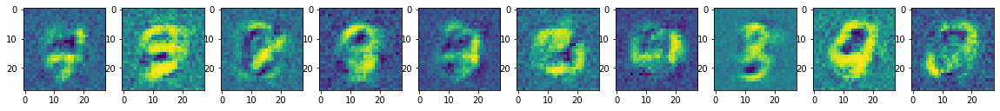

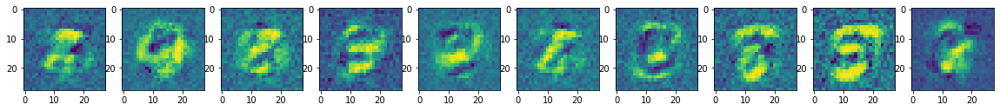

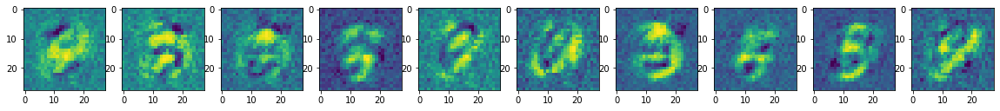


mean epoch 102 generator/discriminator loss: [716.15564697  11.61829034]



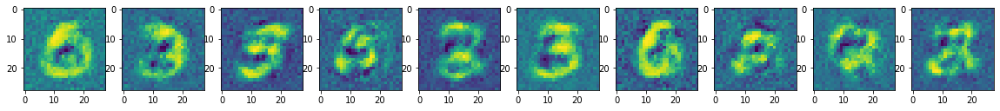

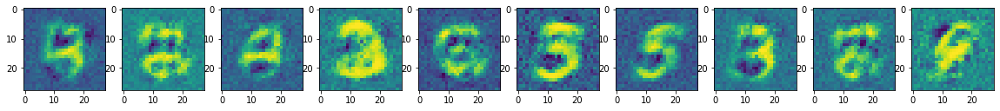

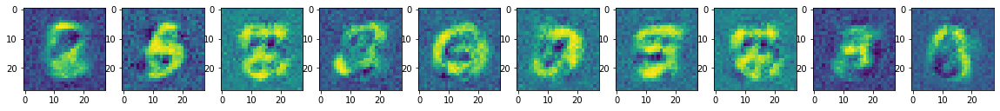


mean epoch 103 generator/discriminator loss: [637.35861969   8.45427313]



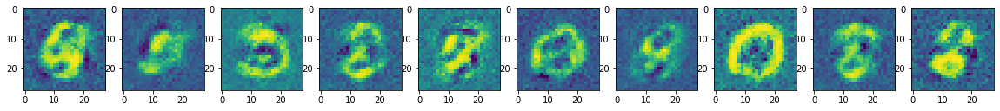

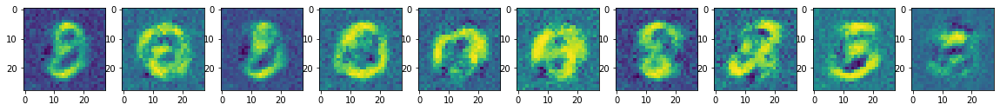

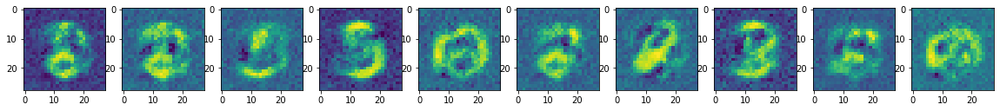


mean epoch 104 generator/discriminator loss: [656.04526855   8.71543179]



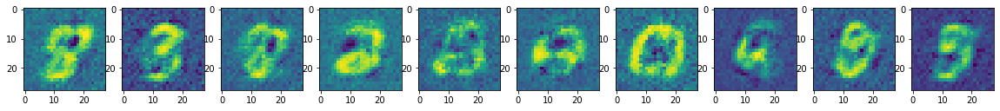

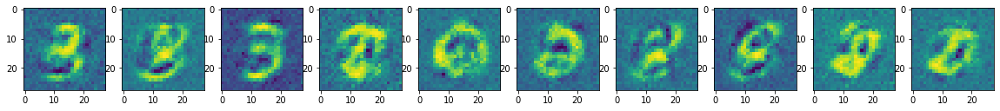

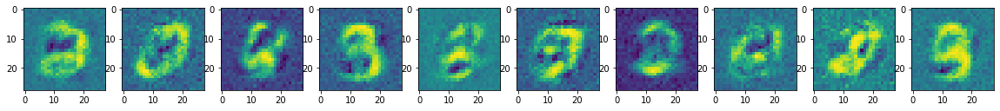


mean epoch 105 generator/discriminator loss: [608.95363525   9.14405979]



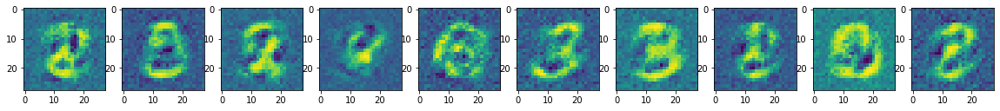

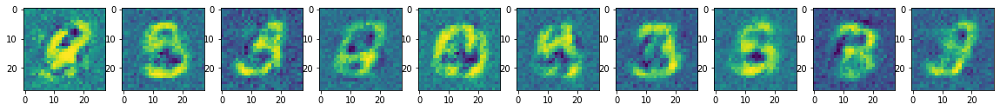

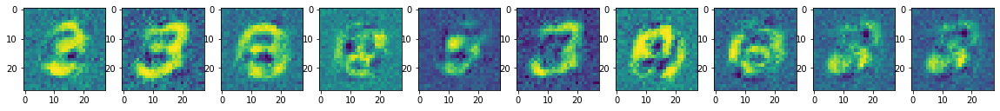


mean epoch 106 generator/discriminator loss: [711.32504639   9.69204315]



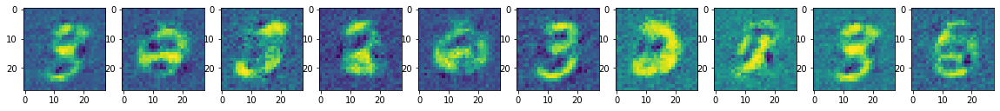

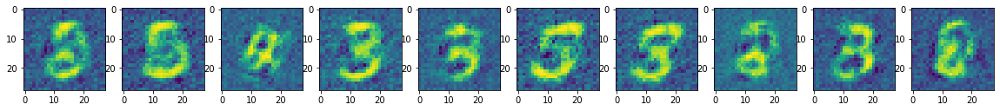

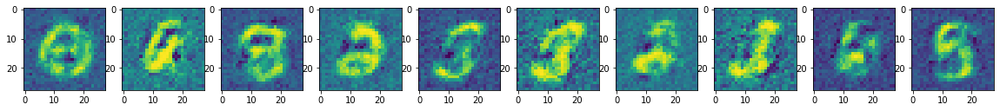


mean epoch 107 generator/discriminator loss: [664.09267578   8.97886884]



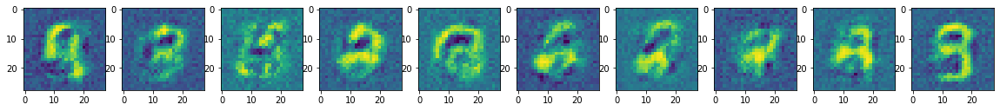

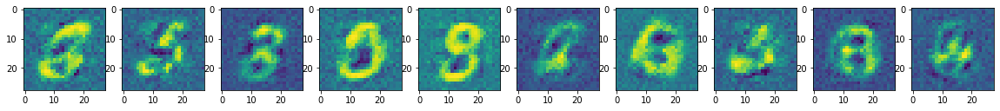

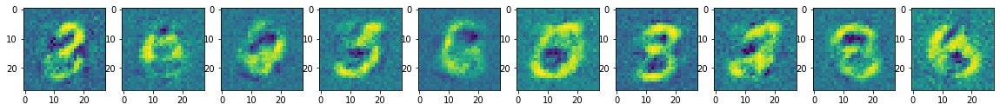


mean epoch 108 generator/discriminator loss: [662.66281281   9.37292892]



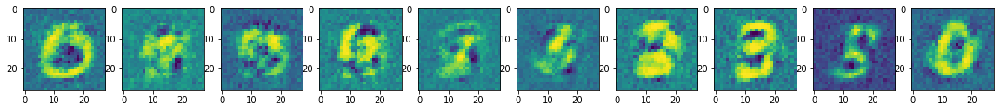

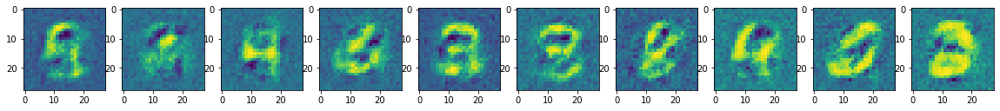

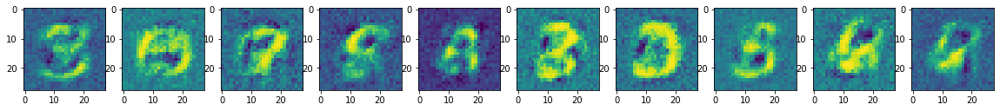


mean epoch 109 generator/discriminator loss: [670.84699524  10.83576934]



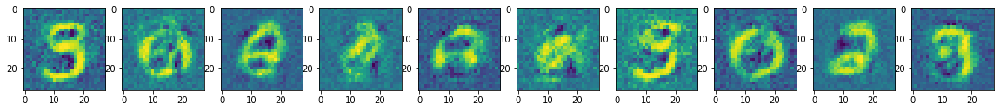

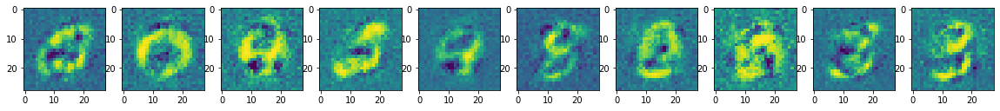

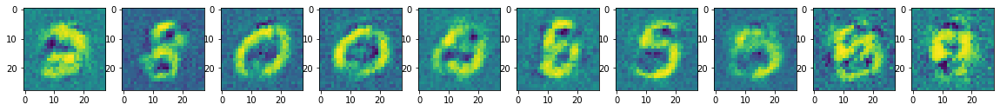


mean epoch 110 generator/discriminator loss: [676.94948181  11.46096018]



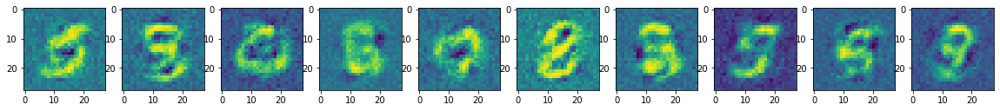

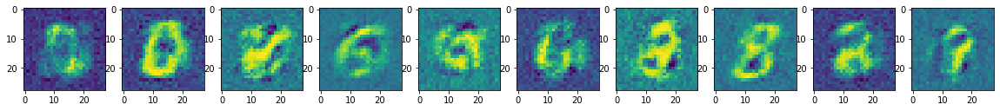

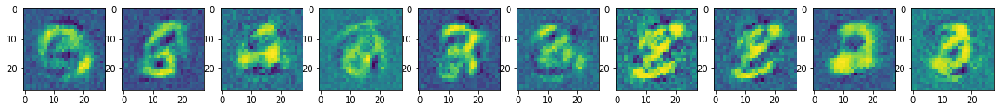


mean epoch 111 generator/discriminator loss: [683.15791504  11.2009397 ]



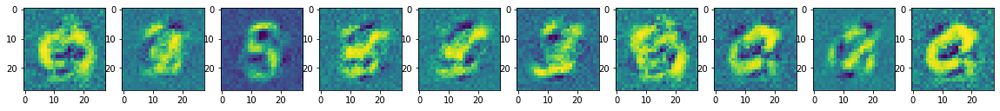

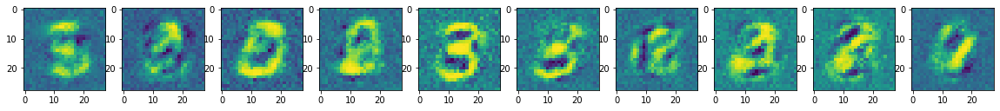

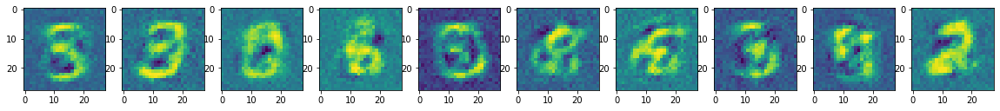


mean epoch 112 generator/discriminator loss: [643.25124573   9.37530828]



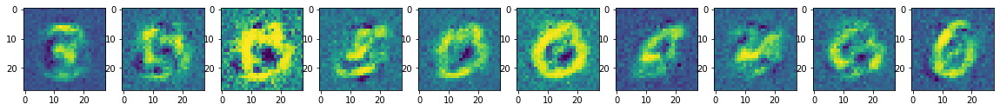

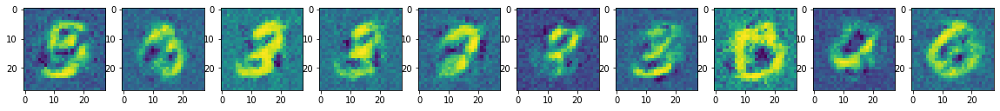

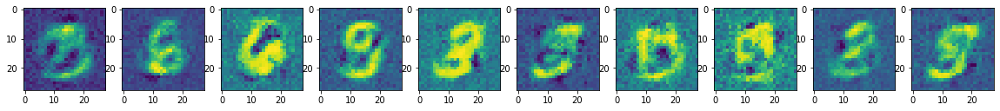


mean epoch 113 generator/discriminator loss: [662.78253296   9.56438525]



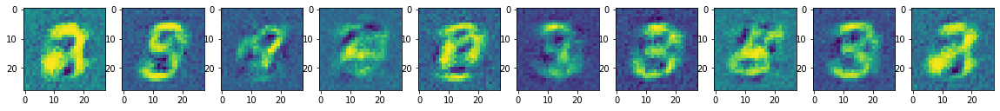

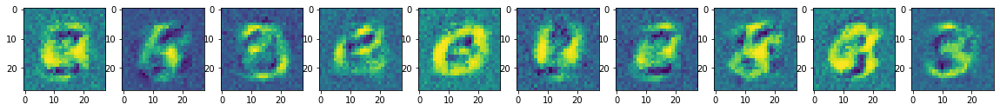

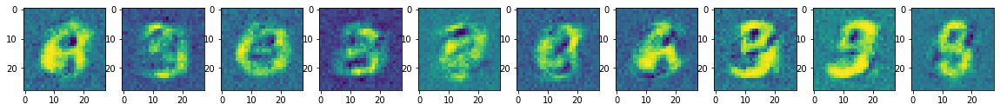


mean epoch 114 generator/discriminator loss: [676.574375    9.0506337]



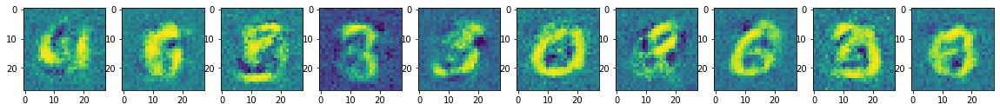

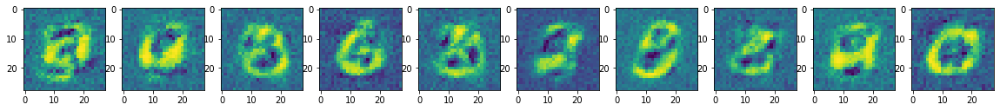

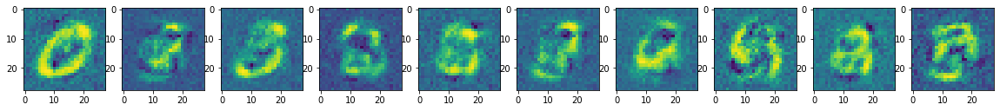


mean epoch 115 generator/discriminator loss: [634.71019165  10.44297244]



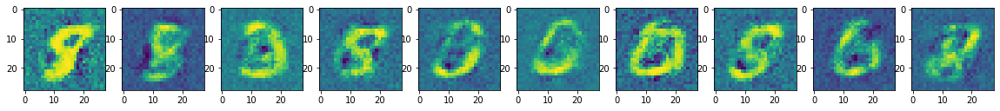

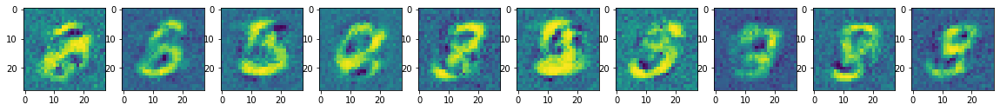

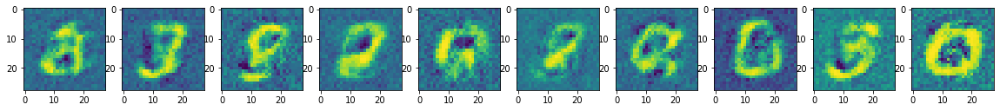


mean epoch 116 generator/discriminator loss: [670.59811035  10.11660485]



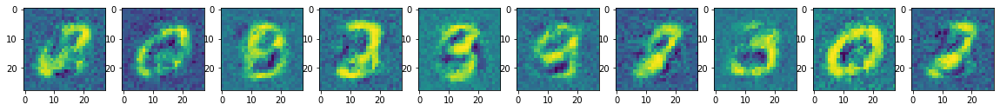

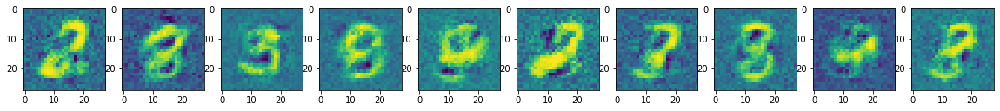

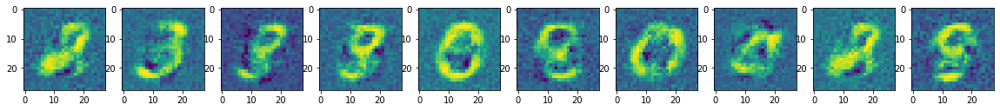


mean epoch 117 generator/discriminator loss: [693.95525696  11.40946039]



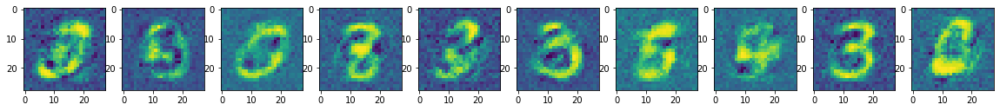

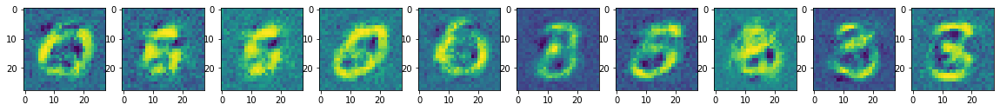

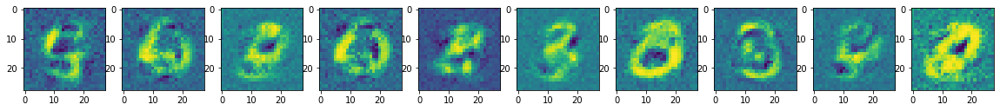


mean epoch 118 generator/discriminator loss: [664.07158691   9.07908614]



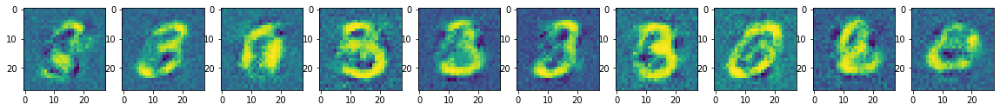

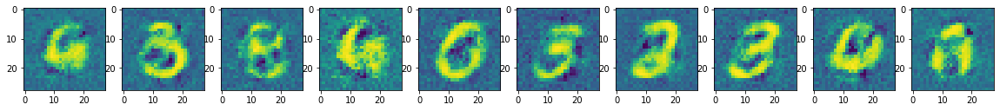

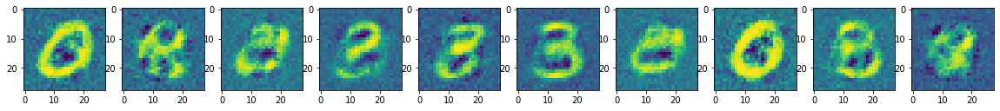


mean epoch 119 generator/discriminator loss: [664.69442139  10.00558215]



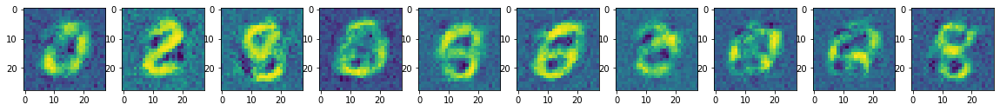

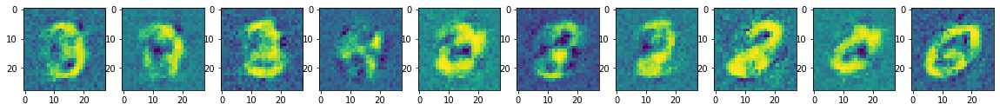

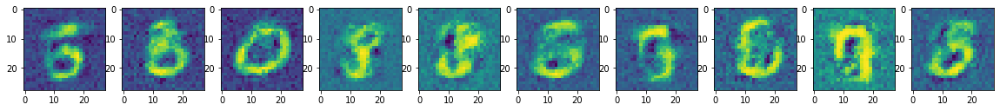


mean epoch 120 generator/discriminator loss: [678.38839539   9.44552128]



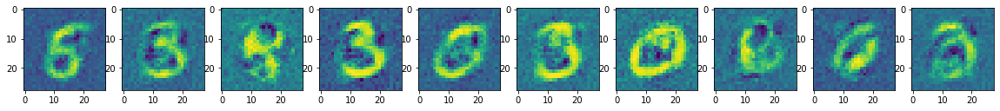

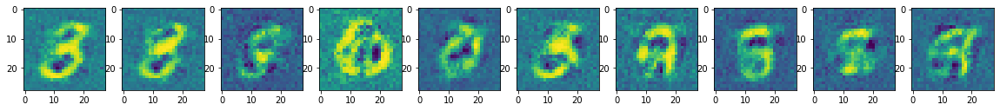

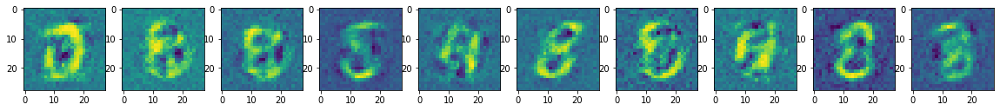


mean epoch 121 generator/discriminator loss: [691.89083374  11.35246754]



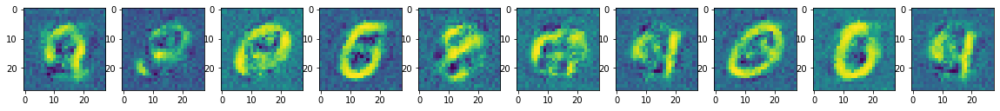

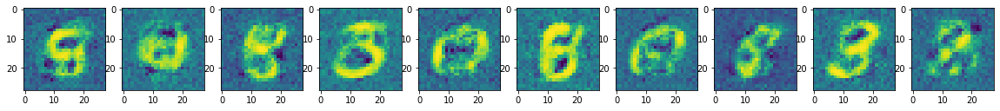

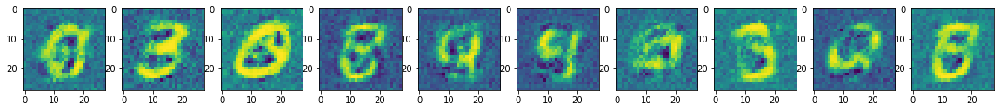


mean epoch 122 generator/discriminator loss: [709.94970886  10.28551498]



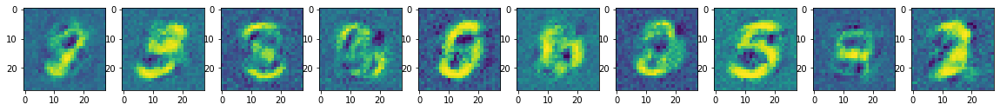

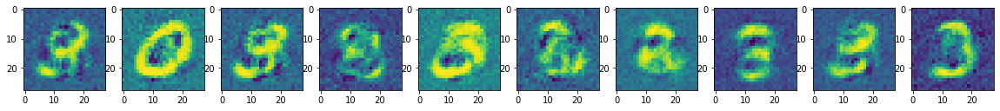

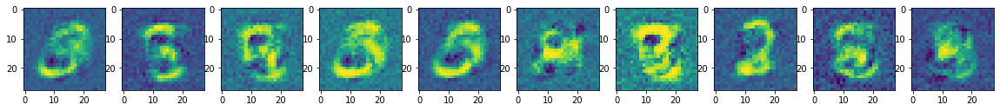


mean epoch 123 generator/discriminator loss: [700.62693054   8.88432497]



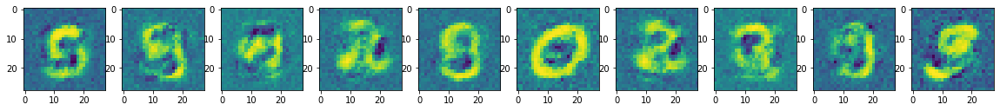

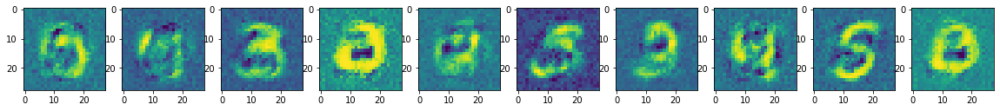

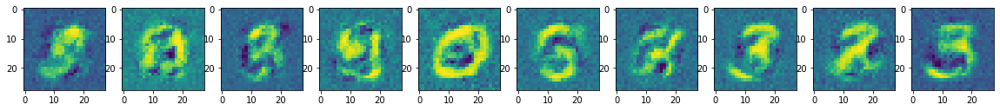


mean epoch 124 generator/discriminator loss: [656.73266113   9.68279356]



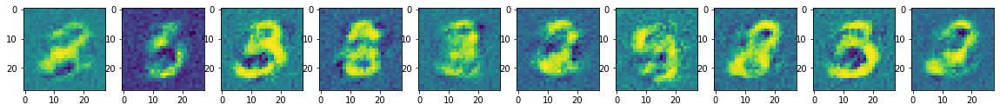

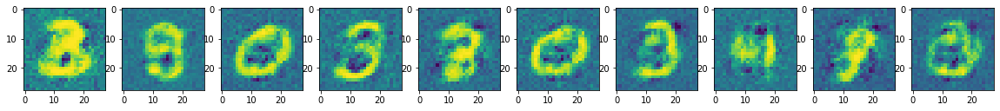

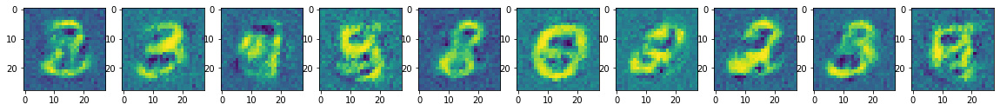


mean epoch 125 generator/discriminator loss: [695.74767578  11.5783271 ]



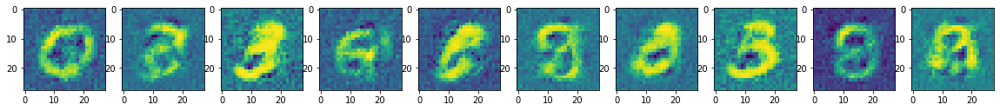

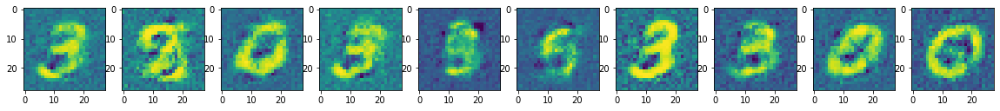

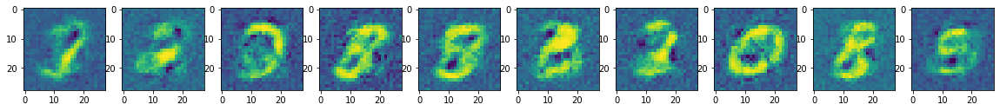


mean epoch 126 generator/discriminator loss: [666.95213104  10.98124566]



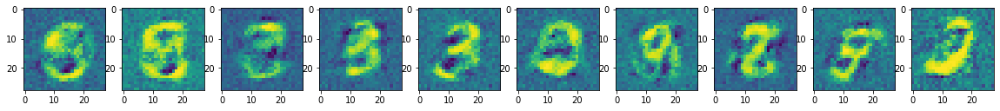

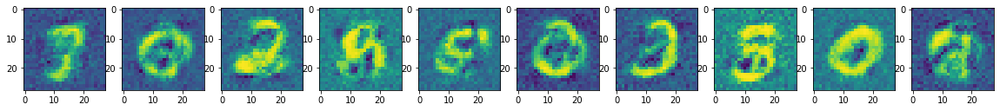

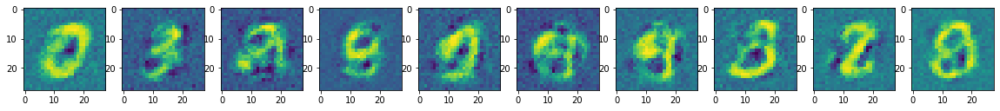


mean epoch 127 generator/discriminator loss: [680.36732056   9.38253143]



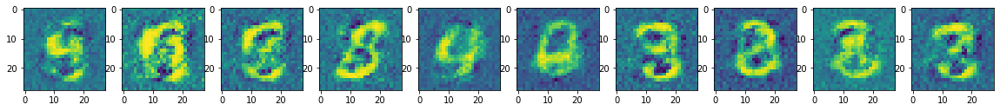

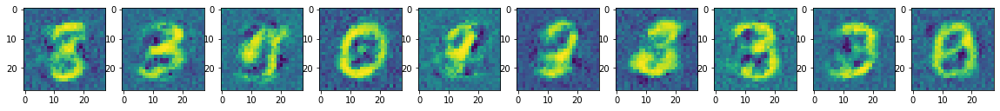

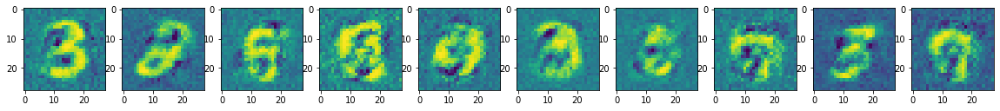


mean epoch 128 generator/discriminator loss: [691.91931641  10.59172735]



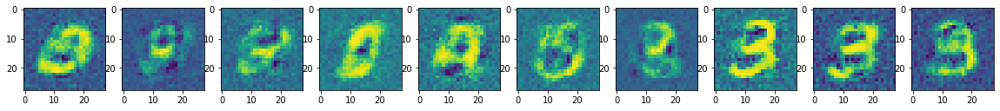

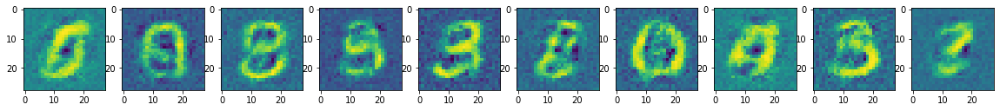

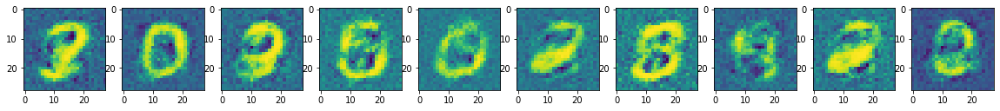


mean epoch 129 generator/discriminator loss: [676.88685974  11.30295045]



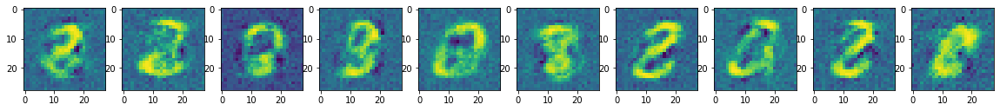

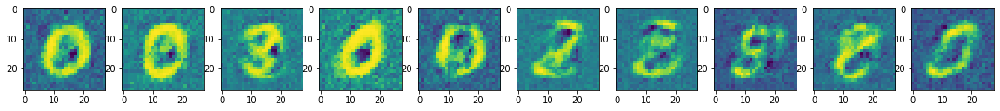

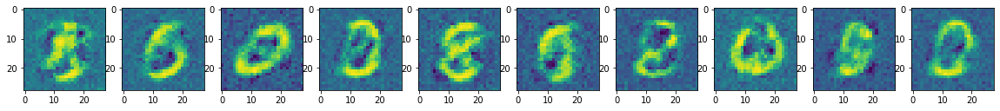


mean epoch 130 generator/discriminator loss: [671.21454895   8.72390709]



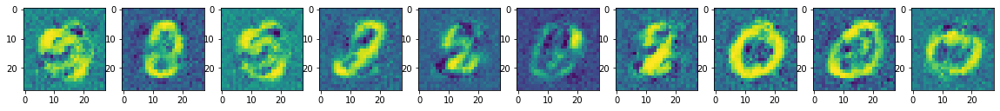

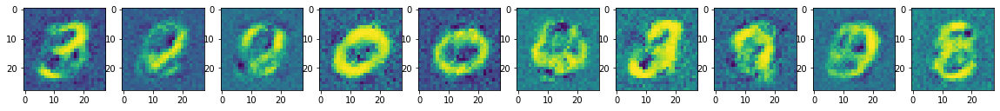

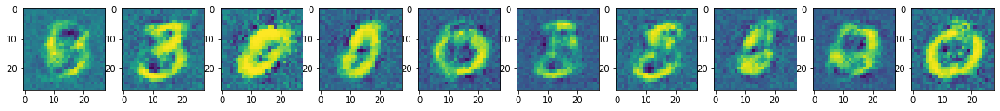


mean epoch 131 generator/discriminator loss: [666.51831909   9.60428067]



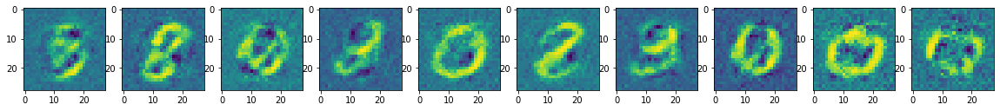

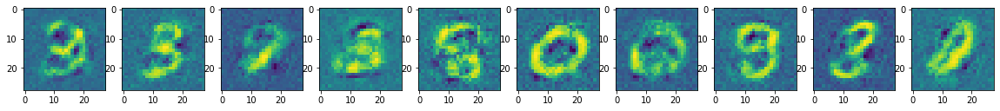

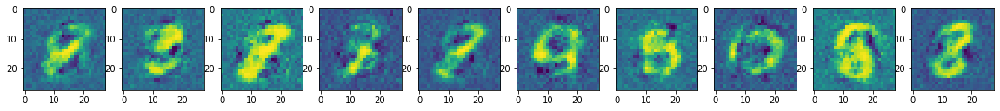


mean epoch 132 generator/discriminator loss: [671.93384949  10.42064257]



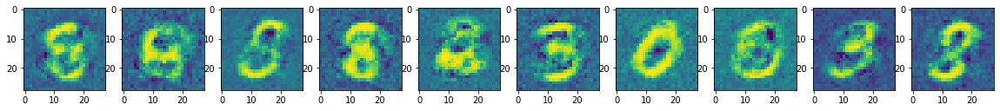

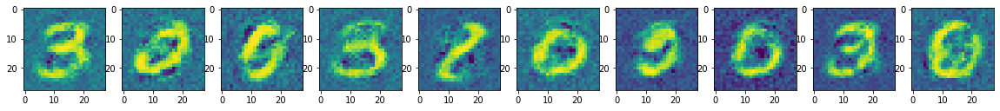

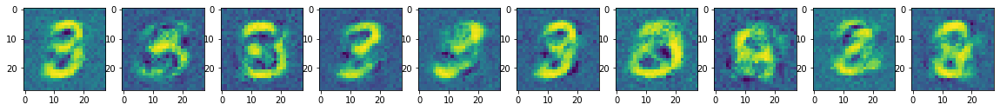


mean epoch 133 generator/discriminator loss: [700.33529663  11.88898621]



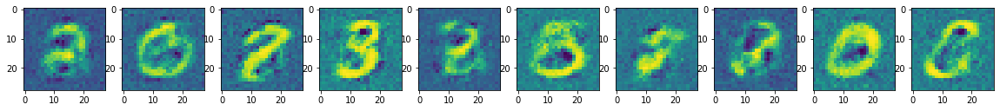

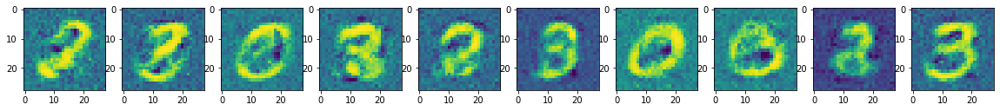

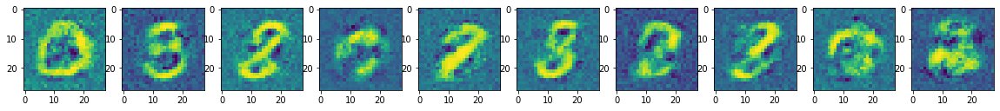


mean epoch 134 generator/discriminator loss: [645.76017822   9.15874944]



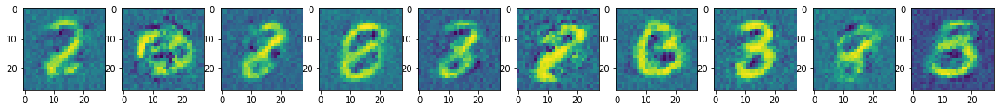

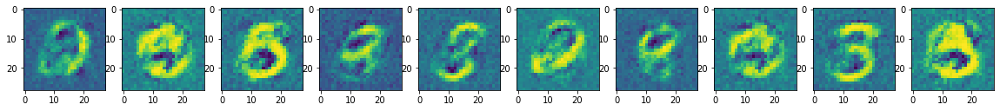

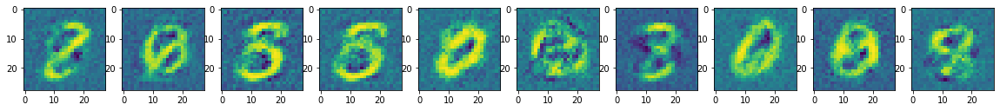


mean epoch 135 generator/discriminator loss: [685.30079529  10.43161707]



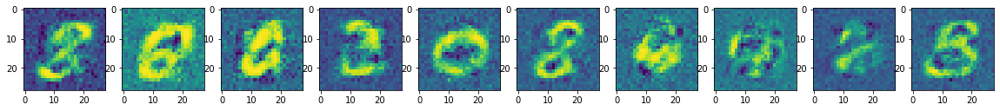

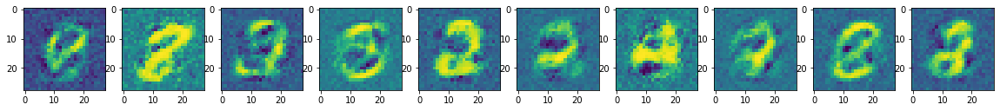

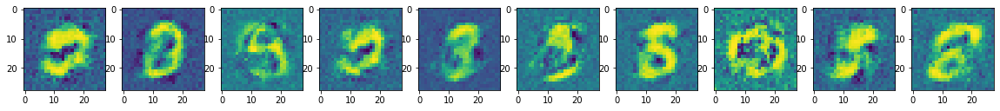


mean epoch 136 generator/discriminator loss: [675.80206787  12.51555279]



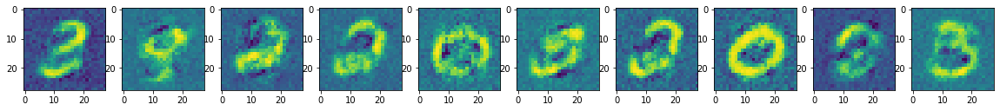

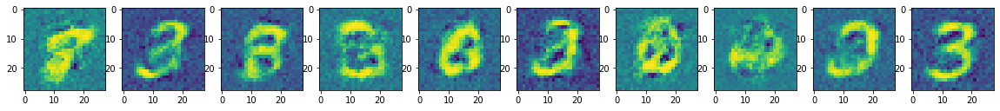

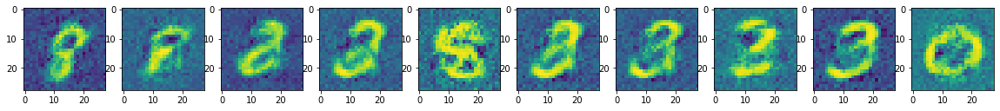


mean epoch 137 generator/discriminator loss: [633.10423706  10.80708986]



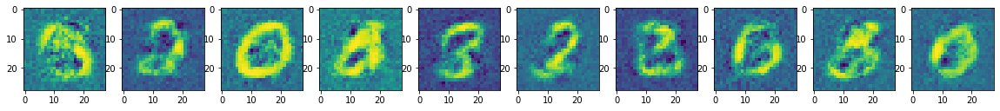

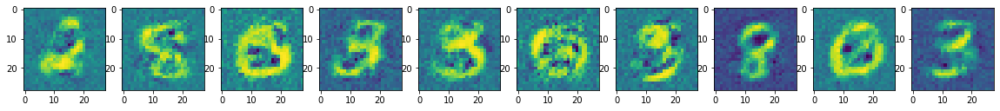

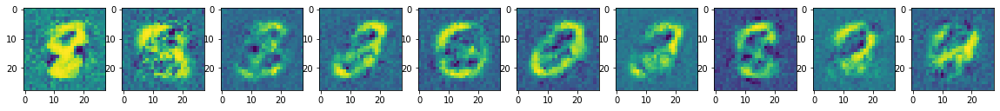


mean epoch 138 generator/discriminator loss: [652.58312347  13.44992536]



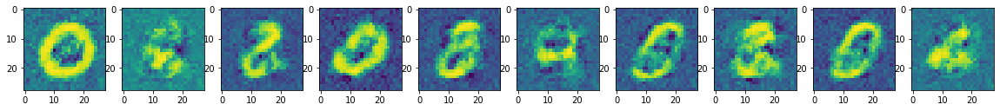

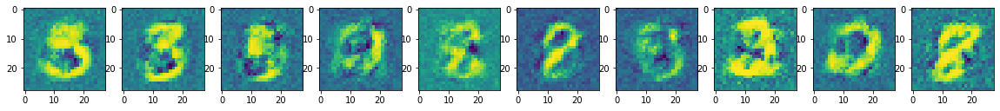

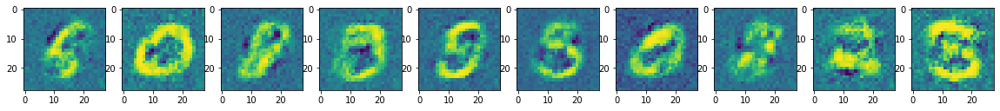


mean epoch 139 generator/discriminator loss: [632.87487885  11.53394464]



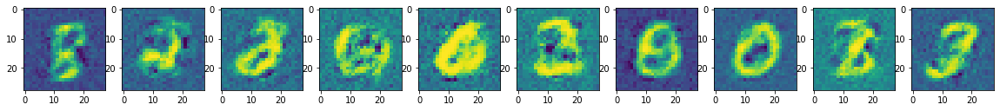

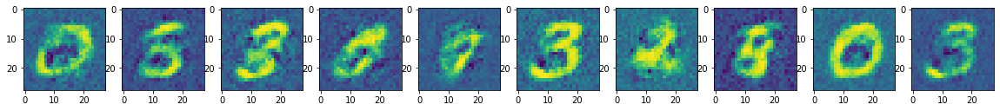

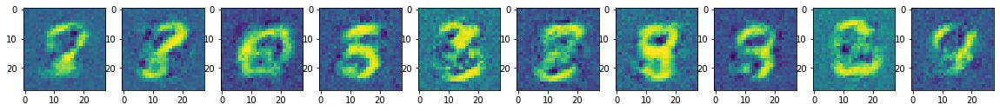


mean epoch 140 generator/discriminator loss: [636.00833557  10.80045011]



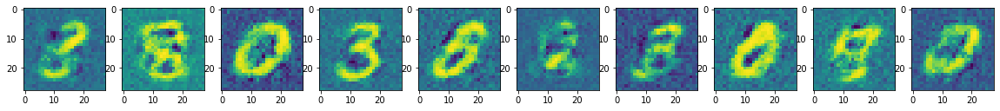

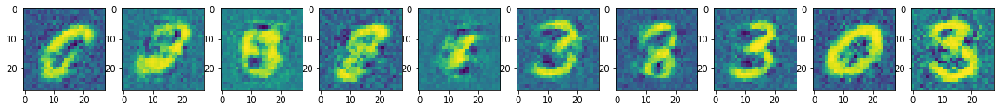

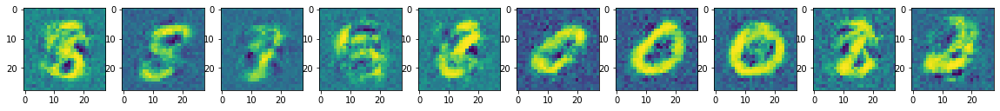


mean epoch 141 generator/discriminator loss: [658.53849457  10.76175424]



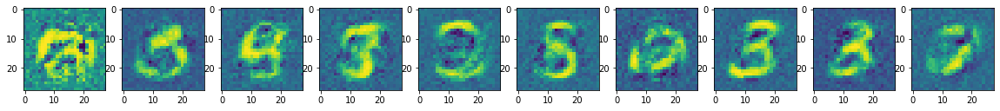

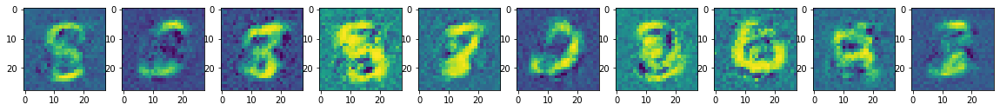

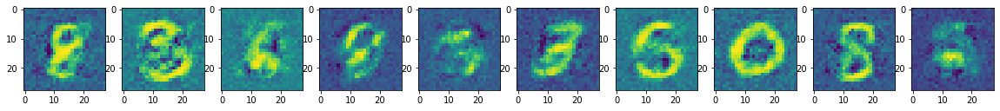


mean epoch 142 generator/discriminator loss: [653.83188232   9.52923709]



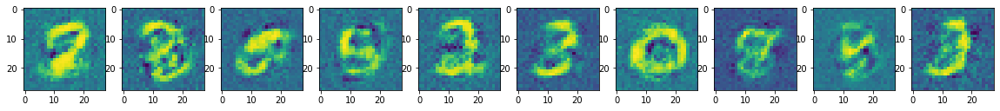

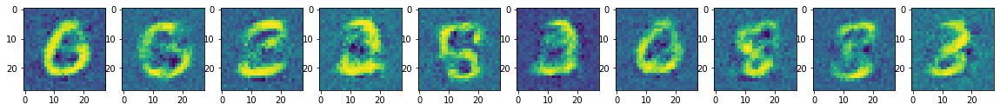

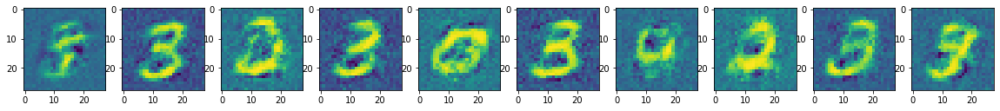


mean epoch 143 generator/discriminator loss: [686.06164642  12.03216895]



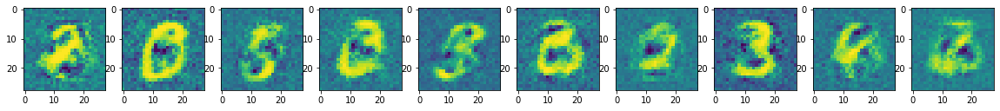

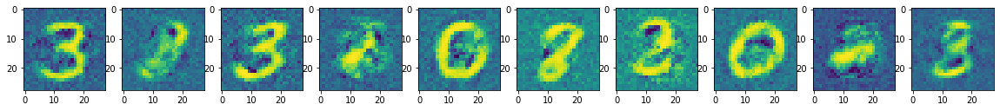

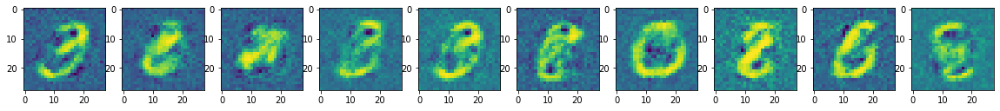


mean epoch 144 generator/discriminator loss: [660.74766052  11.27922865]



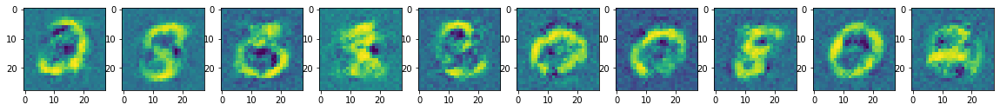

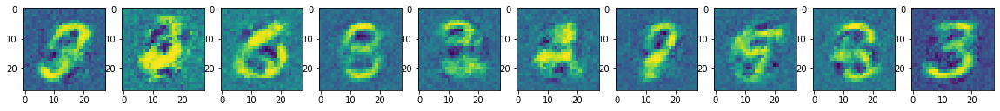

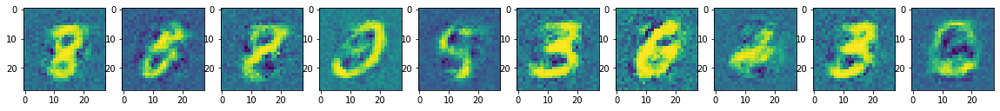


mean epoch 145 generator/discriminator loss: [649.48837738  10.22167242]



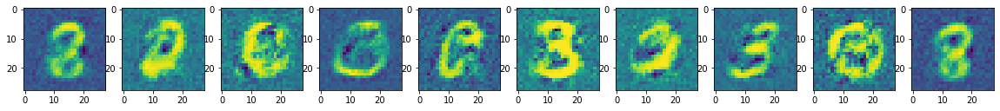

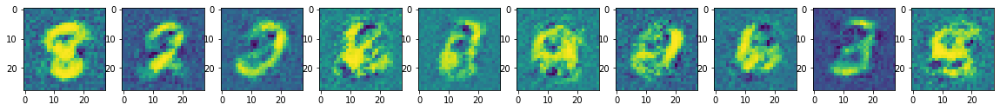

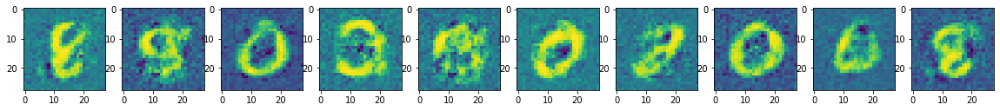


mean epoch 146 generator/discriminator loss: [664.09566406  11.04103447]



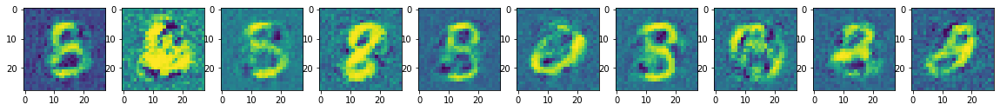

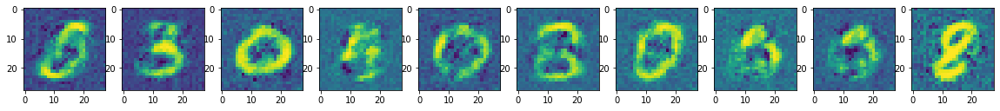

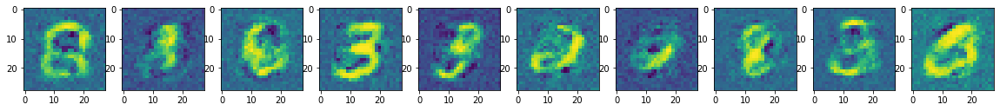


mean epoch 147 generator/discriminator loss: [675.1317041   11.71318256]



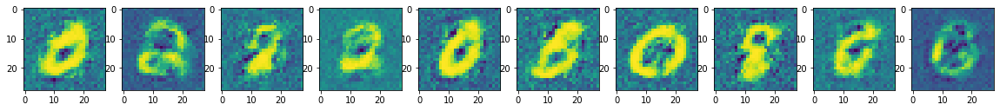

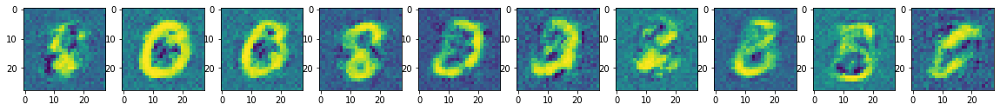

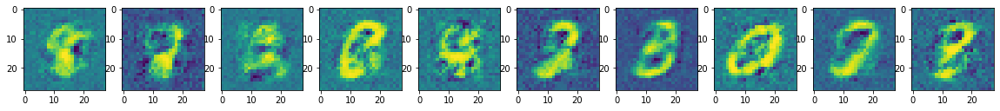


mean epoch 148 generator/discriminator loss: [672.87403503  12.13048972]



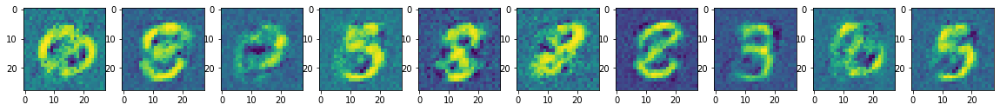

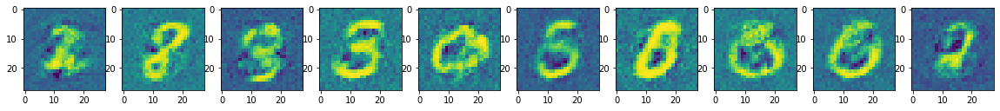

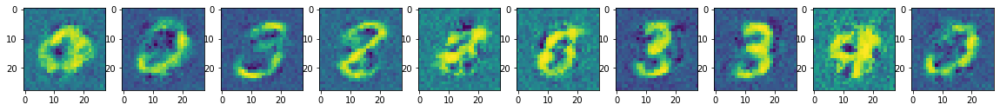


mean epoch 149 generator/discriminator loss: [631.55387024  12.70925482]



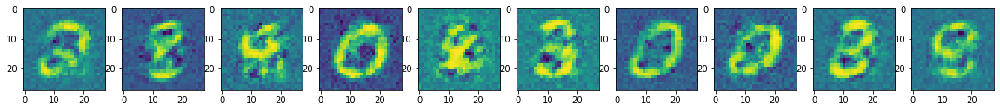

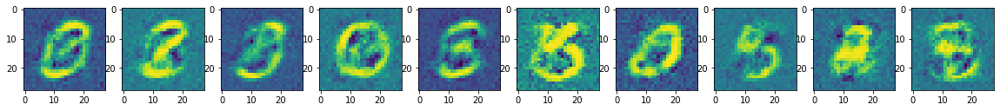

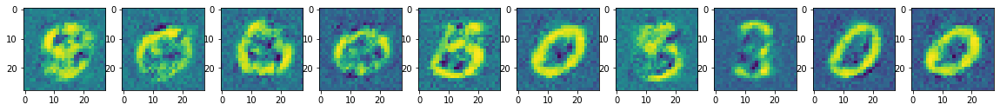


mean epoch 150 generator/discriminator loss: [626.68916687  11.38594255]



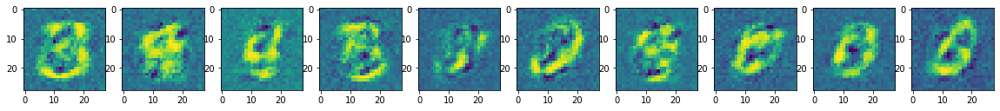

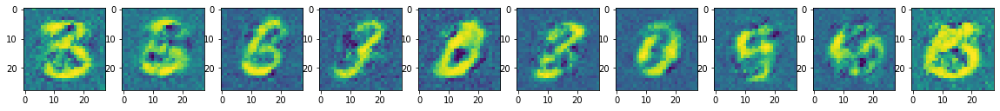

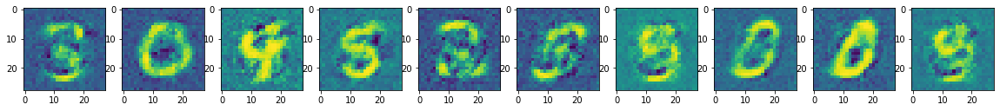


mean epoch 151 generator/discriminator loss: [638.59193298  12.45610729]



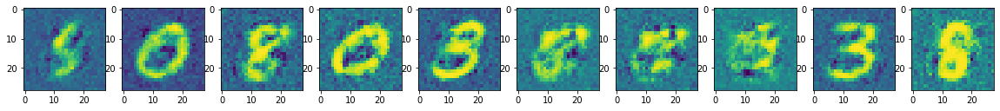

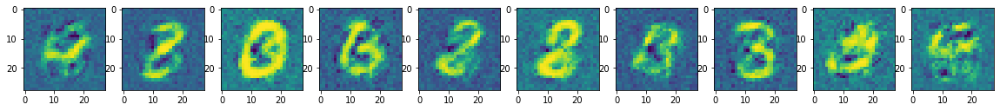

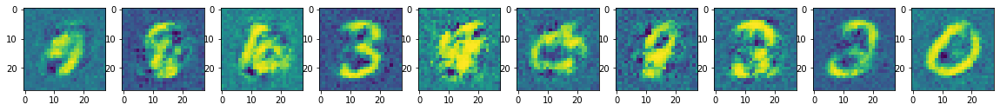


mean epoch 152 generator/discriminator loss: [661.44227234  10.30509044]



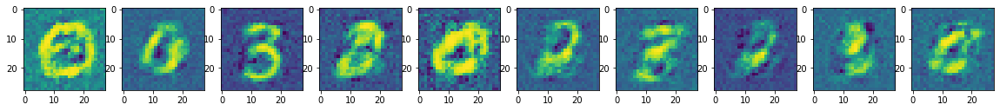

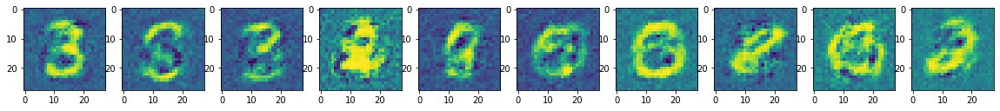

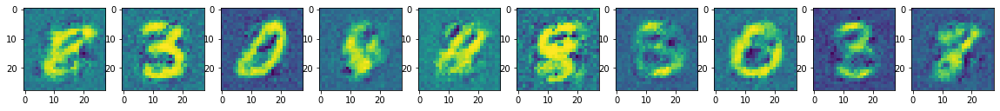


mean epoch 153 generator/discriminator loss: [666.76013     11.93366994]



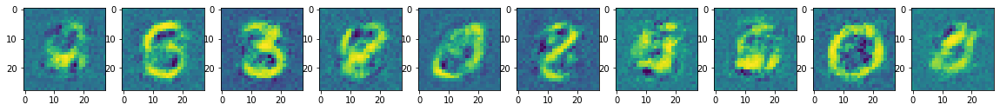

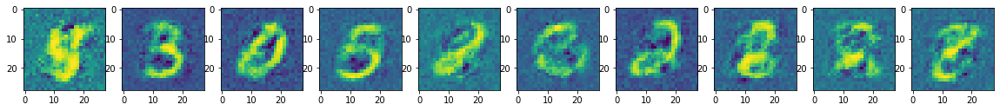

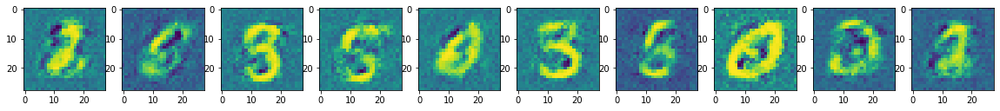


mean epoch 154 generator/discriminator loss: [611.72298279  10.84949334]



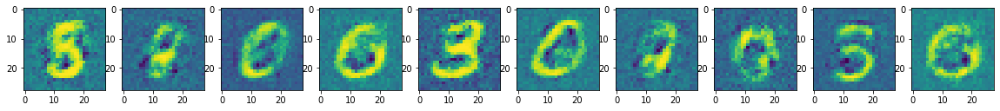

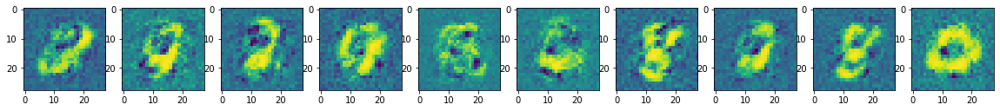

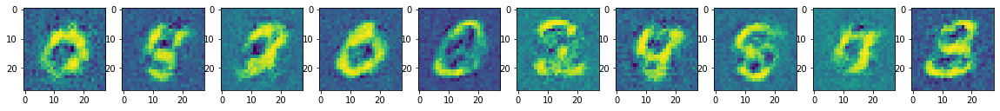


mean epoch 155 generator/discriminator loss: [669.29600342  11.19763781]



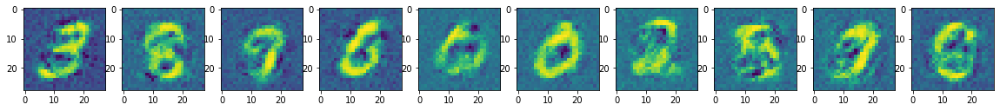

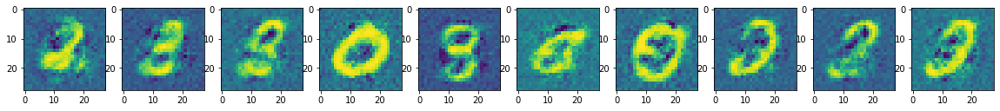

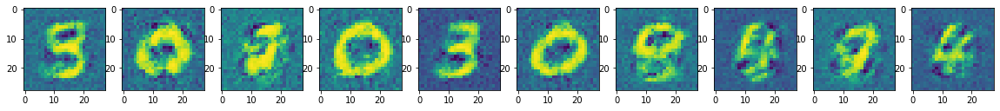


mean epoch 156 generator/discriminator loss: [638.37426147  11.28070833]



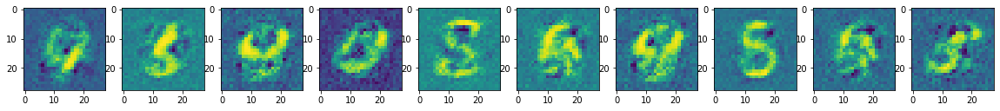

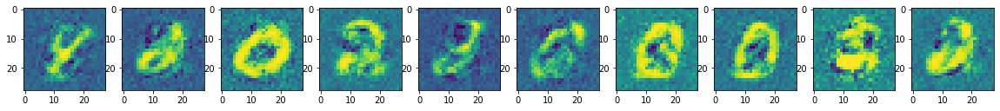

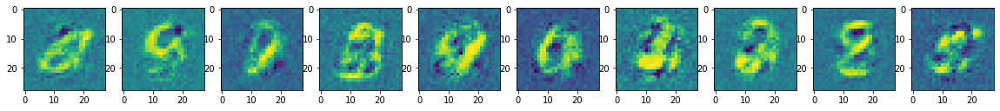


mean epoch 157 generator/discriminator loss: [681.21443604  12.23500891]



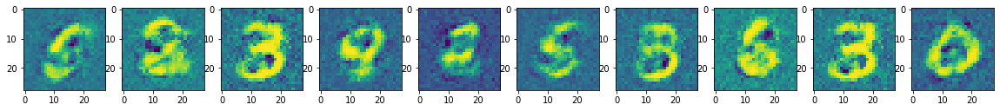

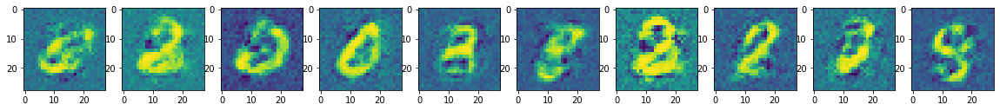

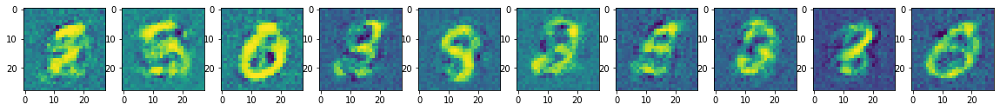


mean epoch 158 generator/discriminator loss: [657.41898743  11.24860466]



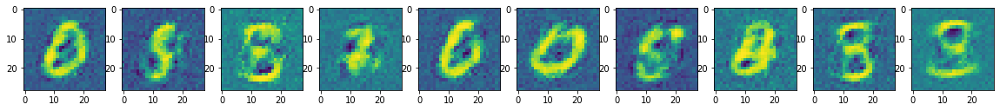

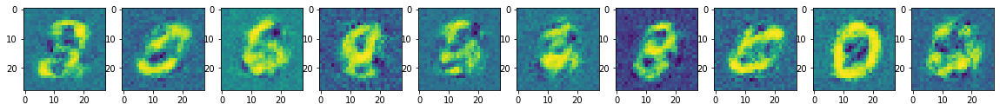

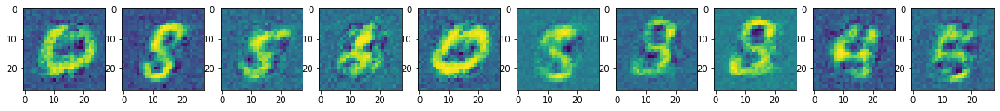


mean epoch 159 generator/discriminator loss: [672.16359985  10.33792145]



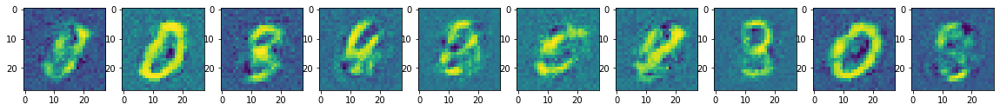

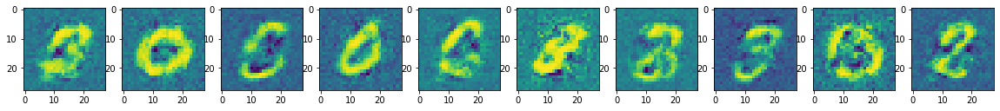

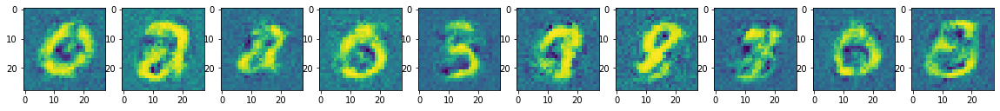


mean epoch 160 generator/discriminator loss: [640.66688721  10.83716645]



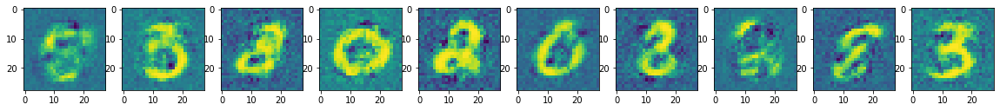

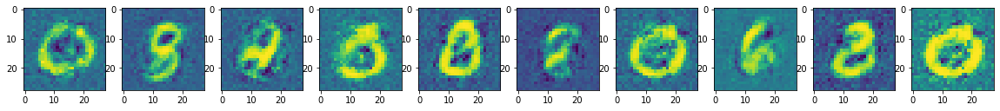

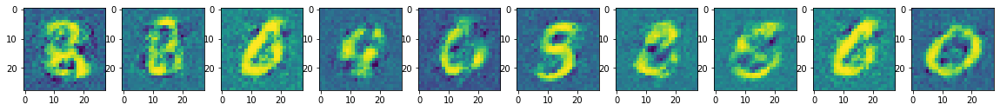


mean epoch 161 generator/discriminator loss: [684.41068298  10.70325896]



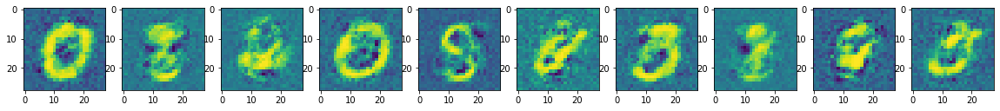

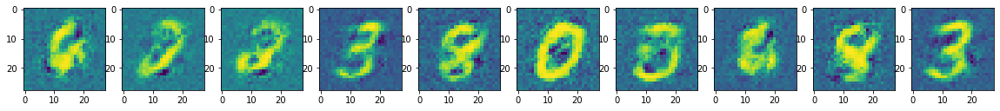

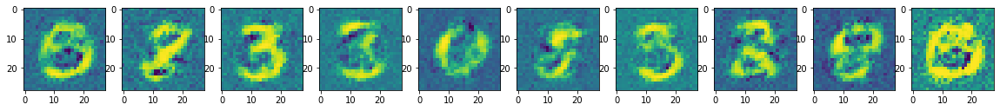


mean epoch 162 generator/discriminator loss: [668.95319092   8.68529671]



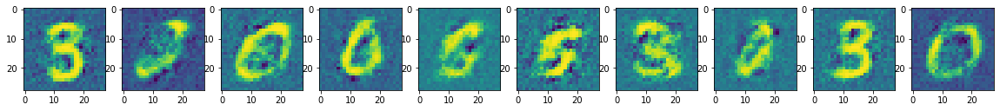

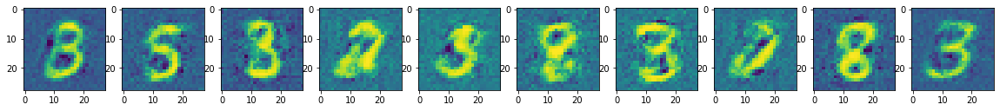

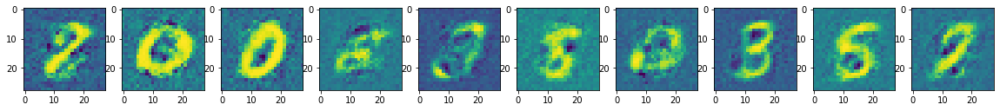


mean epoch 163 generator/discriminator loss: [682.7511969   11.42111073]



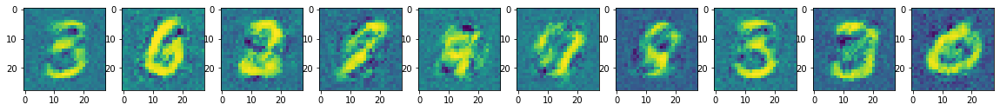

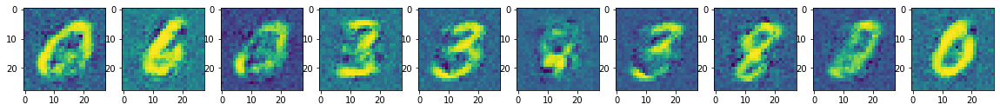

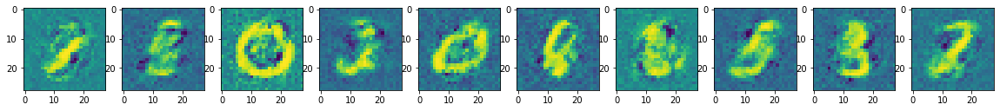


mean epoch 164 generator/discriminator loss: [676.50087189  10.64468911]



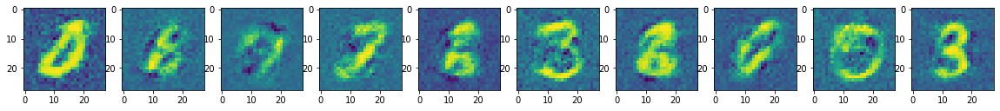

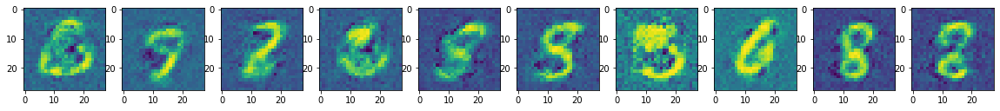

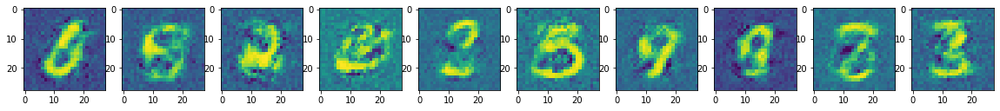


mean epoch 165 generator/discriminator loss: [655.47950287  10.5280264 ]



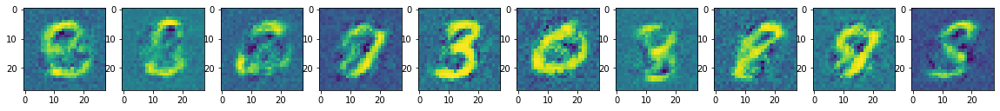

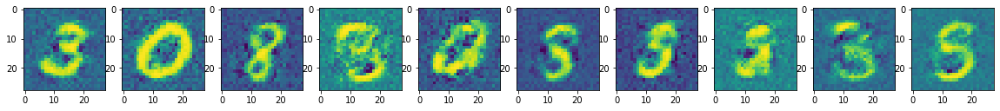

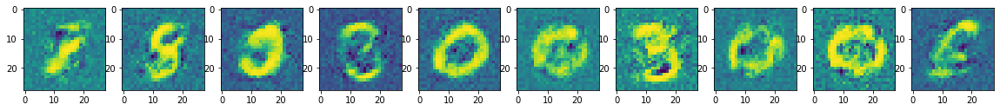


mean epoch 166 generator/discriminator loss: [654.95755798  11.6896728 ]



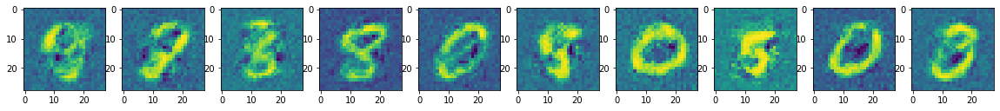

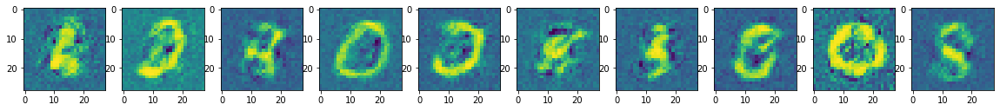

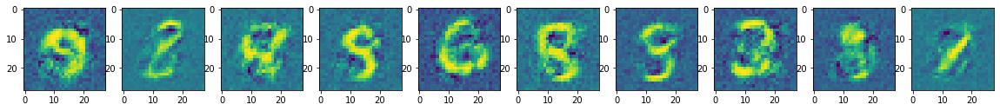


mean epoch 167 generator/discriminator loss: [659.63396606  11.90401317]



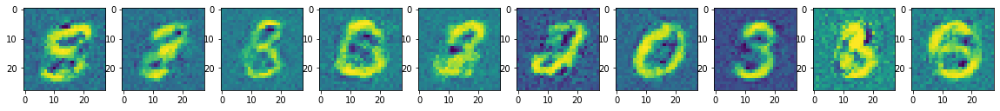

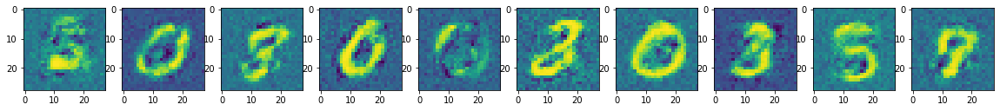

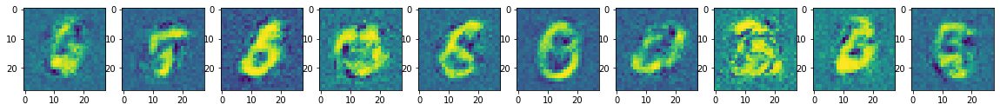


mean epoch 168 generator/discriminator loss: [686.09085938  11.46040619]



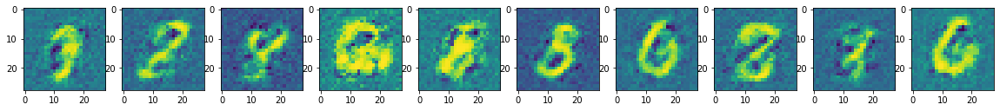

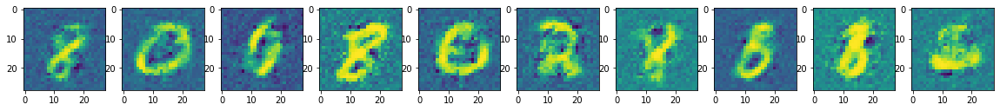

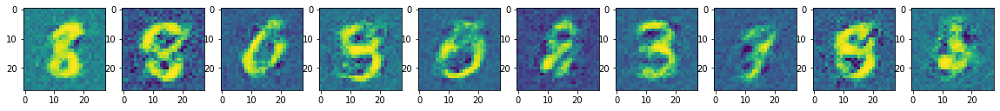


mean epoch 169 generator/discriminator loss: [682.67250977  11.3863827 ]



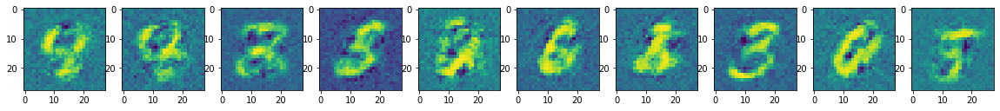

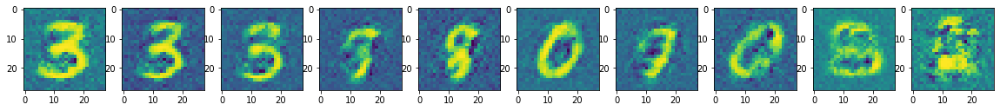

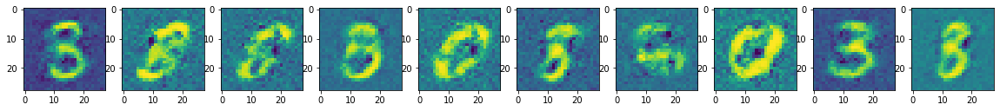


mean epoch 170 generator/discriminator loss: [691.71544312  11.086519  ]



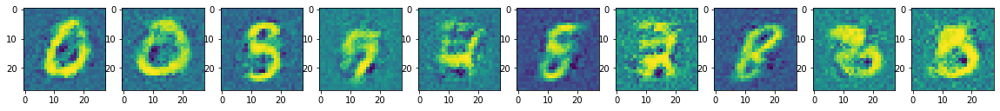

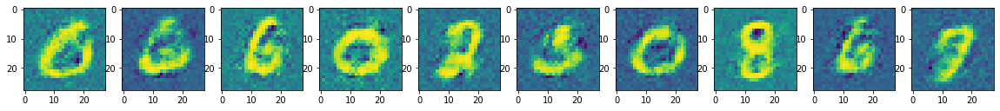

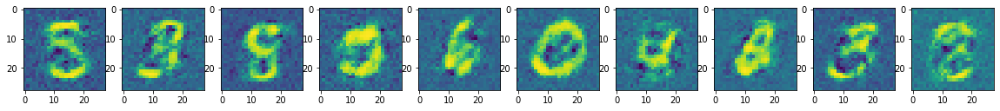


mean epoch 171 generator/discriminator loss: [682.05091492  10.8651637 ]



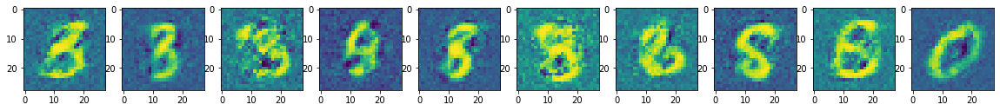

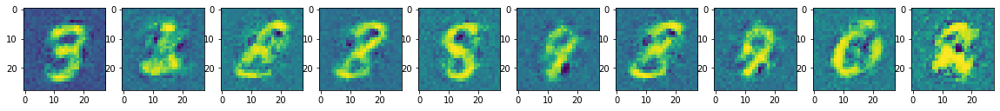

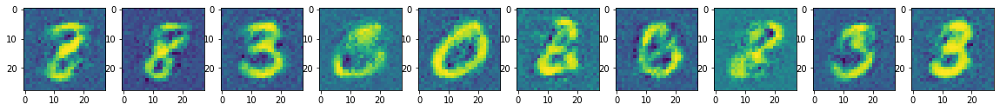


mean epoch 172 generator/discriminator loss: [680.60941528  10.84141205]



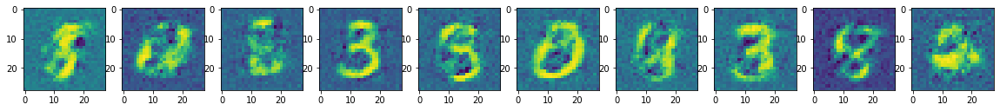

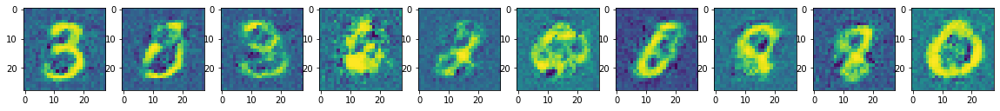

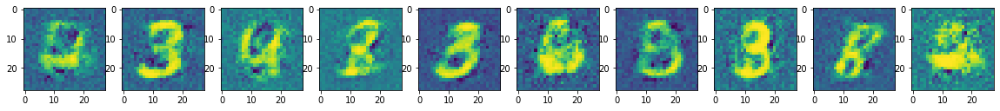


mean epoch 173 generator/discriminator loss: [692.00816528  11.576691  ]



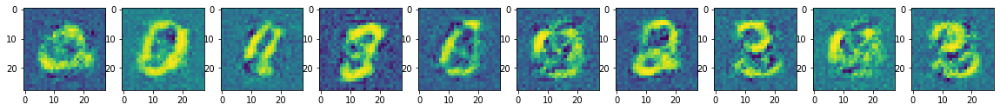

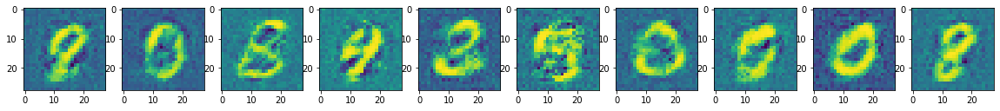

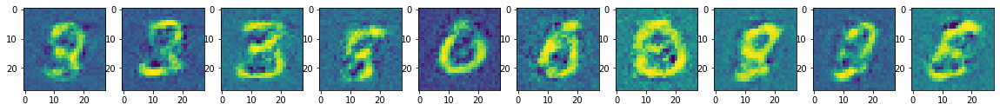


mean epoch 174 generator/discriminator loss: [660.13240021  11.26098474]



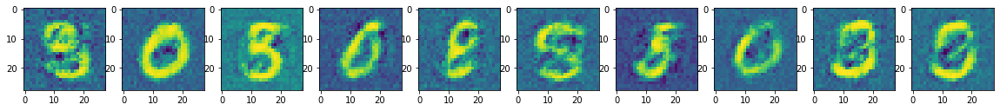

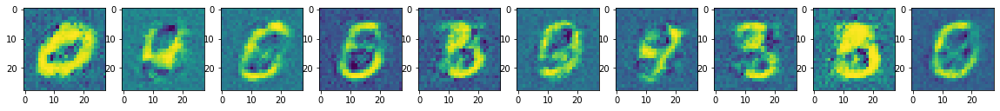

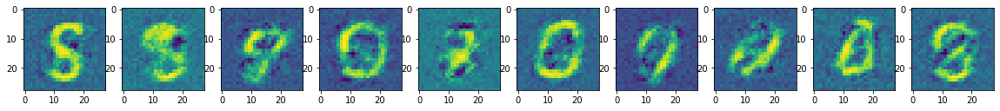


mean epoch 175 generator/discriminator loss: [686.01436462  10.17043619]



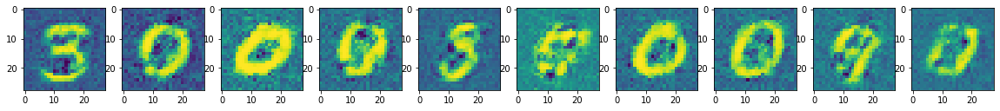

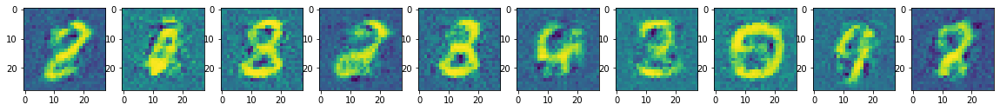

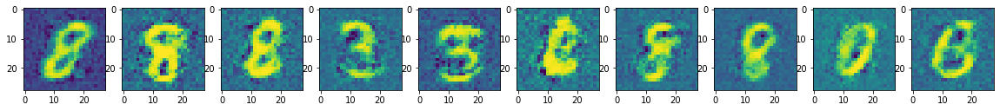


mean epoch 176 generator/discriminator loss: [680.08920349   9.76255614]



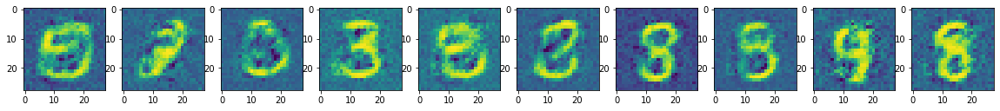

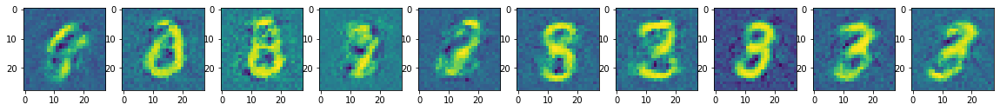

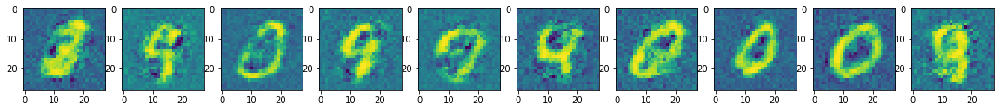


mean epoch 177 generator/discriminator loss: [683.36308105  10.11216385]



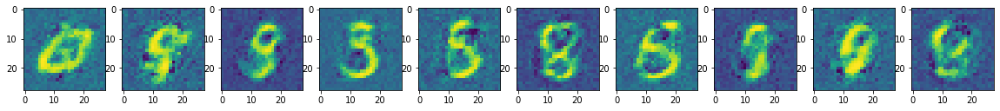

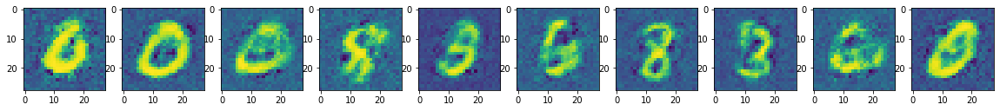

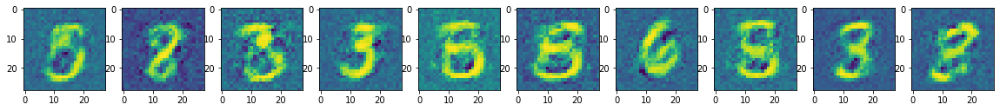


mean epoch 178 generator/discriminator loss: [691.58262817   9.50782045]



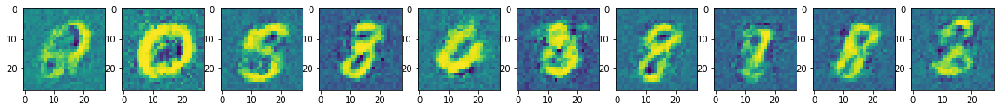

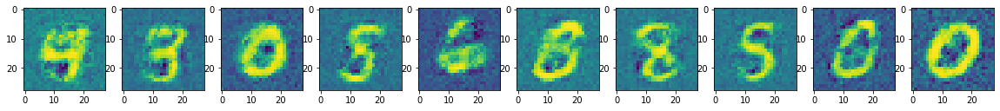

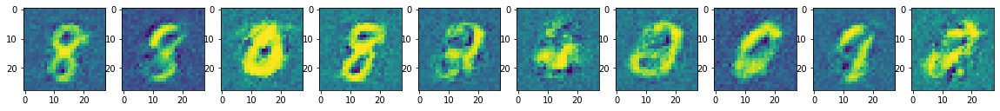


mean epoch 179 generator/discriminator loss: [677.0947702   10.81540549]



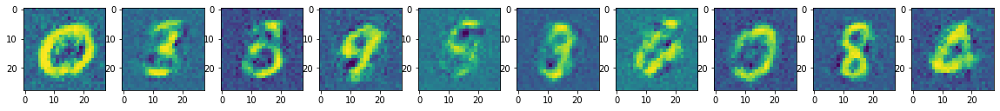

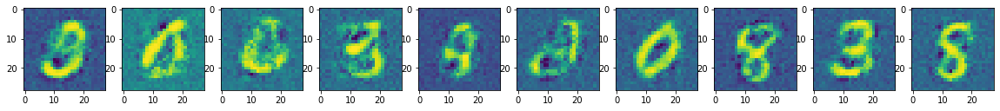

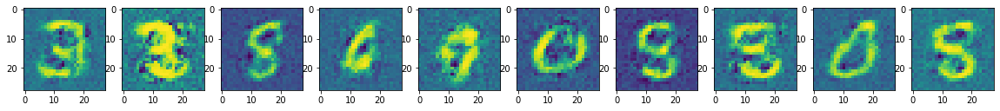


mean epoch 180 generator/discriminator loss: [679.22712891   9.15868372]



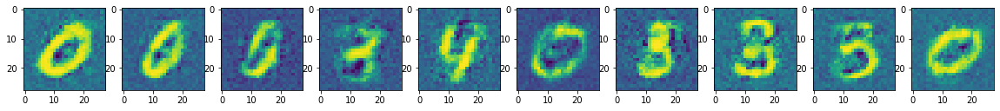

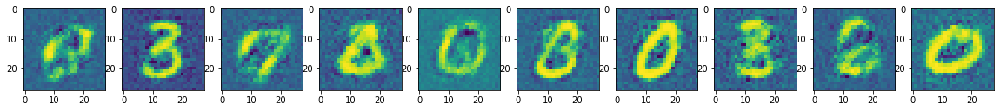

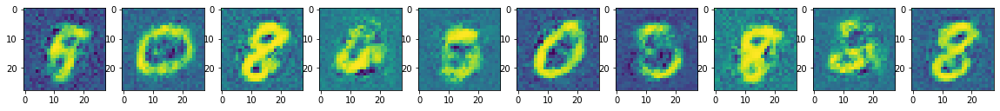


mean epoch 181 generator/discriminator loss: [708.96525757  10.23361534]



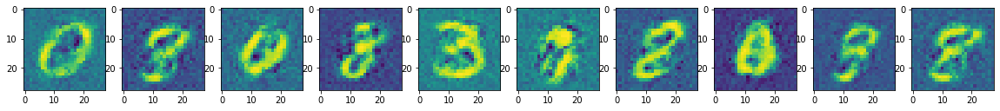

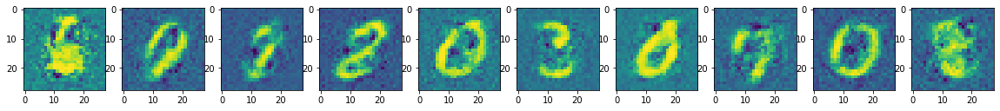

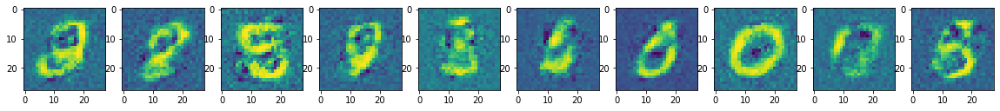


mean epoch 182 generator/discriminator loss: [680.54363159  10.31451749]



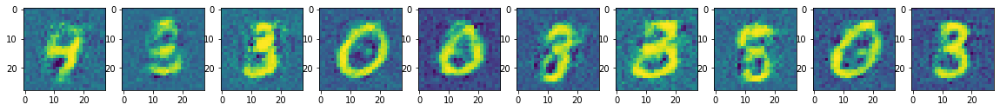

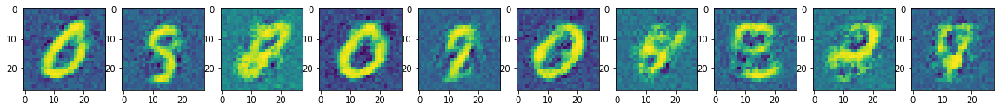

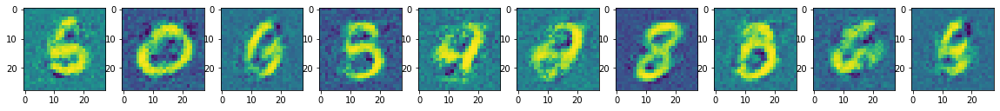


mean epoch 183 generator/discriminator loss: [713.11494019  10.57369982]



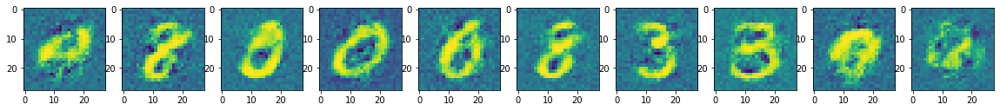

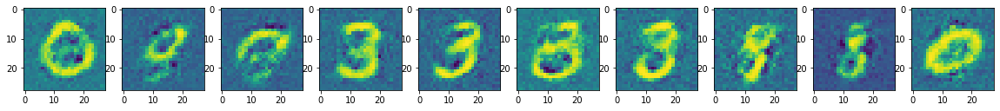

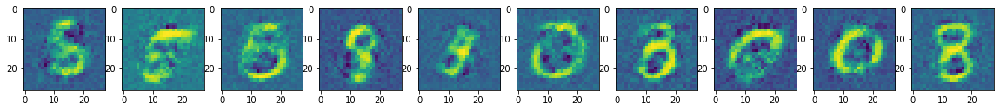


mean epoch 184 generator/discriminator loss: [674.83113098  11.22871987]



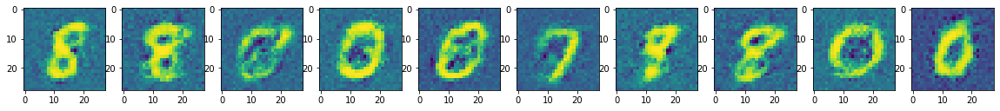

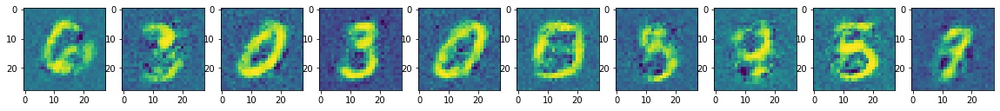

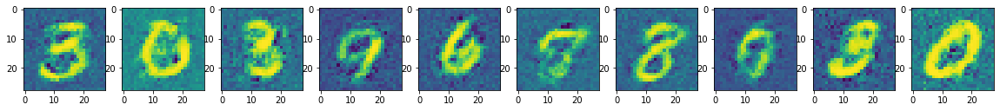


mean epoch 185 generator/discriminator loss: [672.85004333   9.94082781]



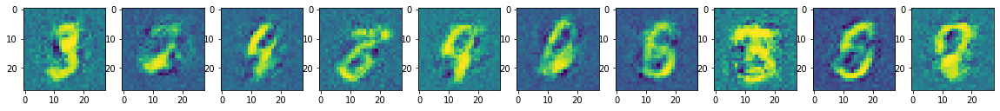

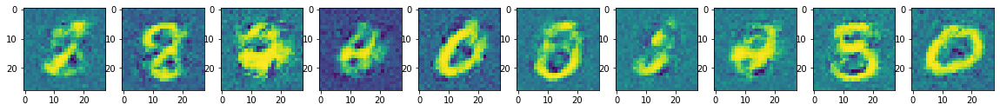

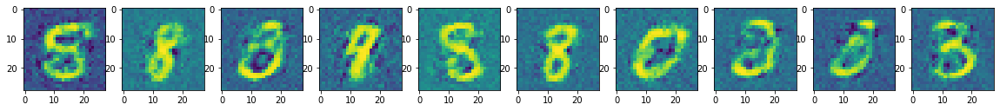


mean epoch 186 generator/discriminator loss: [665.24756409  10.19556881]



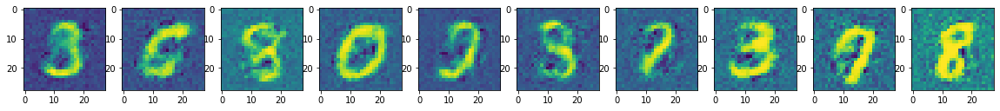

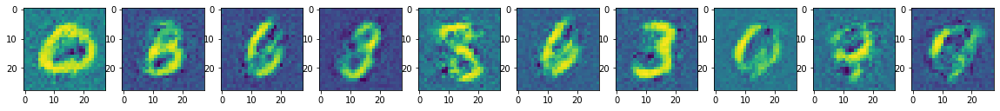

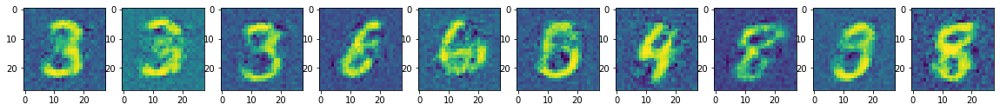


mean epoch 187 generator/discriminator loss: [674.38156433  10.10030866]



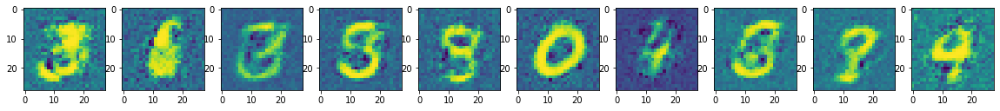

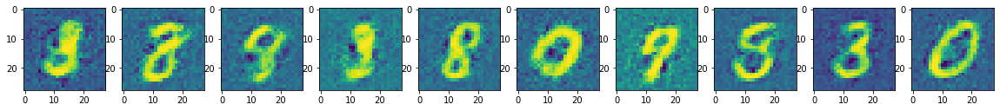

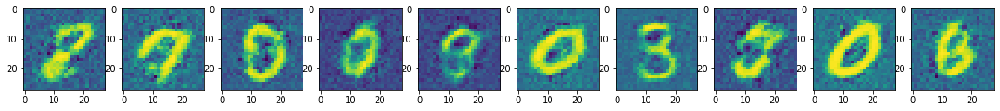


mean epoch 188 generator/discriminator loss: [714.587677    10.56010541]



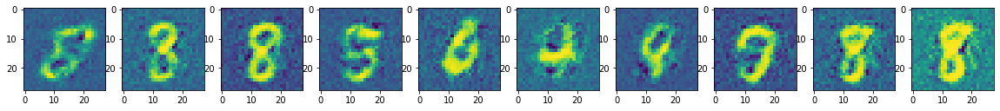

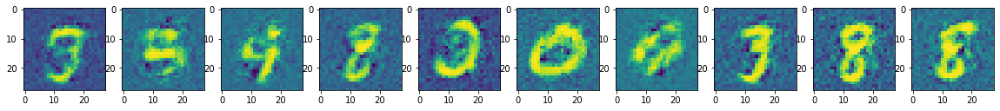

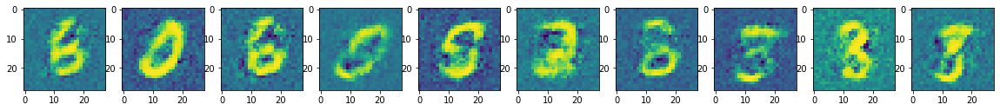


mean epoch 189 generator/discriminator loss: [663.85961975   9.81652684]



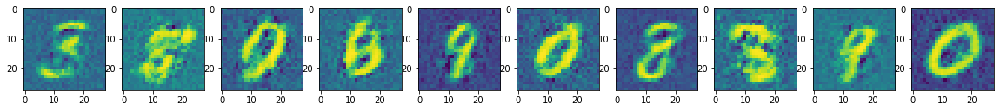

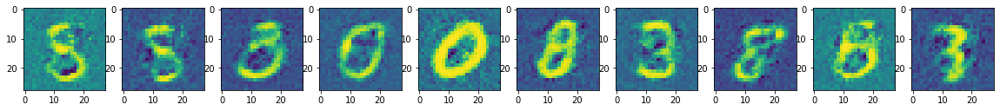

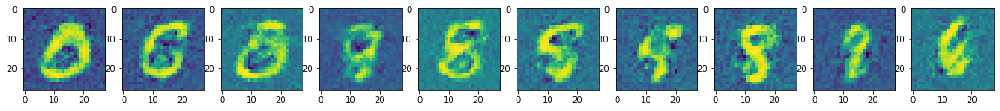


mean epoch 190 generator/discriminator loss: [706.11306122  11.19449028]



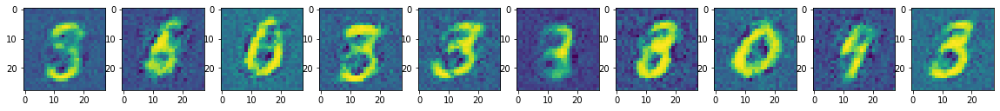

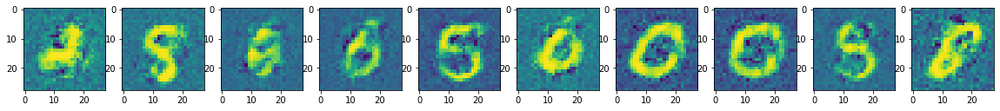

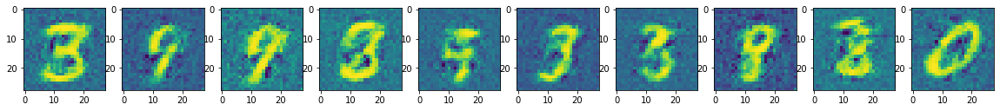


mean epoch 191 generator/discriminator loss: [692.66939148  10.42562667]



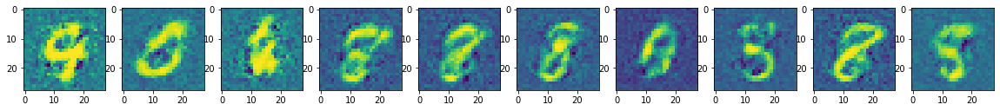

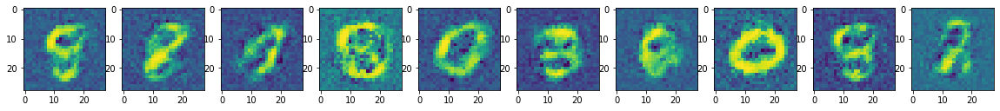

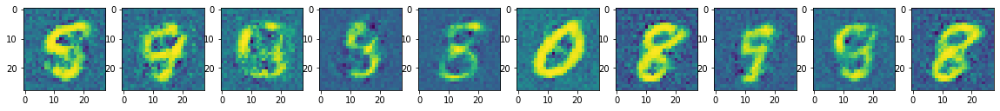


mean epoch 192 generator/discriminator loss: [700.39341919  11.24159765]



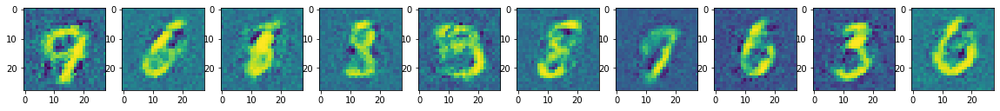

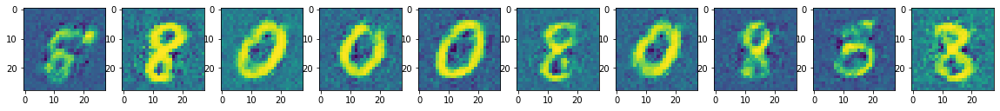

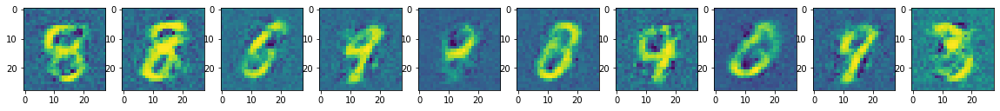


mean epoch 193 generator/discriminator loss: [691.36341431   9.57376927]



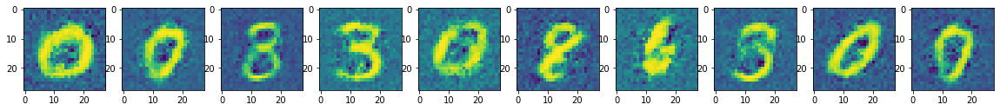

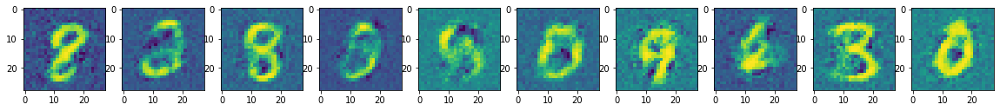

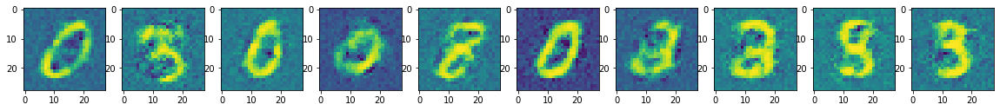


mean epoch 194 generator/discriminator loss: [679.3558667   11.14092554]



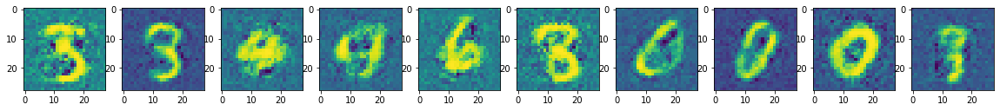

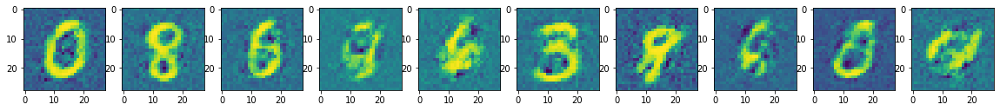

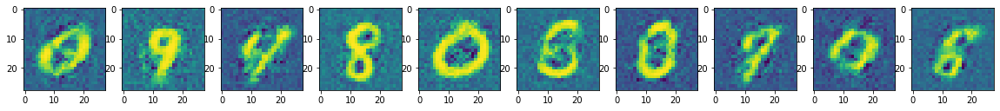


mean epoch 195 generator/discriminator loss: [648.50534576  10.45660827]



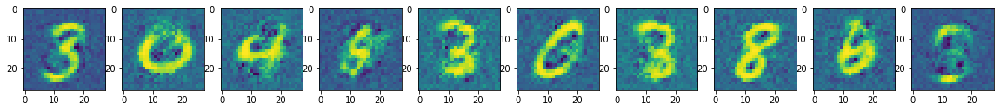

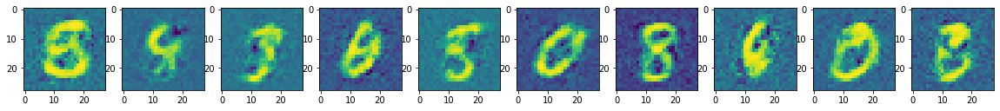

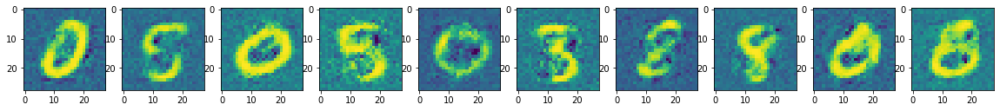


mean epoch 196 generator/discriminator loss: [690.8247583   10.59008357]



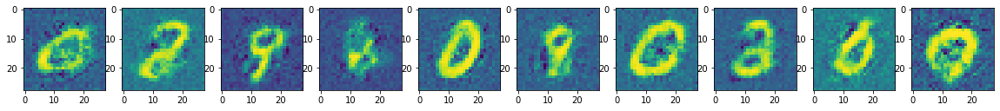

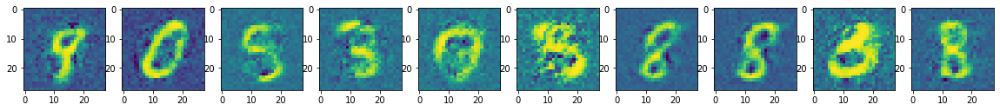

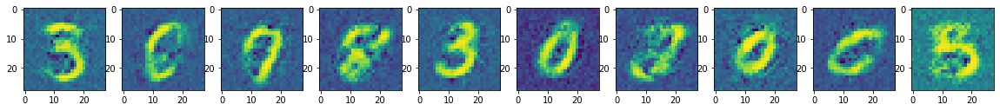


mean epoch 197 generator/discriminator loss: [664.29823608  11.37828074]



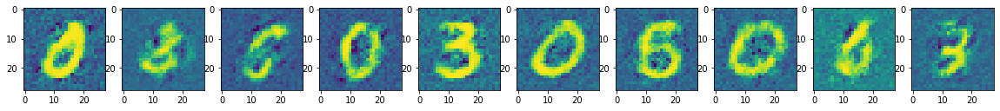

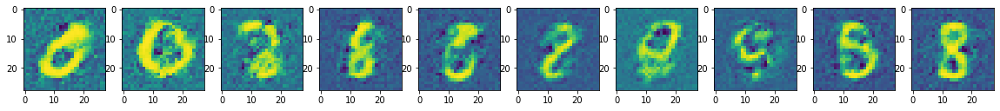

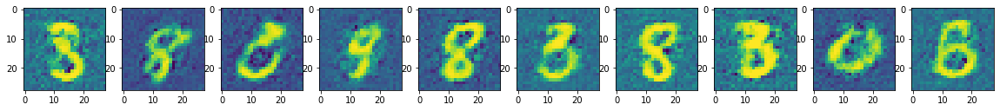


mean epoch 198 generator/discriminator loss: [709.84485046  10.12938729]



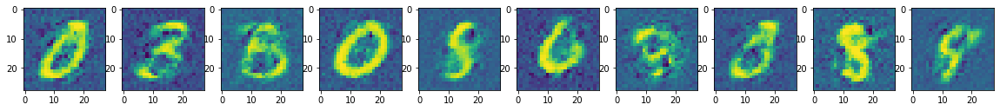

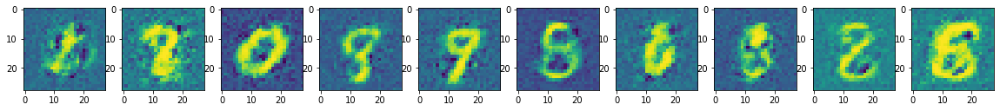

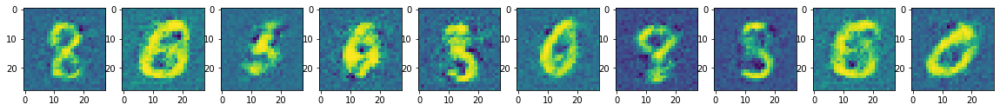


mean epoch 199 generator/discriminator loss: [674.28561462  10.3830207 ]




In [17]:
train_start_time = time.time()

val_dir = "val/"
try:
    os.makedirs(val_dir)
except FileExistsError:
    pass
train_state_dir = "net_states/"
try:
    os.makedirs(train_state_dir)
except FileExistsError:
    pass

epoch = 0
val_i = 0

for epoch in tqdm(range(epochs)):
    
    batch_nr = 0
    epoch_loss = []
    
    """Actual training step"""
    
    for train_mini_batch in tqdm(train_loader):
        
        #net.zero_grad()
        discriminator.zero_grad()
        generator.zero_grad()
        
        real_data = train_mini_batch[0].to(device).float()
        
        #discriminator_loss = d_train(discriminator, generator, discriminator_optimizer, real_data)
        #discriminator_loss = utils.d_train(discriminator, generator, loss_func, discriminator_optimizer, real_data, device)
        discriminator_loss = d_train(discriminator, generator, loss_func, discriminator_optimizer, real_data, device)
        
        #generator_loss, g_output = g_train(discriminator, generator, generator_optimizer)
        #generator_loss, g_output = utils.g_train(discriminator, generator, loss_func, generator_optimizer, device)
        generator_loss, g_output = g_train(discriminator, generator, loss_func, generator_optimizer, device)
        
        num_images = 10
        num_batches = 3
        if batch_nr < num_batches:
            num_images = 10

            images = g_output.detach().cpu().numpy()[0:num_images]
            images = images.reshape([num_images,28,28])

            fig, ax=plt.subplots(1,num_images)

            for i in range(num_images):
                ax[i].imshow(images[i])
            plt.show(fig)
            
        epoch_loss.append([generator_loss, discriminator_loss])
        

        batch_nr += 1
    
    mean_epoch_loss = np.nanmean(np.array(epoch_loss), axis=0)
    #train_loss[epoch] = mean_epoch_loss
    train_loss.append(mean_epoch_loss)
    print(f"mean epoch {epoch} generator/discriminator loss: {mean_epoch_loss}\n")
    
    
    """save the neural networks state"""
    if epoch in save_state_epochs:
        train_state_epoch_file_path = train_state_dir + f"state_epoch_{epoch}"
        #train_state = {"epoch" : epoch, "state_dict": net.state_dict(), "optimizer": optimizer.state_dict()}
        #torch.save(train_state, train_state_epoch_file_path)
        torch.save(net.state_dict(), train_state_epoch_file_path)
        net_state_paths.append(train_state_epoch_file_path)
        print(f"saved model from epoch {epoch}")
        
    
log_file.close()
train_end_time = time.time()

In [18]:
print(f"training time: {train_end_time-train_start_time}s")

training time: 1129.6245925426483s


In [19]:
"""train_state_file_path = train_state_dir + f"state_epoch_{epoch}"
#train_state = {"epoch" : epoch, "state_dict": net.state_dict(), "optimizer": optimizer.state_dict()}
torch.save(net.state_dict(), train_state_file_path)
net_state_paths.append(train_state_epoch_file_path)
print(f"saved model from epoch {epoch}")"""

'train_state_file_path = train_state_dir + f"state_epoch_{epoch}"\n#train_state = {"epoch" : epoch, "state_dict": net.state_dict(), "optimizer": optimizer.state_dict()}\ntorch.save(net.state_dict(), train_state_file_path)\nnet_state_paths.append(train_state_epoch_file_path)\nprint(f"saved model from epoch {epoch}")'

In [20]:
"""
net_state_path = "net_states/state_epoch_30"
net.load_state_dict(torch.load(net_state_path))
#net.eval()
"""

'\nnet_state_path = "net_states/state_epoch_30"\nnet.load_state_dict(torch.load(net_state_path))\n#net.eval()\n'

[1.0388964  0.82602584 0.9967496  1.1652658  1.0811445  1.0185065
 1.0110003  1.0339077  0.95420283 1.0787979 ]
torch.Size([10, 1, 28, 28])
10


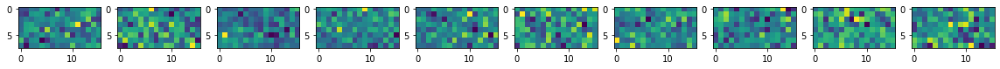

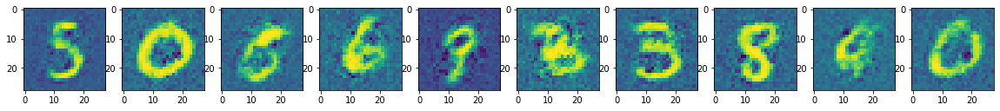

In [33]:
random_seed = 0
torch.manual_seed(random_seed)
num_samples = 10
latent_dist = torch.distributions.normal.Normal(**std_no_kwargs)
sample_noise = latent_dist.sample((num_samples, latent_size,)).to(device)
#sample_noise = torch.randn((num_samples, latent_size,)).to(device)

sample_noise_numpy = sample_noise.detach().cpu().numpy()
print(sample_noise_numpy.std(axis=1))

fig, ax = plt.subplots(1,num_samples)
for i in range(num_samples):
    ax[i].imshow(sample_noise_numpy.reshape([-1,8,16])[i])

#print(sample_noise.shape)
#print(sample_noise)

output = generator(sample_noise)
output_numpy = output.detach().cpu().numpy()
#print(output_numpy.std(axis=0))

print(output.size())
print(len(output))
fig, ax = plt.subplots(1,num_samples)
for i in range(num_samples):
    ax[i].imshow(output.detach().cpu()[i][0])